###Mount Google Drive
Mount Google Drive - where all nuScenes data and resulting run data will be strored

In [ ]:
#Need to mount my Google Drive
from google.colab import drive
drive.mount("/content/gdrive/")

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


Set environment variable for path to nuScenes dataset

In [ ]:
%cd /content/gdrive/MyDrive/MScDissertation
import os
cwd = os.getcwd()
print("cwd:",cwd)
dataroot=os.path.join(cwd,'data/sets/nuscenes') #needed to remove / before data to make it work - now we should be able to access the singapore-onenorth file
print("dataroot (after joining)",dataroot)



# Add a new environment variable for the nuScenes path
os.environ['NUSCENES'] = dataroot

print("NUSCENES:", os.environ['NUSCENES'])

/content/gdrive/MyDrive/MScDissertation
cwd: /content/gdrive/MyDrive/MScDissertation
dataroot (after joining) /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes
NUSCENES: /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes


###Clone and pull code from Github repository

All code for this project is strored at [the following Github link](https://github.com/aokane001/Dissertation-repo). Clone this repository, pull in recent changes and change to the "src" directory which is the main sub-folder for code

In [ ]:
!git clone https://github.com/aokane001/Dissertation-repo

fatal: destination path 'Dissertation-repo' already exists and is not an empty directory.


In [ ]:
#NB Need to actuall change directory forst before pulling
%cd Dissertation-repo/
!git pull
#then switch to src - this is where most of the files we will want to run are
%cd src/

/content/gdrive/MyDrive/MScDissertation/Dissertation-repo
Already up to date.
/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src


###Import necessary packages

Import all python packages needed for this project, in particular nuScenes-devkit and efficientnet. Warnings can be ignored. Some minor errors related to matplotlib versions can be resolved by restarting the runtime and running all cells again.

In [ ]:
#pip installing all the other stuff we will need - that will be called by other files
!python3 -m pip install --upgrade pip
!pip install efficientnet_pytorch==0.7.0
!pip install torchvision torch tensorboardX
!pip install pyquaternion
import functools
!python3 -m pip install --upgrade Pillow
!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.
#NB mpl_toolkits is not on PyPi so not installable by pip
#Since I have matplotlib already installed simply use the following command
import matplotlib
import mpl_toolkits
#NB Was getting several ShapelyDeprecation warnings - this is to help ignore them for now
import shapely
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)

###Set parameters for TF Grid baseline

Set parameters here ine one place, so they can then be referenced below in all relevant function calls

In [ ]:
#With TF Grid this is set as part of the config file - then when running the actual train file it is
#run by firing the main.py file which runs the train.py file and we specify the arguments to pass and point to the config file where the train label is set
#so it never actually gets explicitly passed in the train.py (on which we based train() below) - so I think that's why we need to set it explicitly here
train_label = 'lane_divider' #'walkway' #'vehicle'    #'drivable_area'

#Want to set the logdir here - this is what will actually be passed when we call the function below and pass logdir-logdir
#but in the function definition set the default to just be "./runs"
logdir='./runs'

version = "mini"
dataroot = os.environ["NUSCENES"]
#Use 60 epochs for full runs - as per TF Grid
nepochs = 60
#since only one GPU is available in Colab and we start counting from 0
gpuid = 0

#params related to data_aug_conf - i.e. related to data augmentation of camera images
H=900
W=1600
resize_lim=(0.193, 0.225)
final_dim=(128, 352)
bot_pct_lim=(0.0, 0.22)
rot_lim=(-5.4, 5.4)
rand_flip=True
ncams=5
max_grad_norm=5.0
pos_weight=2.13

#params related to grid_conf - i.e. grid configuration of final semantic grid - want this to be 200 x 200 cells i.e. -50m to 50m range in 0.5m intervals
xbound=[-64.0, 64.0, 0.5]
ybound=[-64.0, 64.0, 0.5]
zbound=[-10.0, 10.0, 20.0]
dbound=[4.0, 45.0,1.0] #this is D in literature of Lift Splat Shoot - range of distances

#params related to training function
bsz=2 #batch size
nworkers=2

lr = 1e-3 #learning rate
weight_decay = 1e-7 #weight_decay for L2 regularisation
num_classes = 1 #ultimately only training for 1 class at a time

#params related to PointPillars backbone
num_points = 100000
#NB - AS WE ARE training BASED ON MINI - PASS 34718 WHEN CALLING TRAIN
# trainval avg 34720  , mini avg 34718
n_points=34718

#As per TFGrid config files this was left as is - defined based on xbound, ybound so that grid sizes match up and allow for concatenation
#Comment and let this be passed wheb defining grid_conf
#pc_range= [xbound[0],ybound[0],-4,xbound[1],ybound[1],4]
#voxel_size = [xbound[2],ybound[2],8]

max_points_voxel = 100 #this is N in TF Grid literature
max_voxels = 10000 #this is P in TF Grid literature
input_features= 4 #four initial inputs - supplemented to get up to 9-dimensional within PointPillars block
use_norm = True #we do want to use BatchNorm
vfe_filters = [64] #this is effectively C=64 for PointPillars - controls number of channels
with_distance = False

#below for tf_config
n_head = 4
block_exp = 4
n_layer = 8
vert_anchors = 8
horz_anchors = 8
seq_len = 1
embd_pdrop = 0.1
resid_pdrop = 0.1
attn_pdrop = 0.1
n_views=1

#Will need to pass this as the place to store data for visualisations
img_save_dir = './runs/viz_model_preds/' #need '/' here so that file path is saved correctly when passing to savefig in viz_model_preds() below

#for lidar_check() below
show_lidar=True #want to see lidar scans
viz_train=False #set this to True to see data augmentation and visualise train data rather than val data

#for viz_model_preds below - or visualisation
map_folder = os.environ["NUSCENES"]

###Define train() function

In [ ]:
#import necessary packages and code from other scripts in Github repo
#the following command effectively mirrors the train.py script from TF Grid repo
import torch
import torch.nn.functional as F
from time import time
from tensorboardX import SummaryWriter
import numpy as np
import os

from models_TFGrid_2T import compile_model #this is the script for the 2T version of TF Grid

from data import compile_data
from tools import SimpleLoss, get_batch_iou, get_val_info,points_to_voxel_loop

#Define train() function
def train(
  train_label = train_label, #In TFGrid this isn't in the definition of train but really it is needed for compile_data that is called as part of it
                             #so it should be passed - in reality it seems the Fire part of main.py that calls the config file gets it from there - but it should be here
  version = version,
  dataroot = dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid,

  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_classes = num_classes,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features= input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance,

  n_head = n_head,
  block_exp = block_exp,
  n_layer = n_layer,
  vert_anchors = vert_anchors,
  horz_anchors = horz_anchors,
  seq_len = seq_len,
  embd_pdrop = embd_pdrop,
  resid_pdrop = resid_pdrop,
  attn_pdrop = attn_pdrop,
  n_views= n_views
  ):

  #The following dicts are then defined based on passed params
  grid_conf = {
    'xbound': xbound,
    'ybound': ybound,
    'zbound': zbound,
    'dbound': dbound,
  }

  data_aug_conf = {
    'resize_lim': resize_lim,
    'final_dim': final_dim,
    'rot_lim': rot_lim,
    'H': H, 'W': W,
    'rand_flip': rand_flip,
    'bot_pct_lim': bot_pct_lim,
    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT','CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
    'Ncams': ncams,
  }

  cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4], #NB-define this based on xbound, ybound so grid sizes will match
    'voxel_size' : [xbound[2],ybound[2],8], #NB-define this based on xbound, ybound so grid sizes will match
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

  tf_config = {
    'n_head':n_head,
    'block_exp':block_exp,
    'n_layer':n_layer,
    'vert_anchors':vert_anchors,
    'horz_anchors':horz_anchors,
    'seq_len':seq_len,
    'embd_pdrop':embd_pdrop,
    'resid_pdrop':resid_pdrop,
    'attn_pdrop':attn_pdrop,
    'n_views':n_views

  }

  print('Loading data ...')
  #Had to change the way this is called slightly - it is strange, in train.py in TFGrid - it passes n_points and pc_range explicitly but this isn't how it is defined in models.py
  trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata',cfg_pp=cfg_pp, train_label=train_label) #other paraemeter - cond, dist, rank, sw can be left as default

  device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
  print('Compiling model ...')
  model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp, tf_config = tf_config) ### outC number of output channels
  model.to(device)
  opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
  loss_fn = SimpleLoss(pos_weight).cuda(gpuid)
  writer = SummaryWriter(logdir=logdir)
  val_step = 500 if version == 'mini' else 5000
  model.train()
  counter = 0
  print('Starting training ...')
  for epoch in range(nepochs):
      print(f"Epoch: {epoch+1}/{nepochs}") #NOTE - ACTUAL VALUE OF epoch WILL START COUNTING FROM 0 - THIS IS JUST FOR CONVENIENCE OF READING OUTPUT TO START FROM 1
      np.random.seed()
      for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(trainloader):
          t0 = time()
          opt.zero_grad()
          voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)
          preds = model(imgs.to(device),
                  rots.to(device),
                  trans.to(device),
                  intrins.to(device),
                  post_rots.to(device),
                  post_trans.to(device),
                  voxels.to(device),
                  coors.to(device),
                  num_points.to(device),
                  )

          binimgs = binimgs.to(device)
          loss = loss_fn(preds, binimgs)
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
          opt.step()
          counter += 1
          t1 = time()
          if counter % 10 == 0:
              print(counter, loss.item())
              writer.add_scalar('train/loss', loss, counter)
          if counter % 50 == 0:
              intersection, union, iou = get_batch_iou(preds, binimgs)
              writer.add_scalar('train/iou', iou, counter)
              writer.add_scalar('train/epoch', epoch, counter)
              writer.add_scalar('train/step_time', t1 - t0, counter)
          if counter % val_step == 0:
              val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp=cfg_pp,grid_conf=grid_conf, use_tqdm= True)
              print('VAL', val_info)
              writer.add_scalar('val/loss', val_info['loss'], counter)
              writer.add_scalar('val/iou', val_info['iou'], counter)
          if counter % val_step == 0:
              model.eval()
              mname = os.path.join(logdir, "model{}.pt".format(counter)) #NB This is the location-same runs/ directory where summary will be saved
                                                                         #where the model will also be saved every val_step=500 number of training steps
              print('saving ... ', mname)
              torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': opt.state_dict(),
              'loss': loss,
              'counter':counter
              }, mname)
              model.train()


###Now we want to actually call train() to commence training

Loading data ...
Getting all samples
Getting all samples
Compiling model ...
Within LPT class, create_frustum function- size of frustum (one per cam - expect D.H.W.3) is:<built-in method size of Tensor object at 0x7d7ef0e075b0>
Within CamEncode - as part of Lift Splat - size of D is:41
Within CamEncode - as part of Lift Splat - size of C is:64


Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:02<00:00, 9.72MB/s]


Loaded pretrained weights for efficientnet-b0
In PointPillars Scatter - output size - which should be batch_size,C,H,W is:[1, 1, 256, 256, 64]
In init of BevEncode - number of in channels expetced for BevEncode384


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde347f10>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a9620>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a9300>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3a93f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3a93f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3aa160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3e0ef0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3e19e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e3d30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e3d30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3e0040>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3e0040>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3e3420>
In Pillar Features - spatial_features size, whic

/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src/tools.py:113: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3571.)
  ax2.imshow(ndimage.rotate(cv2.flip(np.array(binimgs[j].T),0), -90, reshape=False), vmin=0, vmax=1, cmap='Blues')


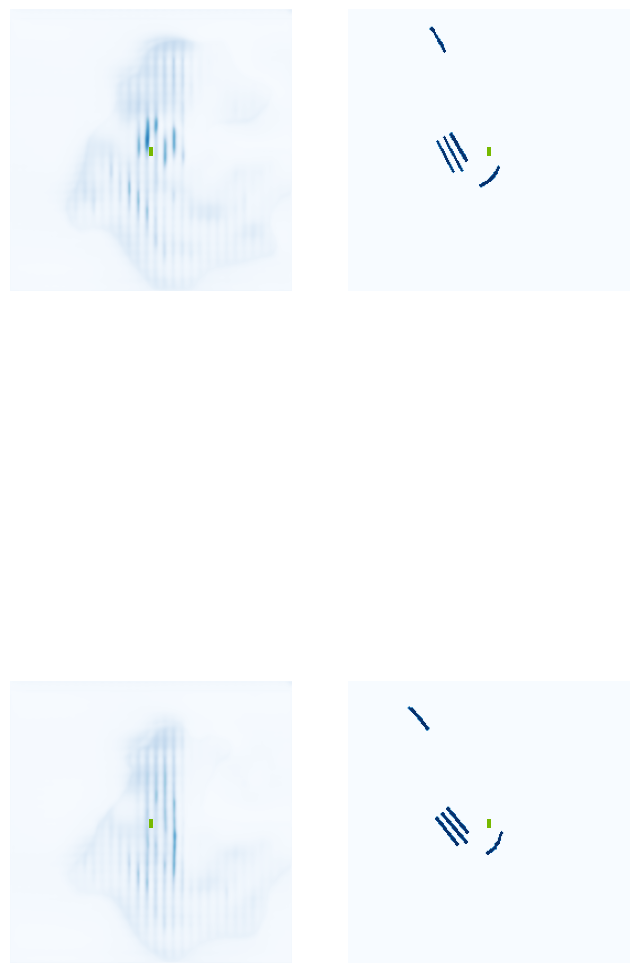

  5%|▌         | 2/40 [00:13<03:27,  5.47s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4357b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7f6890>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde362b10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde362b10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde303a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde303a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde679d

  8%|▊         | 3/40 [00:23<04:44,  7.70s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3586d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48fb00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7611c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7611c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde761e90>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde761e90>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde48fb00>
In Pillar Features - spatial_features size, whic

 10%|█         | 4/40 [00:23<02:49,  4.71s/it]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f18a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f0b30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f16c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f1cb0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde6f1cb0> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde6f16c0>
final output-fused features-of Transfuser forward pass is of size:<built-in method size of Tensor object at 0x7d7fde6f0b30>
Number of feature channels should match number of input channels to be expected for input to BEVEncode
Resulting size coming out of BEVEncode<built-in method size of Tensor object at 0x7d7fde3e1c10>
LPT forward(): call get voxels, and pointpi

 12%|█▎        | 5/40 [00:34<04:06,  7.04s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3609a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7619e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde78cc20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde78cc20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3e0900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3e0900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3a7420>
In Pillar Features - spatial_features size, whic

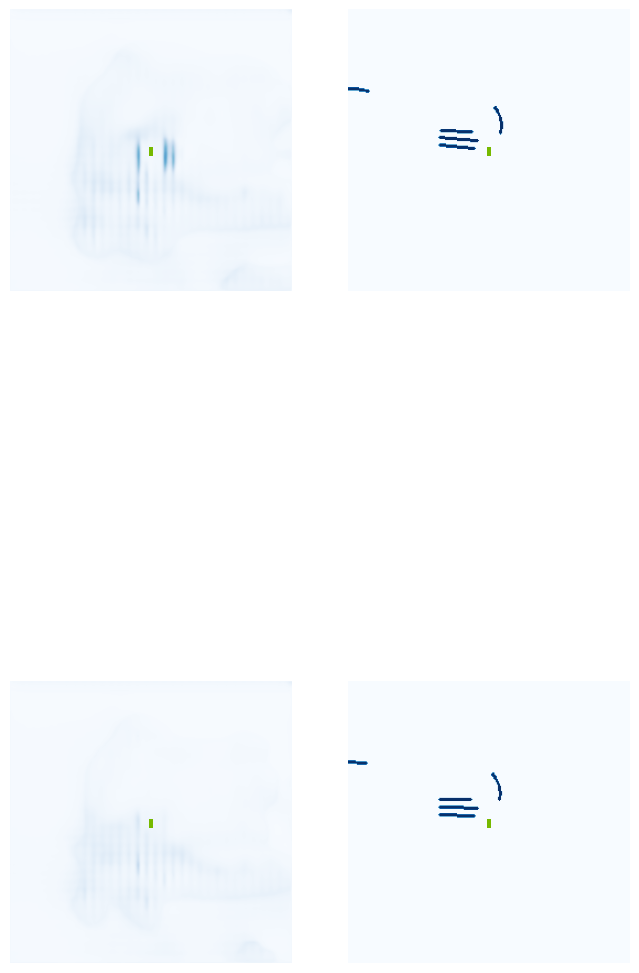

 15%|█▌        | 6/40 [00:35<02:42,  4.79s/it]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 18%|█▊        | 7/40 [00:46<03:48,  6.92s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b56890>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3e1ee0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde59af70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde59af70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde621440>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde621440>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde59aac0>
In Pillar Features - spatial_features size, whic

 22%|██▎       | 9/40 [00:58<03:35,  6.96s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde6ae250>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9e4c20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde643920>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde643920>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde6ae250>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde6ae250>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde599bc0>
In Pillar Features - spatial_features size, whic

 25%|██▌       | 10/40 [00:58<02:25,  4.85s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b32d40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3e2d90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9e5080>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9e5080>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b33b50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b33b50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde641260>
In Pillar Features - spatial_features size, whic

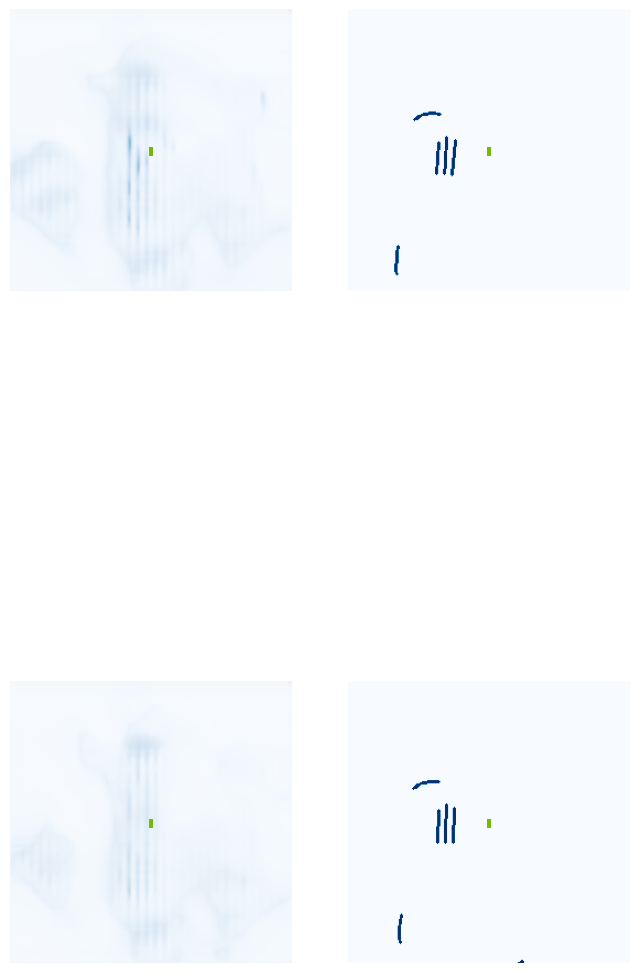

 30%|███       | 12/40 [01:10<02:19,  4.97s/it]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3e3060>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde75b6a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e1ee0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e1ee0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde48c950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde48c950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde48f

 32%|███▎      | 13/40 [01:22<03:05,  6.86s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde49b420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe0b33010>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde75b150>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde75b150>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57a020>
In Pillar Features - spatial_features size, whic

 38%|███▊      | 15/40 [01:33<02:46,  6.67s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde49a980>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde761e90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6ae250>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6ae250>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde49a980>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde49a980>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b54090>
In Pillar Features - spatial_features size, whic

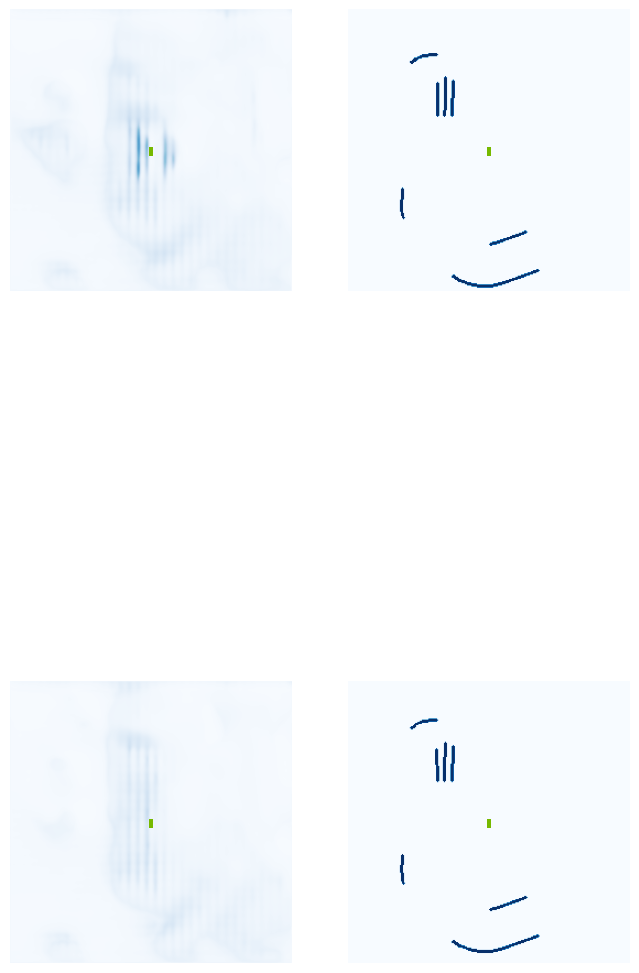

 40%|████      | 16/40 [01:33<01:55,  4.79s/it]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 42%|████▎     | 17/40 [01:44<02:28,  6.46s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde59aac0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde499f80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a532e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a532e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a43a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a43a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde866d40>
In Pillar Features - spatial_features size, whic

 48%|████▊     | 19/40 [01:54<02:12,  6.32s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a532e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde75b920>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a53f10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a53f10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4608b0>
In Pillar Features - spatial_features size, whic

 50%|█████     | 20/40 [01:54<01:29,  4.45s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde443790>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde442980>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde595300>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde595300>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde443790>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde443790>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3e2840>
In Pillar Features - spatial_features size, whic

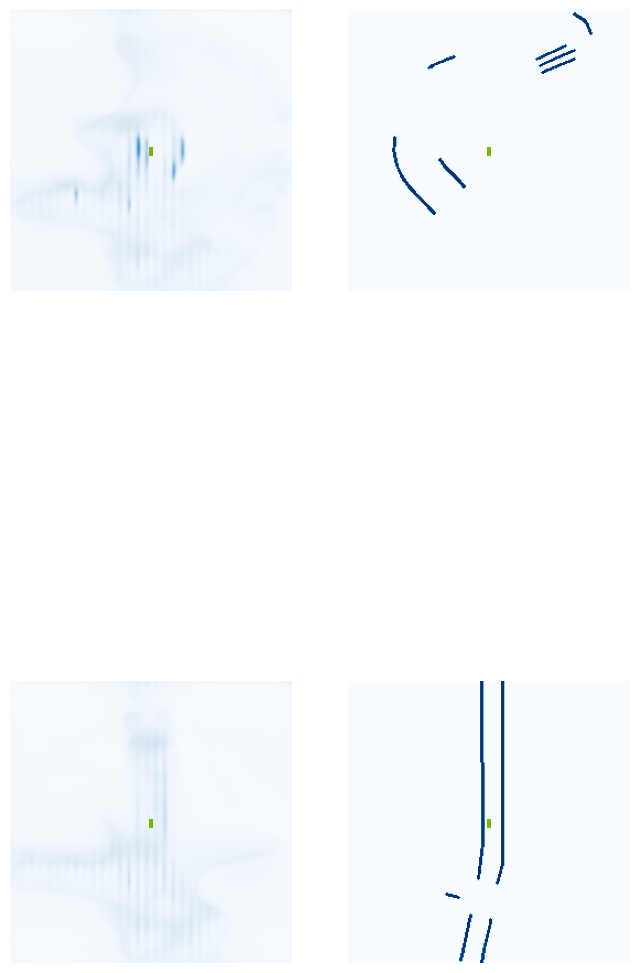

 55%|█████▌    | 22/40 [02:06<01:24,  4.67s/it]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde622610>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a8e430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a9b790>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a9b790>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4af6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde49e

 57%|█████▊    | 23/40 [02:17<01:53,  6.69s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0d16390>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde404310>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde442890>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde442890>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a676f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a676f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aa90d0>
In Pillar Features - spatial_features size, whic

 60%|██████    | 24/40 [02:17<01:15,  4.72s/it]

Resulting size coming out of BEVEncode<built-in method size of Tensor object at 0x7d7fde404310>
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde404310>


 62%|██████▎   | 25/40 [02:29<01:41,  6.78s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ac3420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ac0360>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1aeeac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1aeeac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a676f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a676f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde499800>
In Pillar Features - spatial_features size, whic

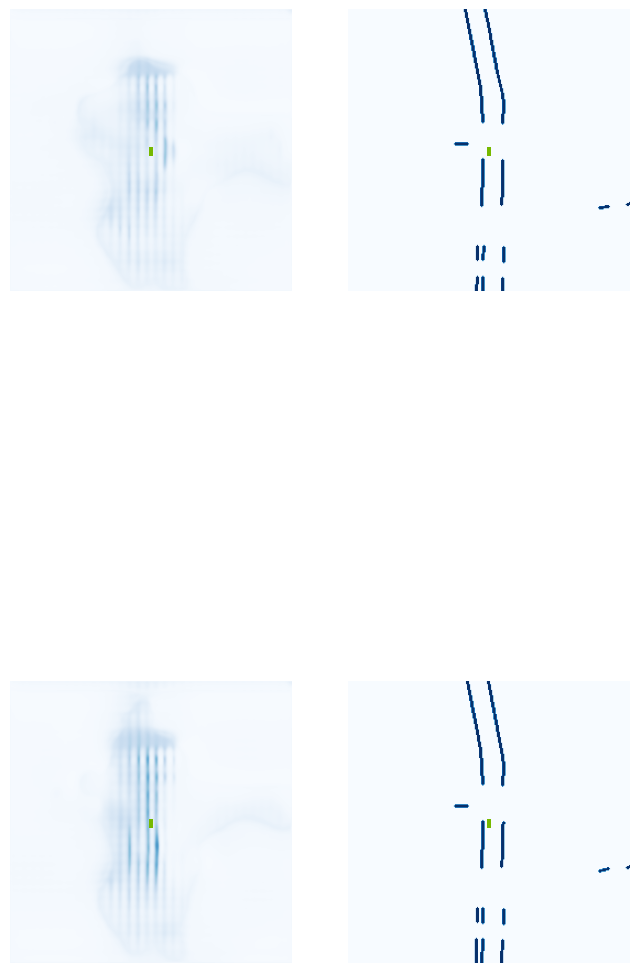

 65%|██████▌   | 26/40 [02:29<01:08,  4.86s/it]

Image saved! ... ./runs/get_val_info/25-iou-0.00.jpg


 68%|██████▊   | 27/40 [02:40<01:26,  6.68s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1acc040>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17f4cc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0b31580>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0b31580>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b0b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b0b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe184fbf0>
In Pillar Features - spatial_features size, whic

 72%|███████▎  | 29/40 [02:53<01:17,  7.01s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17f4cc0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17c70b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1af8900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1af8900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17dd7b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17dd7b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b31260>
In Pillar Features - spatial_features size, whic

 75%|███████▌  | 30/40 [02:53<00:49,  4.95s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b0b420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1af8900>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde59aac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde59aac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1828900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1828900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b0bd30>
In Pillar Features - spatial_features size, whic

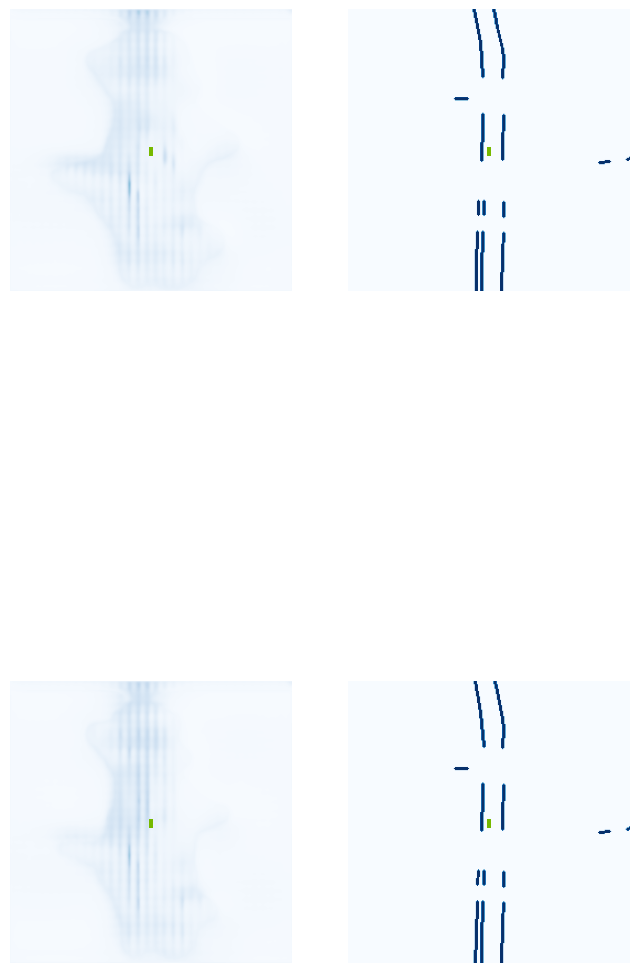

 80%|████████  | 32/40 [03:05<00:38,  4.86s/it]

Image saved! ... ./runs/get_val_info/30-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe184cbd0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1877470>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a9ab10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a9ab10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1991940>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1991940>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19bb

 82%|████████▎ | 33/40 [03:15<00:46,  6.67s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1968450>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19931f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19ce430>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19ce430>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19931f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19931f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3458f0>
In Pillar Features - spatial_features size, whic

 88%|████████▊ | 35/40 [03:27<00:33,  6.71s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1992f70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19ce750>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe194cc70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe194cc70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1993240>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1993240>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde49aa20>
In Pillar Features - spatial_features size, whic

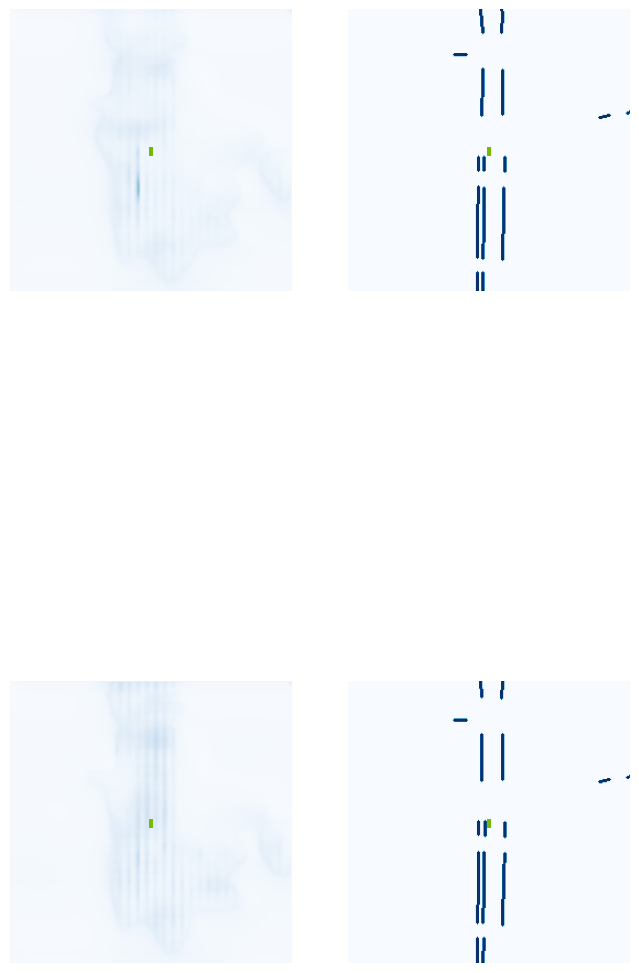

 90%|█████████ | 36/40 [03:27<00:19,  4.82s/it]

Image saved! ... ./runs/get_val_info/35-iou-0.00.jpg


 92%|█████████▎| 37/40 [03:39<00:20,  6.97s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b33010>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe194cc70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe184d580>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe184d580>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe194cc70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe194cc70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe184cbd0>
In Pillar Features - spatial_features size, whic

 98%|█████████▊| 39/40 [03:52<00:07,  7.17s/it]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe156e110>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe18024d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a26d90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a26d90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe156e110>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe156e110>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1992340>
In Pillar Features - spatial_features size, whic

100%|██████████| 40/40 [03:52<00:00,  5.81s/it]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe1a26ca0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b2390>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b3ce0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15b3ba0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15b3ba0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b0d10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1599530>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe159a3e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1598d10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1598d10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1598ef0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1598ef0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15992b0>
In Pillar Features - spatial_features size, whic

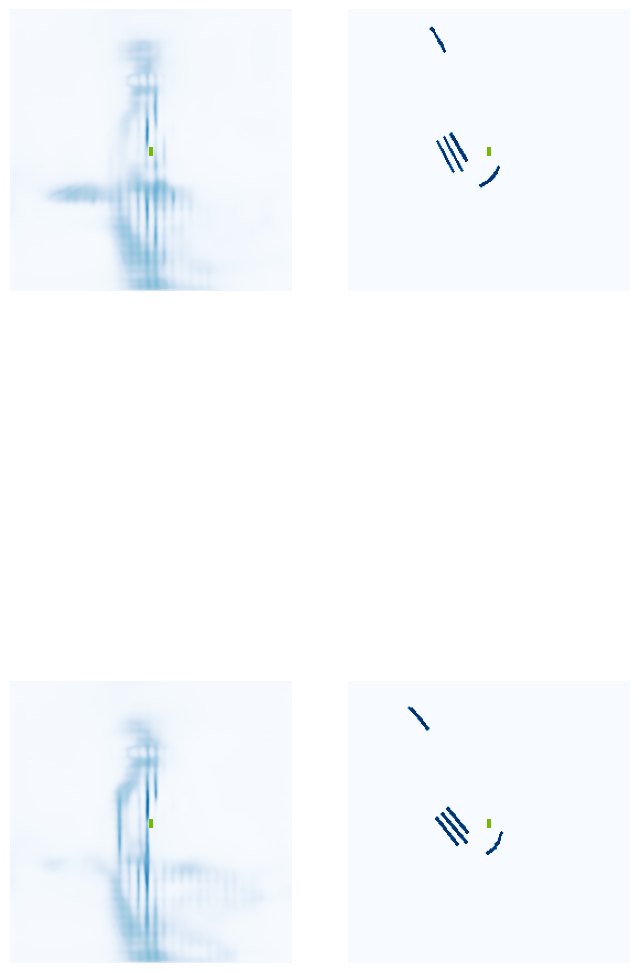

  5%|▌         | 2/40 [00:01<00:19,  1.91it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a24ea0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde25eac0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16e4090>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16e4090>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16e6700>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16e6700>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71d42

 10%|█         | 4/40 [00:01<00:09,  3.91it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd7121710>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd7121710>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19cda80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19cda80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ebbc5bdd0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7ebbc5bdd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1599fd0>

 12%|█▎        | 5/40 [00:01<00:07,  4.72it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1598ef0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe159a9d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71d5670>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71d5670>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1598090>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1598090>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71b3240>
In Pillar Features - spatial_features size, whic

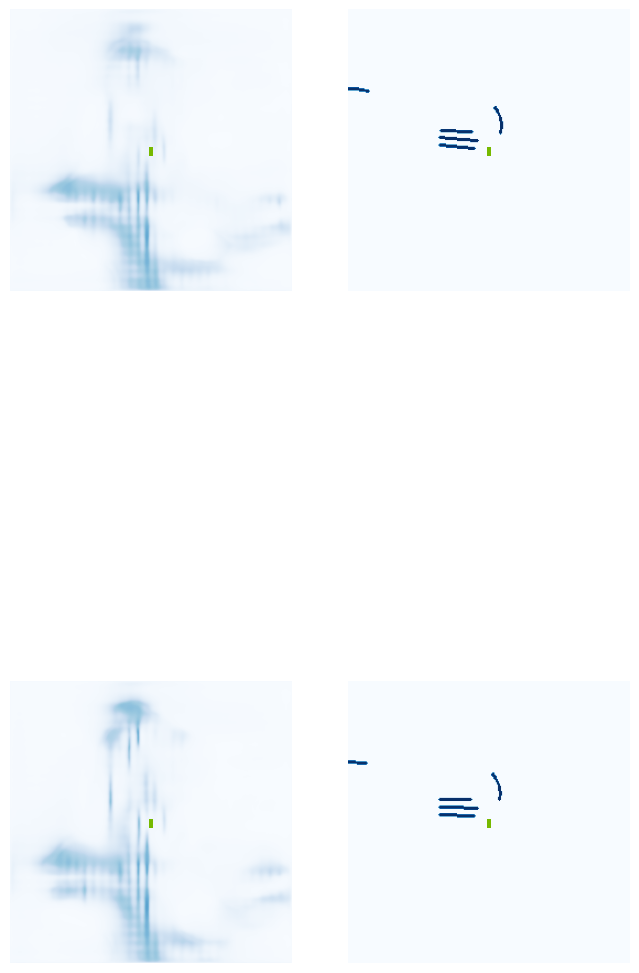

 18%|█▊        | 7/40 [00:02<00:08,  3.96it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19918f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17f79c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde49ef20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde49ef20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71b0900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71b0900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aecc

 22%|██▎       | 9/40 [00:02<00:05,  5.41it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1adb470>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1adb470>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16da610>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16da610>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17f4ea0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe17f4ea0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe159b920>

 25%|██▌       | 10/40 [00:02<00:04,  6.01it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16daf70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16da520>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1992ac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1992ac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b30b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b30b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16e4c70>
In Pillar Features - spatial_features size, whic

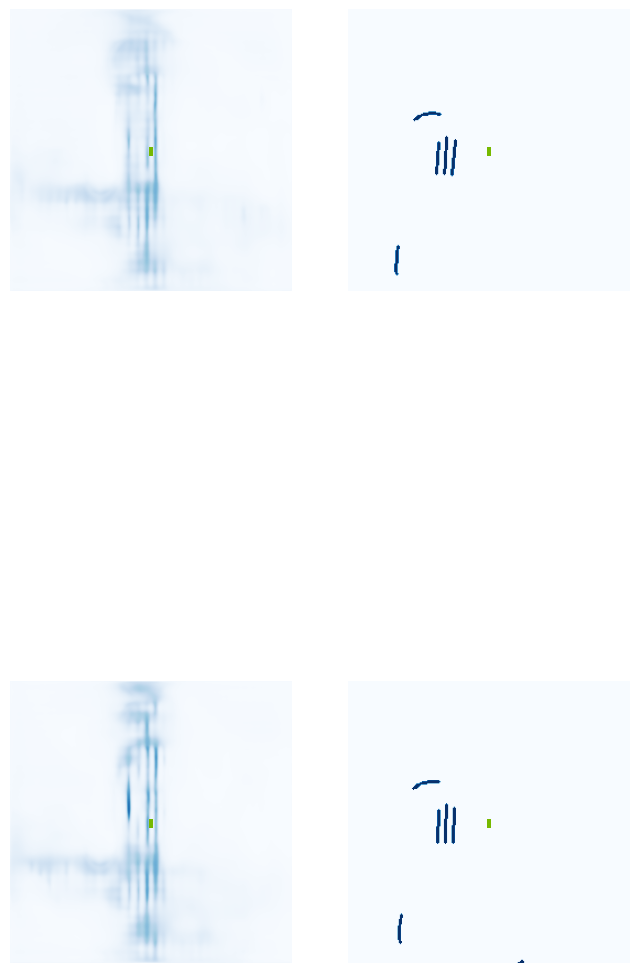

 30%|███       | 12/40 [00:03<00:05,  4.72it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b0b510>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ab5670>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b0b150>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b0b150>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b0b

 35%|███▌      | 14/40 [00:03<00:04,  6.14it/s]

Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ab5670>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde461c10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde461c10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159a1b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159a1b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde623e70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6226b0>
Forward pass of Block class - size of t

 38%|███▊      | 15/40 [00:03<00:03,  6.69it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde93ba60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde93ba60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a24ea0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a24ea0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0d17880>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe0d17880>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b33fb0>

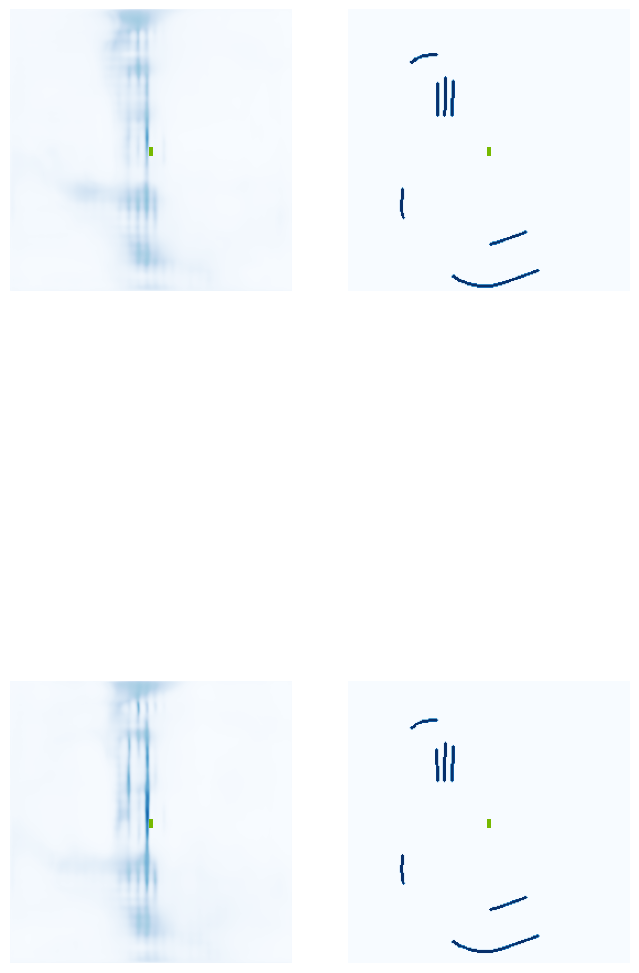

 42%|████▎     | 17/40 [00:04<00:04,  4.94it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7ccb30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9bfab0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f57b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f57b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde67a750>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde67a750>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5f3

 48%|████▊     | 19/40 [00:04<00:03,  6.25it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde67a980>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde67a980>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde48f420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde48f420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde462cf0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde462cf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde760720>

 50%|█████     | 20/40 [00:04<00:02,  6.68it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7f57b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7f5f30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde521d00>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde521d00>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde434ea0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde434ea0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7f57b0>
In Pillar Features - spatial_features size, whic

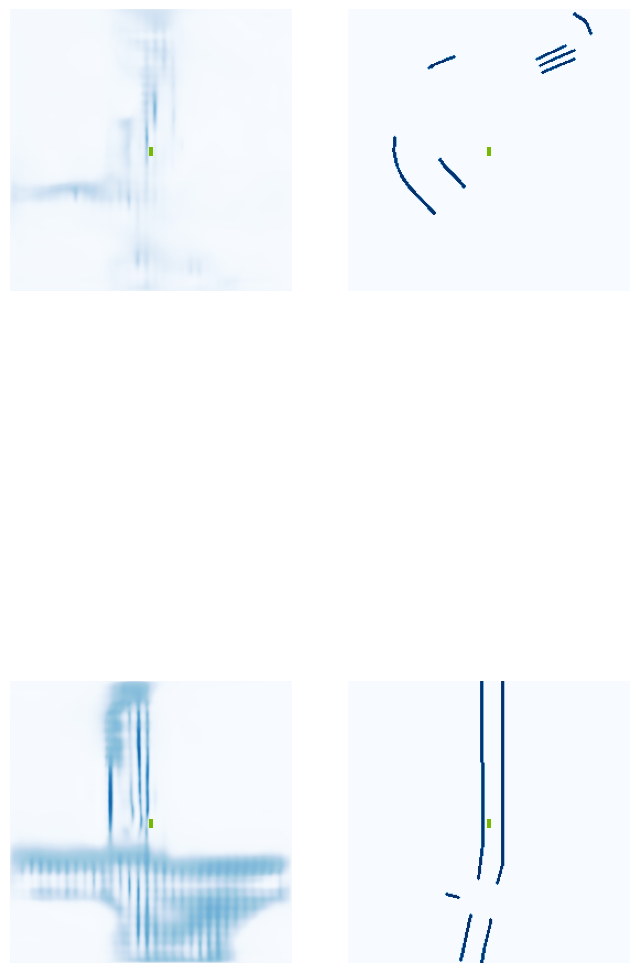

 55%|█████▌    | 22/40 [00:05<00:03,  4.77it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3453f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4d1530>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde891260>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde891260>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3e3a10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3e3a10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9c9

 60%|██████    | 24/40 [00:05<00:02,  6.09it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b33fb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b33fb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71cbe20>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd71cbe20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71e82c0>

 62%|██████▎   | 25/40 [00:05<00:02,  6.59it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3c69d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15273d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1724c20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1724c20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde59b6a0>
In Pillar Features - spatial_features size, whic

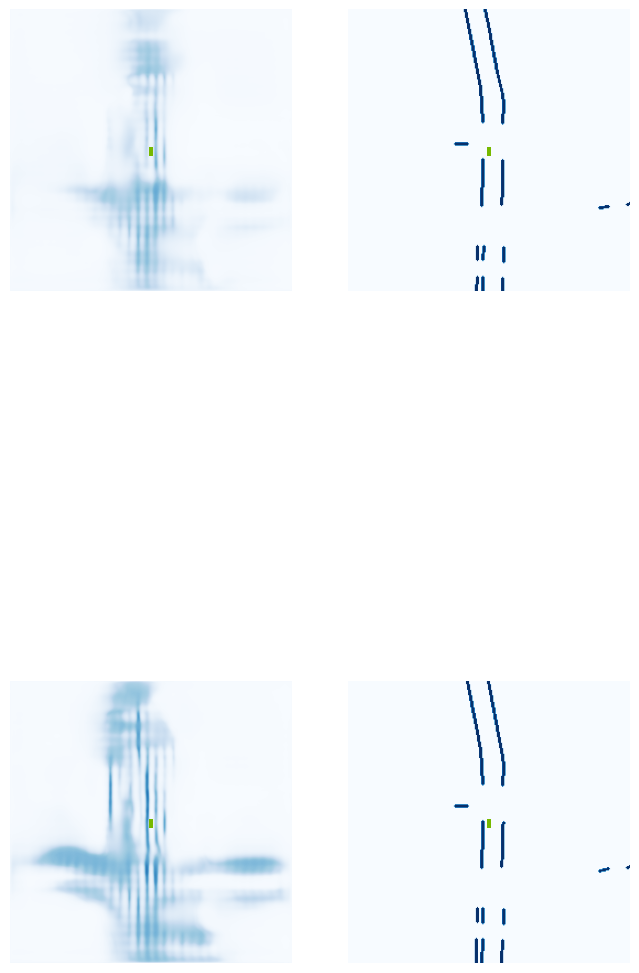

 68%|██████▊   | 27/40 [00:05<00:02,  4.90it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde9ca6b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde762ac0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde640680>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde640680>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde49ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde49ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2c6

 72%|███████▎  | 29/40 [00:06<00:01,  6.20it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a4e50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4e7b50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71eacf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a4e50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15d8b80>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe15d8b80> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde3a4e50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4e7ce0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4e6ed0>
Forward pass of Block class - 

 75%|███████▌  | 30/40 [00:06<00:01,  6.64it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f5f30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde622c50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde622c50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5b1e40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5b1e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4e7dd0>

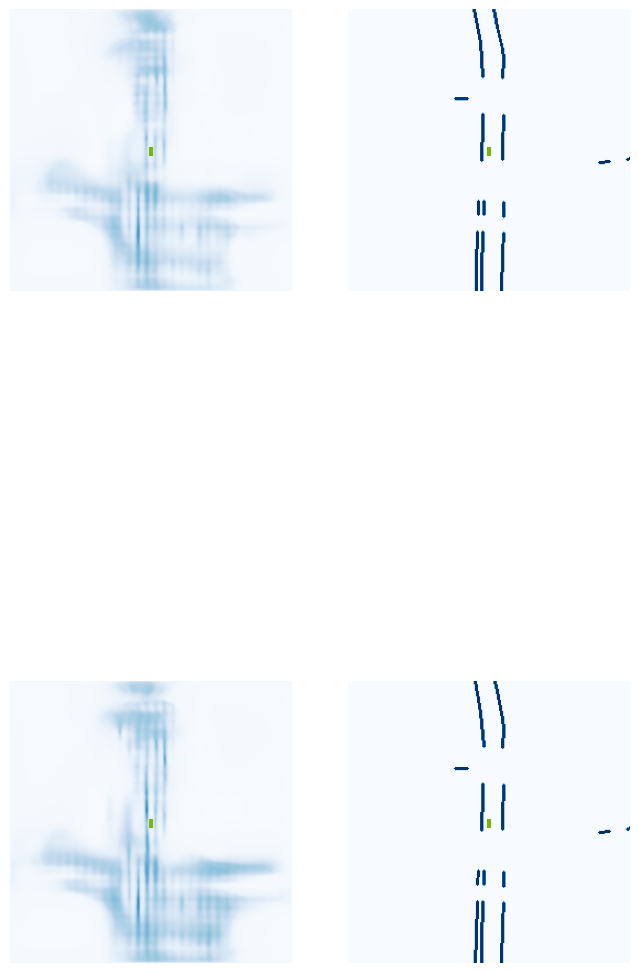

 80%|████████  | 32/40 [00:07<00:02,  3.55it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15a22f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4775b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15d0770>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15d0770>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15a3a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15a3a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4e5

 85%|████████▌ | 34/40 [00:07<00:01,  4.98it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde47b7e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4728e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4722a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde472930>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde472250>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde4b0040> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde472f70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde471c10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4722f0>
Forward pass of Block class - 

 88%|████████▊ | 35/40 [00:07<00:00,  5.63it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4e7600>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4e7600>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde472250>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde472250>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b3150>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde4b3150>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde473560>

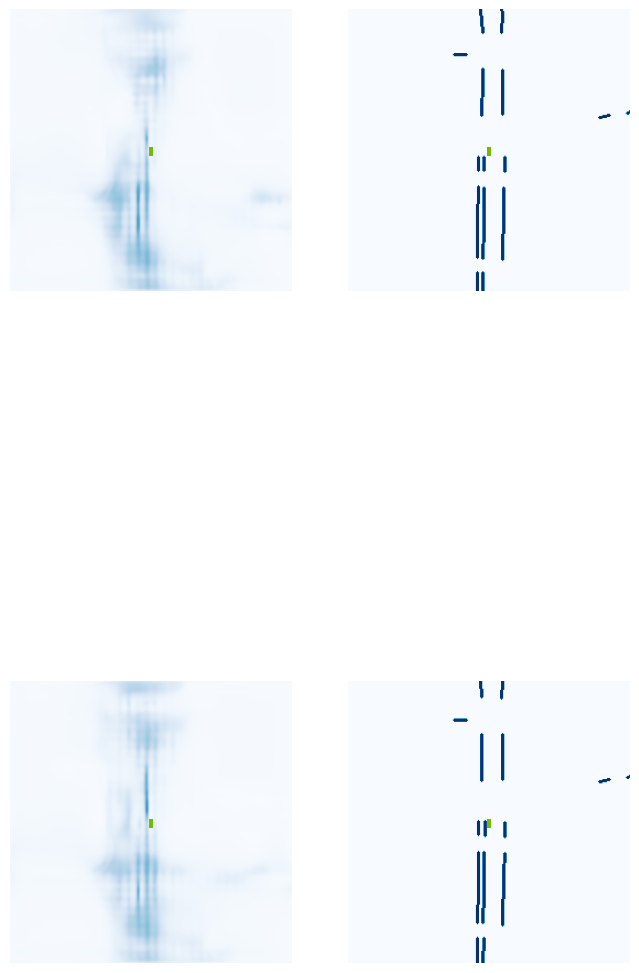

 92%|█████████▎| 37/40 [00:08<00:00,  4.68it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4726b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde498090>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15a3010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15a3010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71e9c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71e9c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71e9

 98%|█████████▊| 39/40 [00:08<00:00,  6.12it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4e5260>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde4e5260> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde4726b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71caa20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71cb470>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71c90d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71c8a40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71c9710>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71cad40>
Forward pass of Block class - 

100%|██████████| 40/40 [00:08<00:00,  4.66it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde6413a0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde643ce0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde642e80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde641df0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde641df0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde643600>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde642c00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde642b10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde640270>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde640270>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde641da0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde641da0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde642c50>
In Pillar Features - spatial_features size, whic

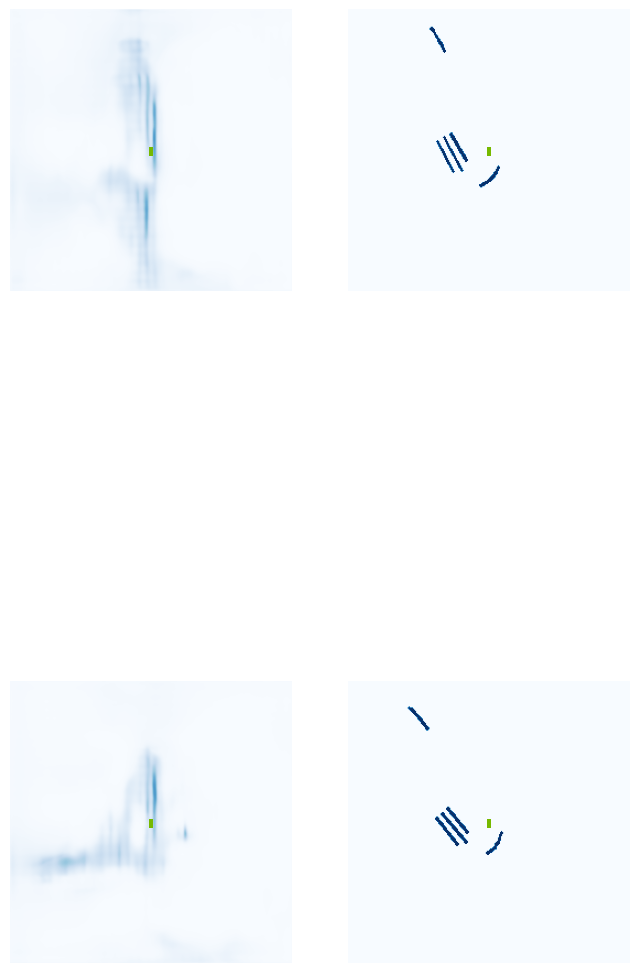

  5%|▌         | 2/40 [00:01<00:19,  1.90it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a50d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48d080>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e0f90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e0f90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde521c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde521c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ebbc5bd

 10%|█         | 4/40 [00:01<00:09,  3.79it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde48c450>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde48c450>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde640270>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde640270>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde471d50>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde471d50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c7740>

 12%|█▎        | 5/40 [00:01<00:07,  4.69it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a50d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1724860>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde641df0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde641df0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde641d00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde641d00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde48c450>
In Pillar Features - spatial_features size, whic

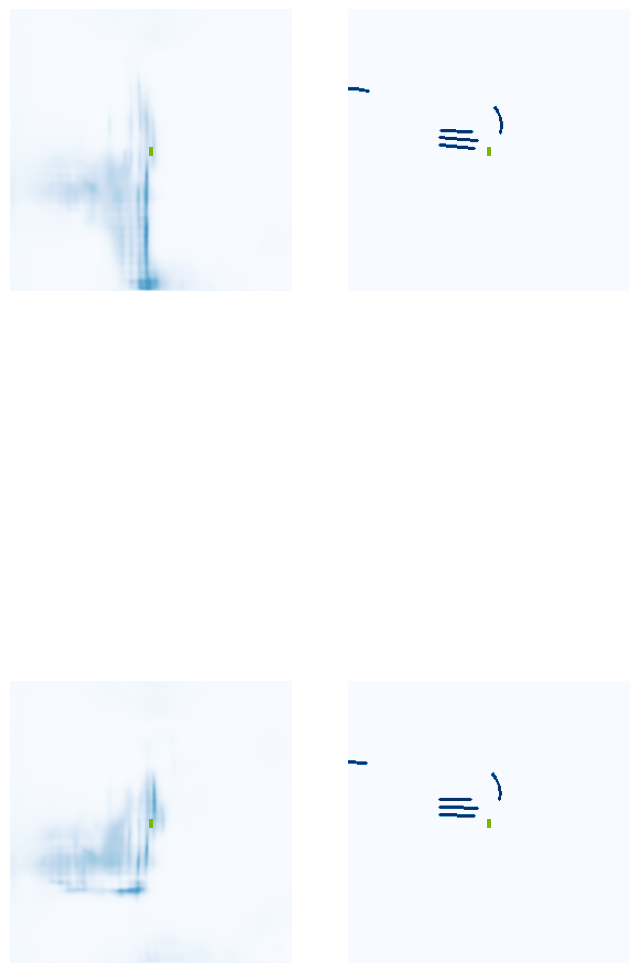

 18%|█▊        | 7/40 [00:02<00:07,  4.22it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5789f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2dfbf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e1a30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e1a30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde944a40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde944a40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3553

 22%|██▎       | 9/40 [00:02<00:05,  5.57it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71ca9d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd71ca9d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aed7b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aefd30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aee390>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aed7b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aefd30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aee390>
Forward pass of Block class - size

 25%|██▌       | 10/40 [00:02<00:04,  6.17it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0c36ed0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde57acf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5789f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5789f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c5670>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c5670>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1724860>
In Pillar Features - spatial_features size, whic

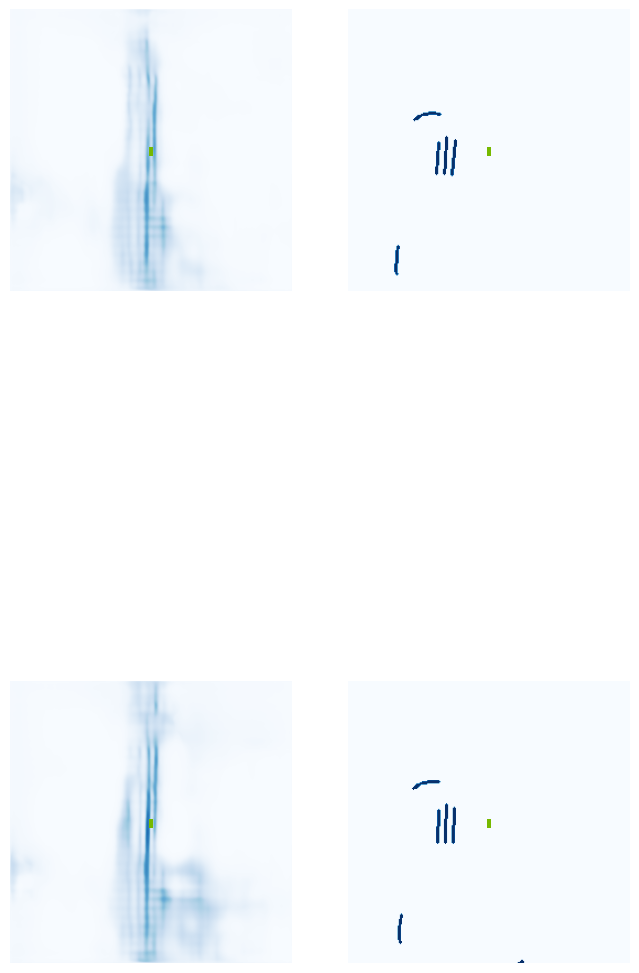

 30%|███       | 12/40 [00:03<00:05,  4.92it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0d153a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde40af70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0d17880>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0d17880>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c4fe0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c4fe0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde40b

 35%|███▌      | 14/40 [00:03<00:04,  6.13it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a5da0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57acf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fba10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa9d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fba10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa9d0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde3a5da0> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde2f8720>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15b1940>
Forward pass of Block class - 

 38%|███▊      | 15/40 [00:03<00:03,  6.56it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71b0ef0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71b1d00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5789f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5789f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71b0ef0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71b0ef0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57acf0>
In Pillar Features - spatial_features size, whic

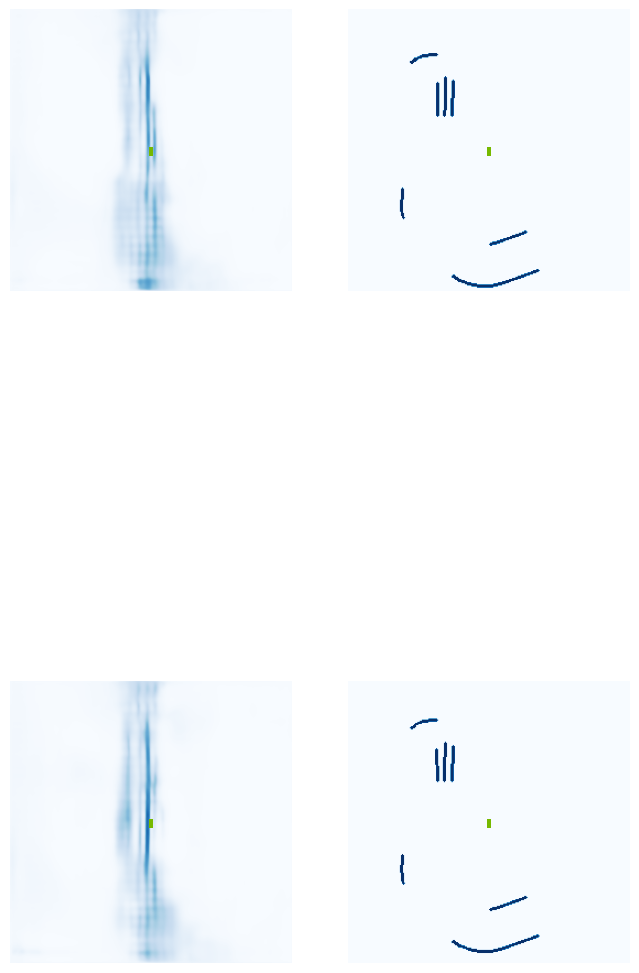

 42%|████▎     | 17/40 [00:04<00:04,  4.95it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71b38d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde56d3a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2f8d10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2f8d10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde298f40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde298f40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2fa

 48%|████▊     | 19/40 [00:04<00:03,  6.14it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5bd530>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5bd530>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde56d0d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde56d0d0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5e2750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5e2750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5c5940>

 50%|█████     | 20/40 [00:04<00:03,  6.61it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde56d0d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4e38d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71b38d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71b38d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2f8d10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2f8d10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71b1d00>
In Pillar Features - spatial_features size, whic

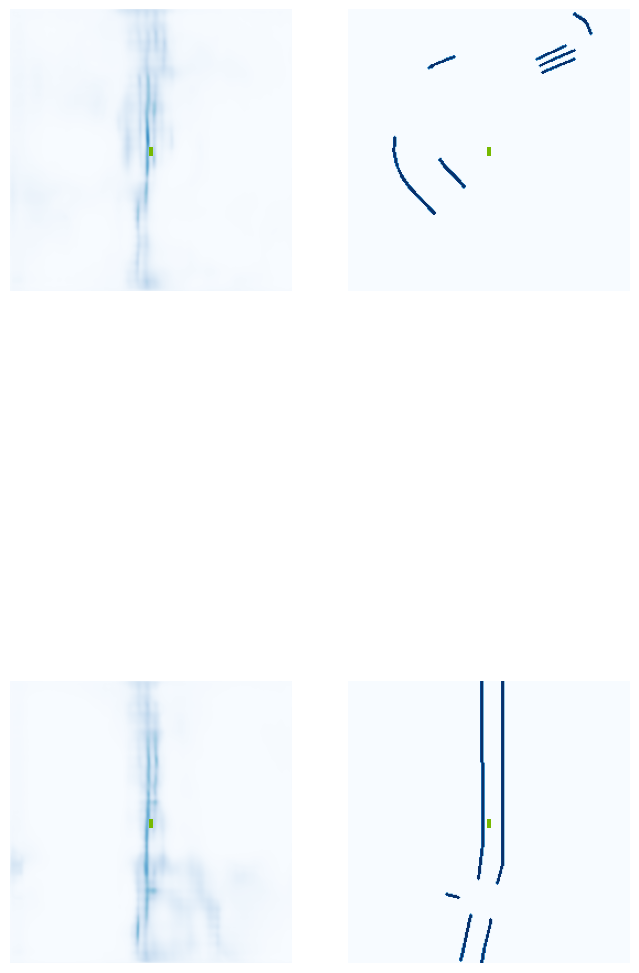

 55%|█████▌    | 22/40 [00:05<00:04,  3.63it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe158a750>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7ea87be840>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7ea87be160>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7ea87be160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1543420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1543420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe157a

 60%|██████    | 24/40 [00:05<00:03,  5.16it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b04cc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15783b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158a890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15783b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158a890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15783b0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe15783b0> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe158a890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f3a60>
Forward pass of Block class - 

 62%|██████▎   | 25/40 [00:05<00:02,  5.75it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1578b80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1578b80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7ea87be840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7ea87be840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15fdb20>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15fdb20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6f3ab0>

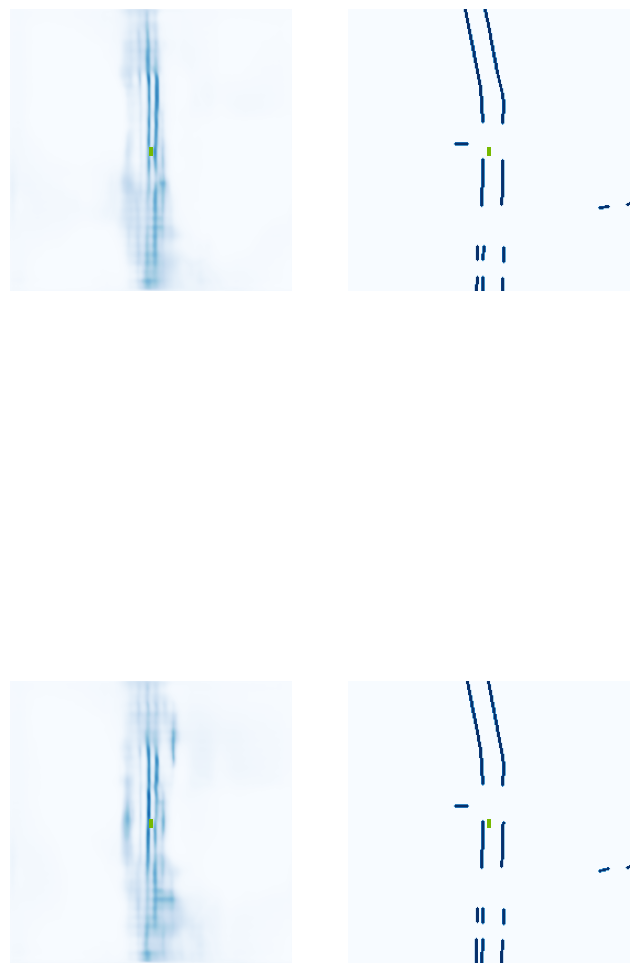

 68%|██████▊   | 27/40 [00:06<00:02,  4.73it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde9a2de0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe158acf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6afb50>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6afb50>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5e3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5e3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5f1

 72%|███████▎  | 29/40 [00:06<00:01,  5.89it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde56efc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde56efc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5e3060>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5e3060>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87be020>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7ea87be020>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde29bba0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.34it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde9a2a20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7cfd80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6f31a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6f31a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe158acf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe158acf0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87be020>
In Pillar Features - spatial_features size, whic

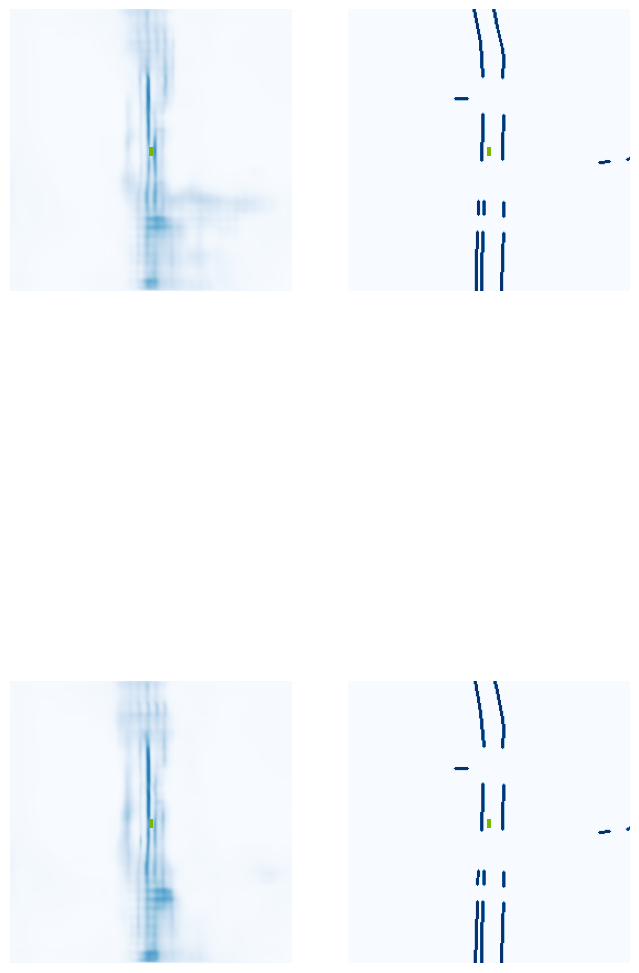

 80%|████████  | 32/40 [00:07<00:01,  4.83it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde59ab10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b0770>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5b26b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5b26b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7ea87bd120>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7ea87bd120>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde215

 85%|████████▌ | 34/40 [00:07<00:00,  6.21it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde27fe70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde27fe70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5b3790>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2f8090>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5b3790>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2f8360>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5b3790>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2f8090>
Forward pass of Block class - size

 88%|████████▊ | 35/40 [00:07<00:00,  6.55it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde25f3d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1527510>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde27ea20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde27ea20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde27f5b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde27f5b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde215e40>
In Pillar Features - spatial_features size, whic

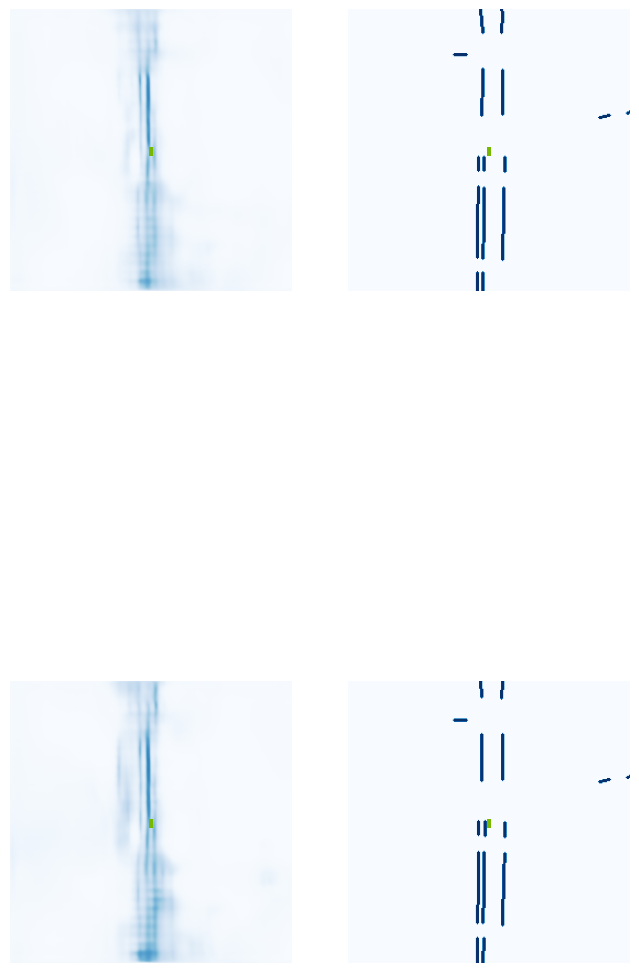

 92%|█████████▎| 37/40 [00:08<00:00,  5.05it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2fbe70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe0be6160>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde40b420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde40b420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde443a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde443a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aee

 98%|█████████▊| 39/40 [00:08<00:00,  6.32it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde460bd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde460bd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde461710>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde461710>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde40b420>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde40b420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71b1a30>

100%|██████████| 40/40 [00:08<00:00,  4.73it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe1544a40>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde760c70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7614e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde762f70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde762f70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde762a20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde864f90>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde864e00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde867240>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde867240>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde866840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde866840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde866de0>
In Pillar Features - spatial_features size, whic

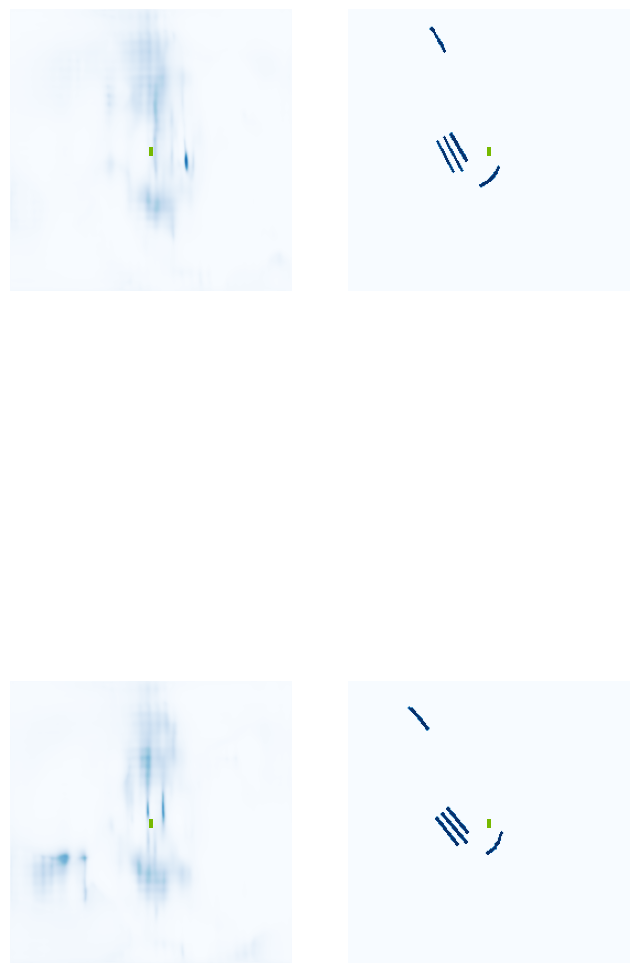

  5%|▌         | 2/40 [00:01<00:19,  1.96it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde890770>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2a5580>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde866020>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde866020>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde866d

 10%|█         | 4/40 [00:01<00:09,  3.87it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e3420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e3420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde867c90>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde867c90>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde362b10>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde362b10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde864bd0>

 12%|█▎        | 5/40 [00:01<00:07,  4.74it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15e3420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde864b80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e1530>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e1530>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde866f20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde866f20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3a4860>
In Pillar Features - spatial_features size, whic

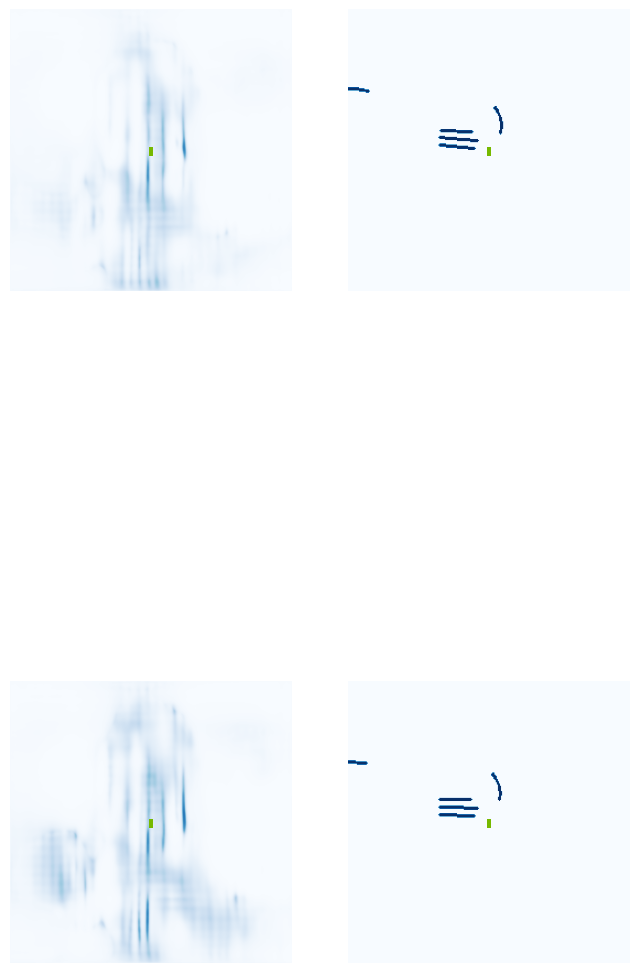

 18%|█▊        | 7/40 [00:02<00:07,  4.38it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1991e40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde866f70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15d1080>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15d1080>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b30ef0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b30ef0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7622

 22%|██▎       | 9/40 [00:02<00:05,  5.80it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e1f80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8669d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde8669d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7119210>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7119170>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7119530>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd71198f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7119210>
Forwa

 25%|██▌       | 10/40 [00:02<00:04,  6.27it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4b6750>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16042c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e3420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e3420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd7119b70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd7119b70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b6750>
In Pillar Features - spatial_features size, whic

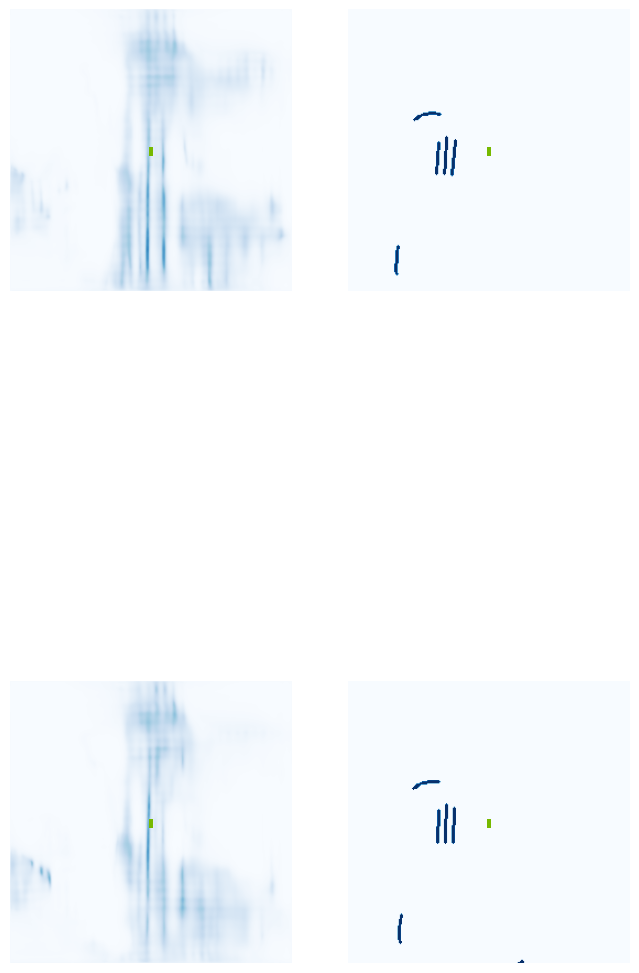

 30%|███       | 12/40 [00:03<00:08,  3.47it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7b04a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7b0310>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde477ec0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde477ec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7b04f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7b04f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7b0

 35%|███▌      | 14/40 [00:03<00:05,  4.92it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4765c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4765c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7b0900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7b0900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7b0310>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde7b0310>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9a74c0>

 38%|███▊      | 15/40 [00:03<00:04,  5.57it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde8edf30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe156cb80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7b2520>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7b2520>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9a7740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9a7740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe156cb80>
In Pillar Features - spatial_features size, whic

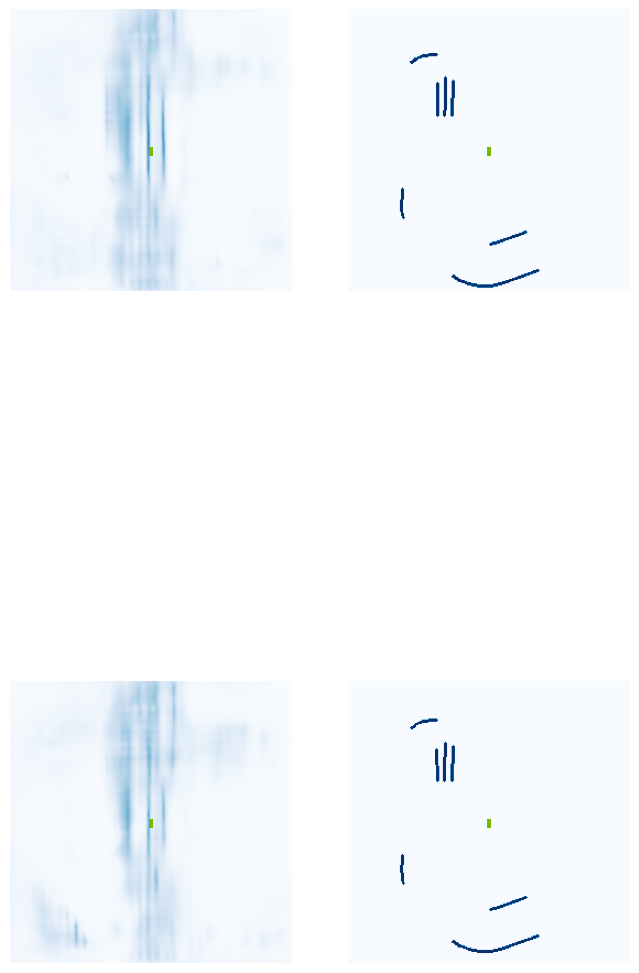

 42%|████▎     | 17/40 [00:04<00:05,  4.50it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4765c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9a72e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15d3ce0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15d3ce0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16e7470>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16e7470>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde476

 48%|████▊     | 19/40 [00:04<00:03,  5.70it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16e6f20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16e6f20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9a75b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9a75b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2d7290>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2d7290>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c4450>

 50%|█████     | 20/40 [00:04<00:03,  6.19it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7b06d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b32980>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9a7420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9a7420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9a77e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9a77e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8edf30>
In Pillar Features - spatial_features size, whic

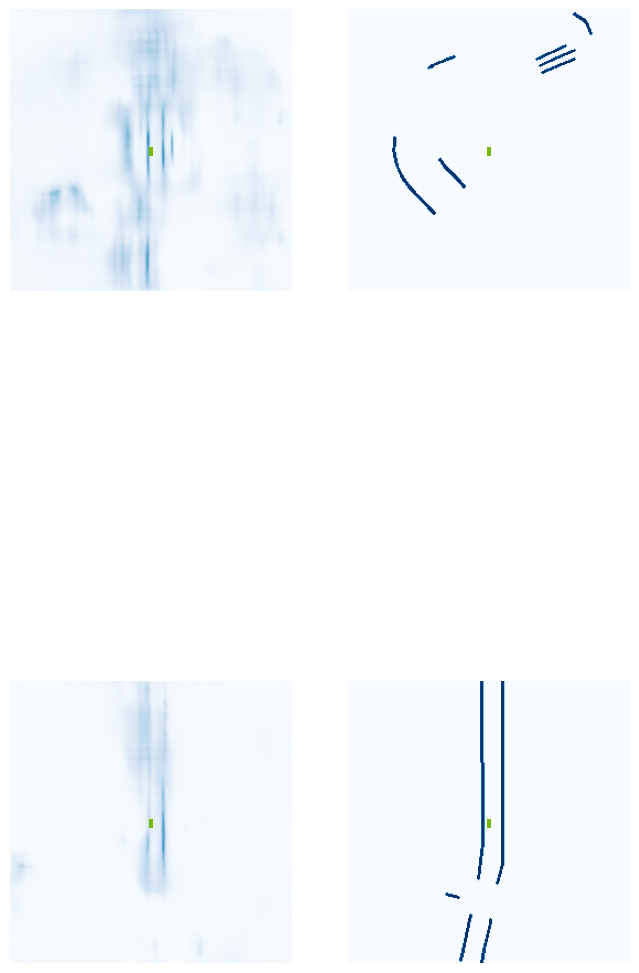

 55%|█████▌    | 22/40 [00:05<00:03,  4.93it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2a4540>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1726430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f52b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f52b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7f4950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7f4950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde522

 60%|██████    | 24/40 [00:05<00:02,  6.11it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c6fc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1726110>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7b3dd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c6fc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9e4130>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde762d90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c4b30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1726430>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1726430> and l

 62%|██████▎   | 25/40 [00:05<00:02,  6.48it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b32980>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15d0220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7b0cc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7b0cc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7b0400>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7b0400>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b31300>
In Pillar Features - spatial_features size, whic

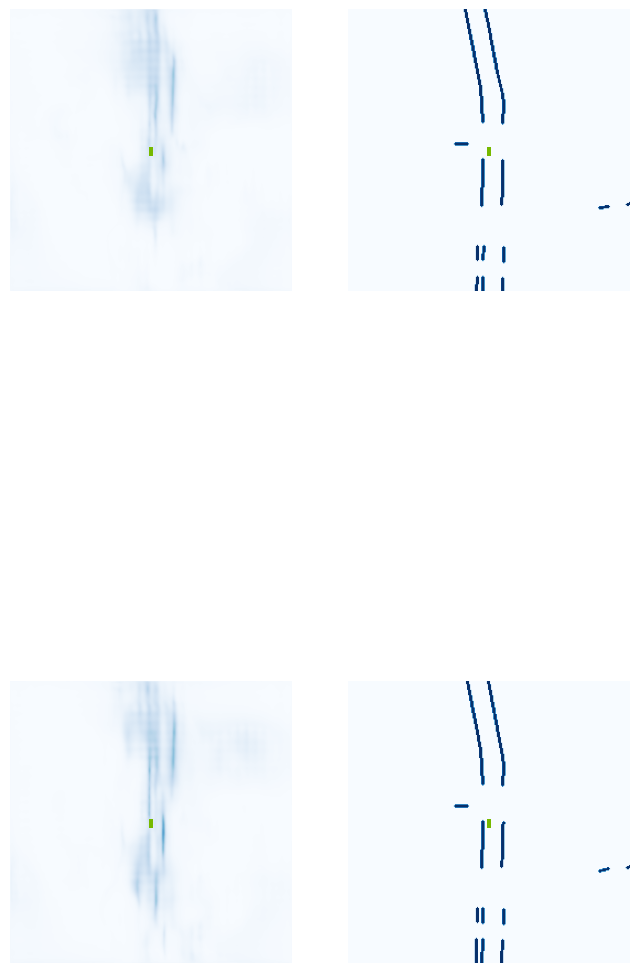

 68%|██████▊   | 27/40 [00:06<00:02,  5.04it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4436f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7b0cc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde442f70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde442f70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde442cf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde442cf0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde759

 72%|███████▎  | 29/40 [00:06<00:01,  6.29it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f52b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f52b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15d3ce0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15d3ce0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b08810>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b08810>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16db600>

 75%|███████▌  | 30/40 [00:06<00:01,  6.78it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde274ea0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde67bd30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7b0400>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7b0400>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2140e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2140e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b54950>
In Pillar Features - spatial_features size, whic

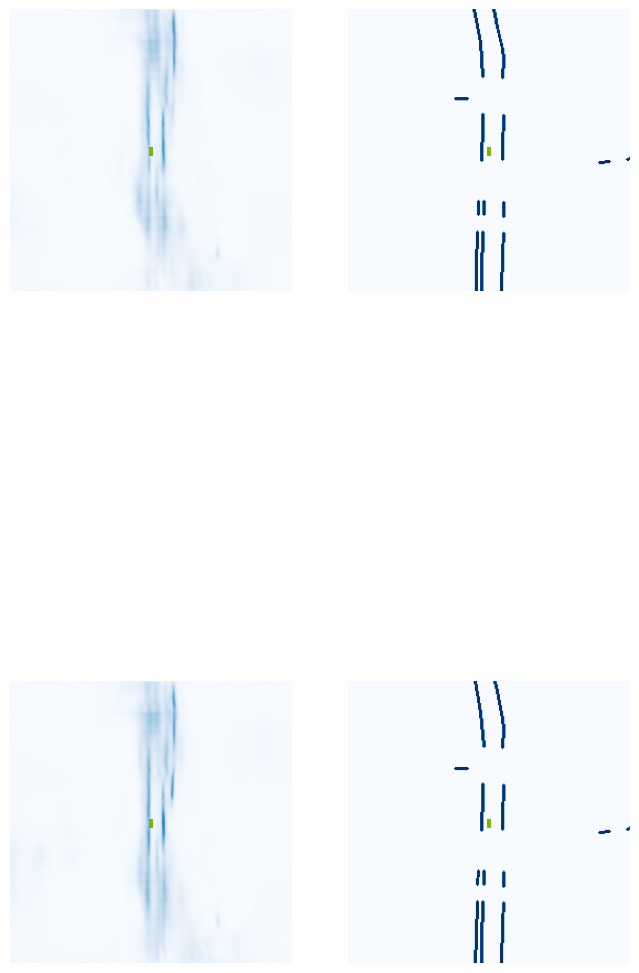

 80%|████████  | 32/40 [00:07<00:01,  5.16it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7f4540>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4e0950>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde78eb60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde78eb60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4430b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4430b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4e0

 85%|████████▌ | 34/40 [00:07<00:00,  6.41it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991030>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991bc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991170>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991ee0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991030>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1990ea0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1991670>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19915d0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde7cc630> and l

 88%|████████▊ | 35/40 [00:07<00:00,  6.80it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde277920>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde277920>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4092b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4092b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7f4540>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde7f4540>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1990ea0>

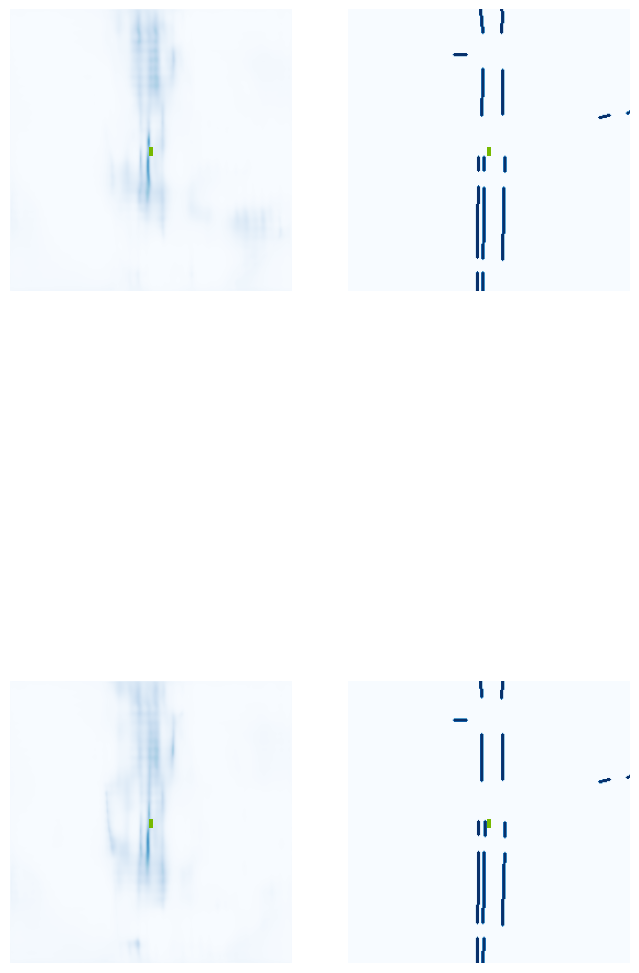

 92%|█████████▎| 37/40 [00:08<00:00,  4.78it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b1300>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b2570>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde440b80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde440b80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4e0950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4e0950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1992

 98%|█████████▊| 39/40 [00:08<00:00,  6.17it/s]

Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15b0040>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4e0950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4e0950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1991a30>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1991a30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6402c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642660>
Forward pass of Block class - size of t

100%|██████████| 40/40 [00:08<00:00,  4.73it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe15c0680>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1612ed0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1611c60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16110d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16110d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1612c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a82fc0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a80bd0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a82b60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a82b60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a82cf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a82cf0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a832e0>
In Pillar Features - spatial_features size, whic

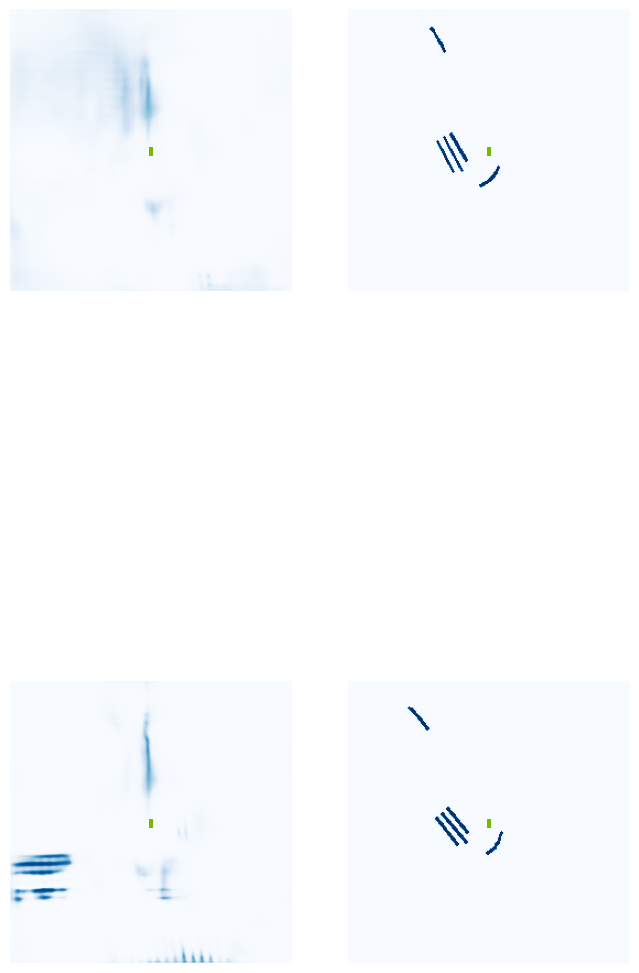

  5%|▌         | 2/40 [00:01<00:18,  2.06it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19775b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15c1df0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5bc040>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5bc040>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5bec00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5bec00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19759

 10%|█         | 4/40 [00:01<00:09,  3.95it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15983b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15983b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5bec00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5bec00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19cd620>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19cd620>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a82b10>

 12%|█▎        | 5/40 [00:01<00:07,  4.83it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a835b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a83880>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde298180>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde298180>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a82570>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a82570>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19ce390>
In Pillar Features - spatial_features size, whic

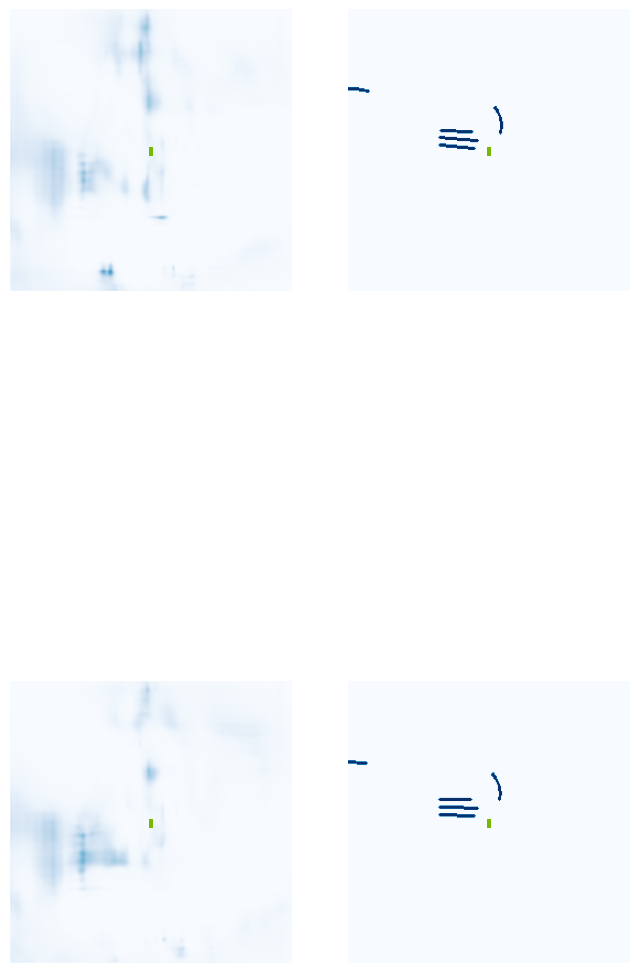

 18%|█▊        | 7/40 [00:02<00:07,  4.30it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde599da0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde598220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5f2b10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5f2b10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde599c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde599c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87bc2

 22%|██▎       | 9/40 [00:02<00:05,  5.68it/s]


Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2173d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde215990>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde214680>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde217e20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde214130>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde215990>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2173d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde214680>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde7ce020> and 

 25%|██▌       | 10/40 [00:02<00:04,  6.22it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159ba10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b29e40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde436750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde436750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a80c70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a80c70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7206d0>
In Pillar Features - spatial_features size, whic

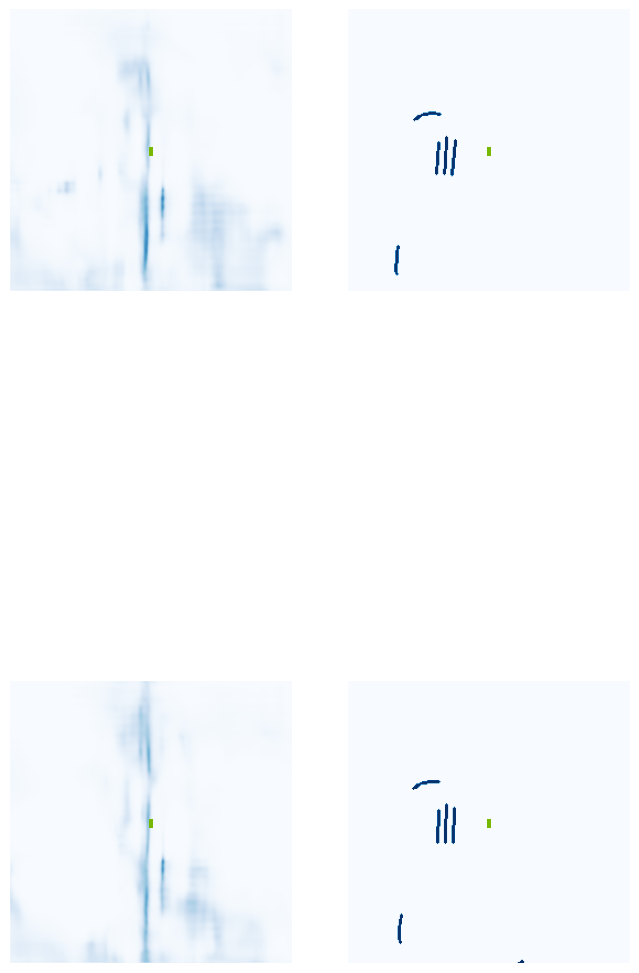

 30%|███       | 12/40 [00:03<00:05,  4.75it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19faf70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19f8220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde8f7970>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde8f7970>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde353420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde353420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde442

 35%|███▌      | 14/40 [00:03<00:04,  6.06it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b0af70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b0af70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b558a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b558a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1613c90>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1613c90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde523740>

 38%|███▊      | 15/40 [00:03<00:03,  6.47it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde59b0b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1613c90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159ba10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159ba10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde217740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde217740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159af70>
In Pillar Features - spatial_features size, whic

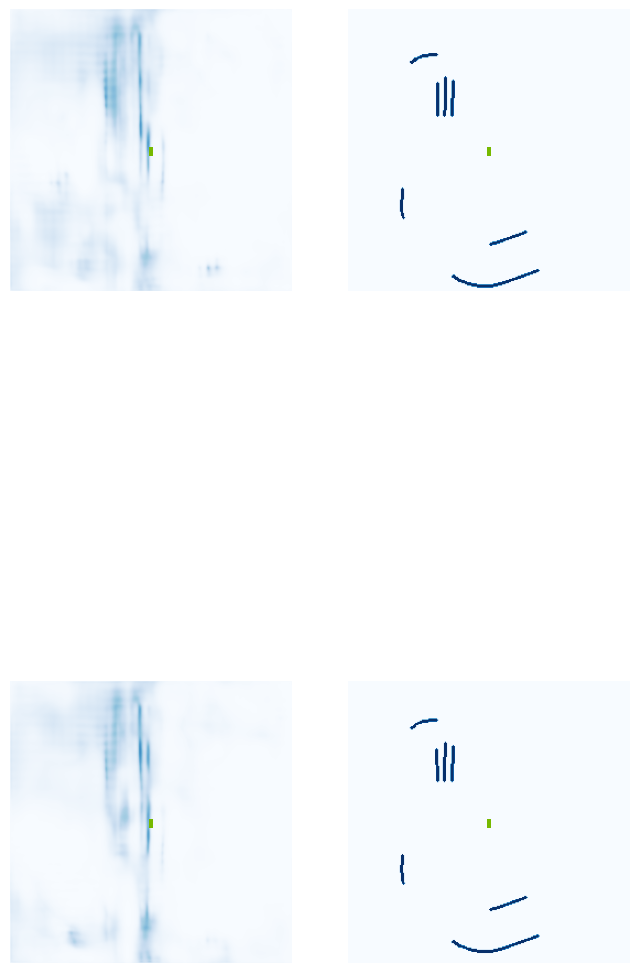

 42%|████▎     | 17/40 [00:03<00:04,  4.99it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159af70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde67af20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2d4630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2d4630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde59ab10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde59ab10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b54

 48%|████▊     | 19/40 [00:04<00:03,  6.06it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a80220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a80220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4413a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4413a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159af70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159af70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b558a0>

 50%|█████     | 20/40 [00:04<00:03,  6.55it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2d5f80>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4413a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7594e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7594e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7599e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7599e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5bc040>
In Pillar Features - spatial_features size, whic

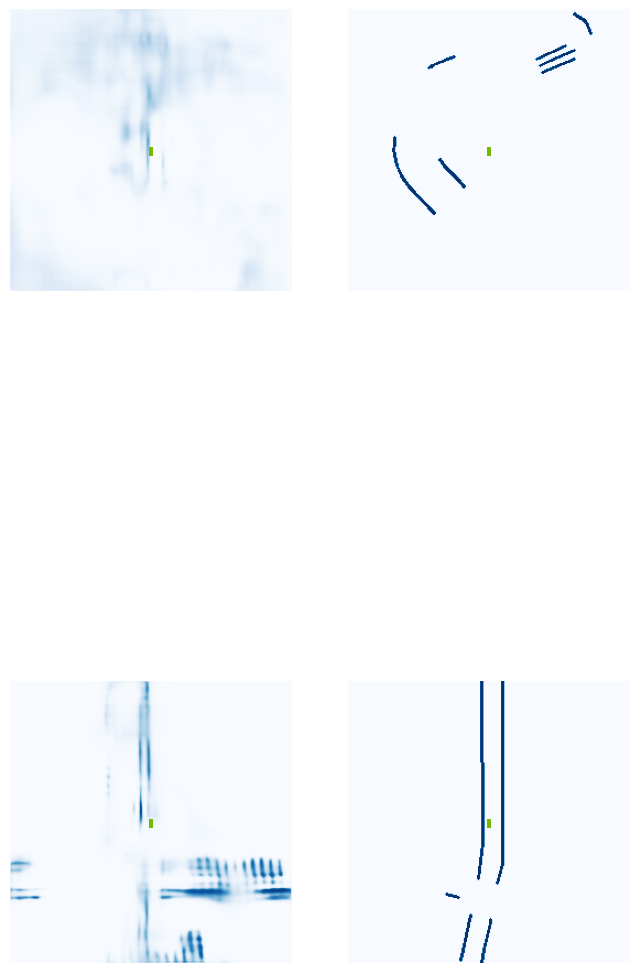

 55%|█████▌    | 22/40 [00:04<00:03,  4.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b558a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde890220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde903d80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde903d80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c5300>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c5300>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde43e

 60%|██████    | 24/40 [00:05<00:02,  6.14it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0d171f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0d171f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde344860>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde344860>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe159bd30>

 62%|██████▎   | 25/40 [00:05<00:02,  6.61it/s]

Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71ca6b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3c7d80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3c7d80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a821b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1a821b0>
Forwar

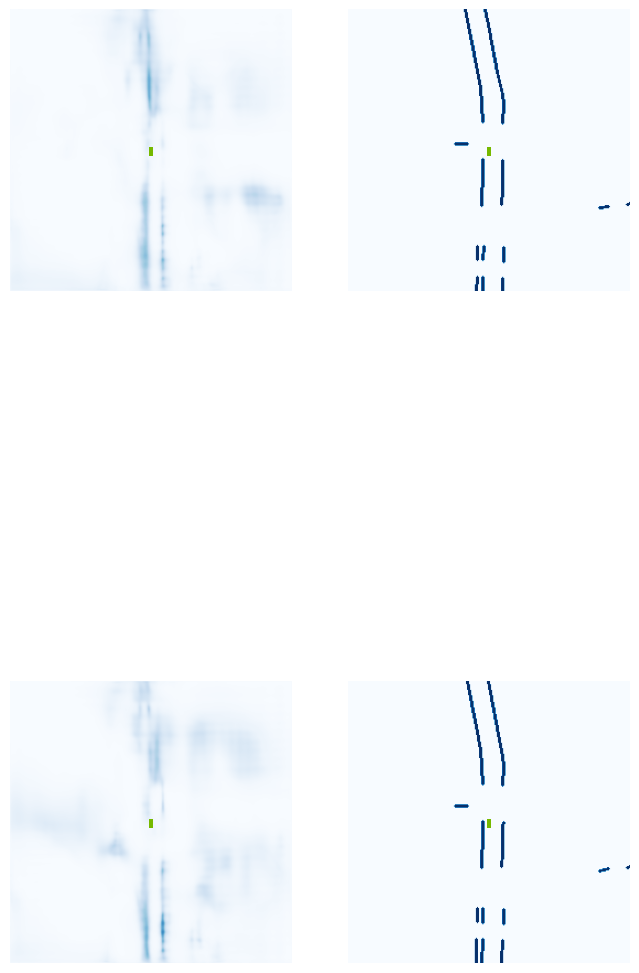

 68%|██████▊   | 27/40 [00:05<00:02,  4.86it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3c71f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1547bf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3c4130>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3c4130>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c71f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4d0

 72%|███████▎  | 29/40 [00:06<00:01,  6.14it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3026b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3026b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde944630>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde944630>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde303ce0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde303ce0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5e7100>

 75%|███████▌  | 30/40 [00:06<00:01,  6.71it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde346f20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde346f20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde944630>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde944630>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16e59e0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe16e59e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5e6b60>

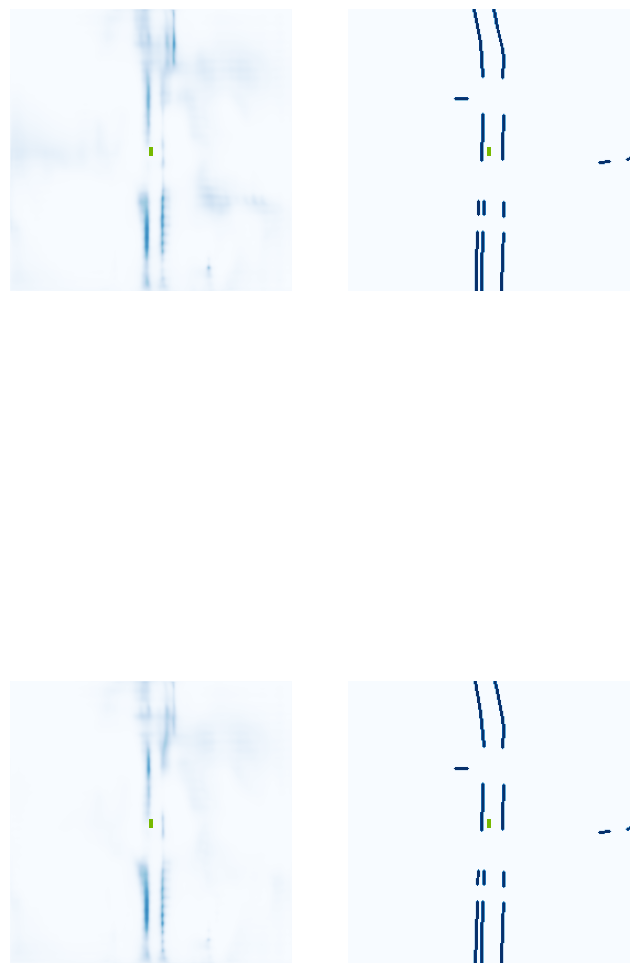

 80%|████████  | 32/40 [00:06<00:01,  4.84it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a47fb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4cbce0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1727f60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1727f60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a47fb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a47fb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4d0

 85%|████████▌ | 34/40 [00:07<00:00,  6.12it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde43d530> and l

 88%|████████▊ | 35/40 [00:07<00:00,  6.53it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde944630>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71cbe70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4be070>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4be070>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4bc950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4bc950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4cbce0>
In Pillar Features - spatial_features size, whic

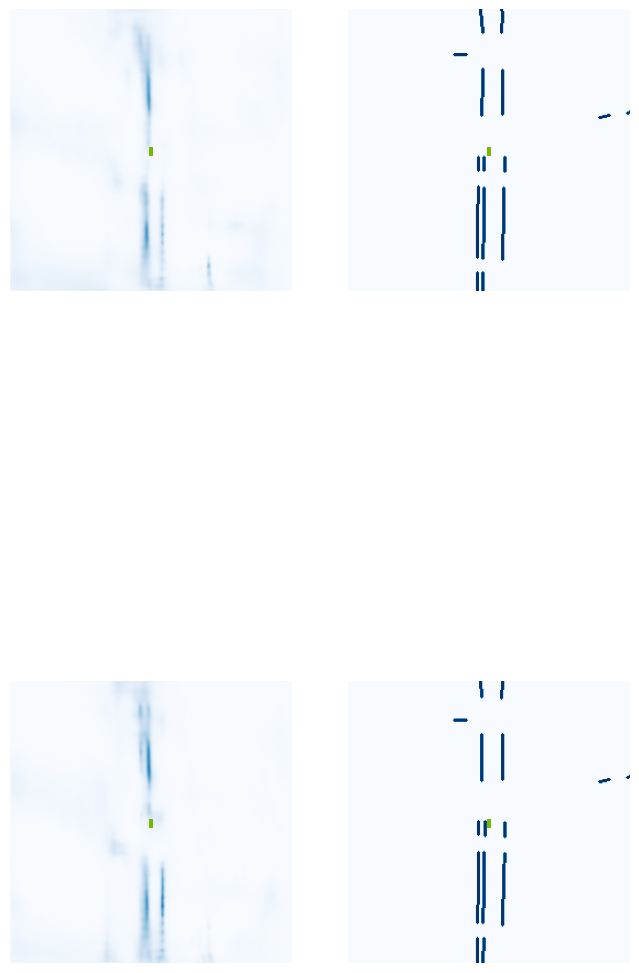

 92%|█████████▎| 37/40 [00:07<00:00,  4.85it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ab4400>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1608b30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ad0630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ad0630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a908b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a908b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad5

 98%|█████████▊| 39/40 [00:07<00:00,  6.11it/s]

In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1570360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1570360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1ad5e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe155ec50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe155c220>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe155c180>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor objec

100%|██████████| 40/40 [00:08<00:00,  4.91it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe16aac50>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe155dcb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe155fe20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe155fc90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe155fc90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe155dda0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15e0720>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15e3970>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e2c50>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e2c50>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e0bd0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e0bd0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15e2d40>
In Pillar Features - spatial_features size, whic

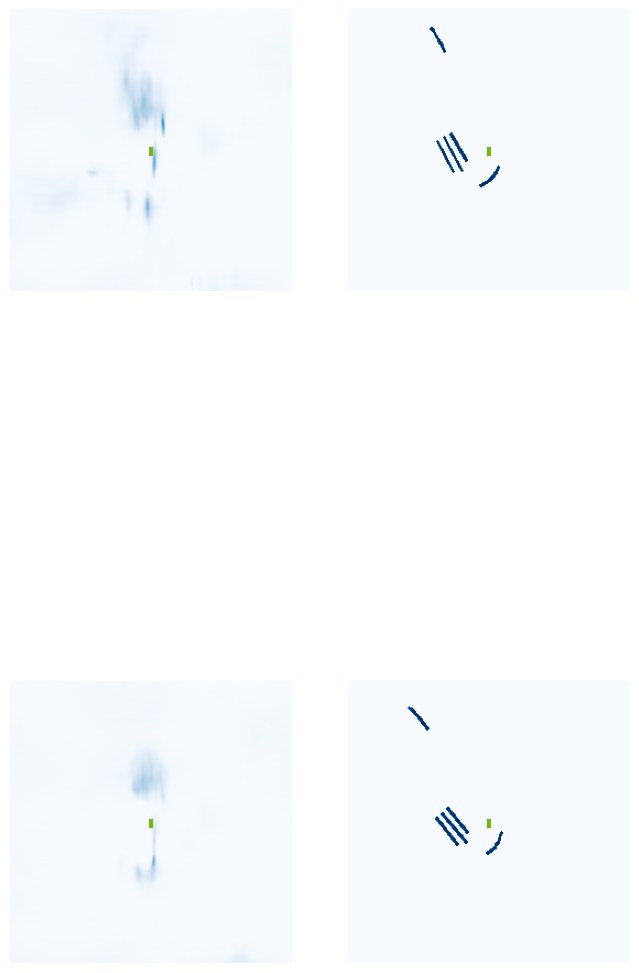

  5%|▌         | 2/40 [00:01<00:18,  2.03it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15e2a20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15e2020>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16a9990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16a9990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e1080>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e1080>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609c

 10%|█         | 4/40 [00:01<00:08,  4.03it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16a9990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16a9990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e3ba0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e3ba0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609300>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1609300>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a92de0>

 12%|█▎        | 5/40 [00:01<00:07,  4.89it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe155cef0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe155ef20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a25f80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a25f80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad74c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad74c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe155ef20>
In Pillar Features - spatial_features size, whic

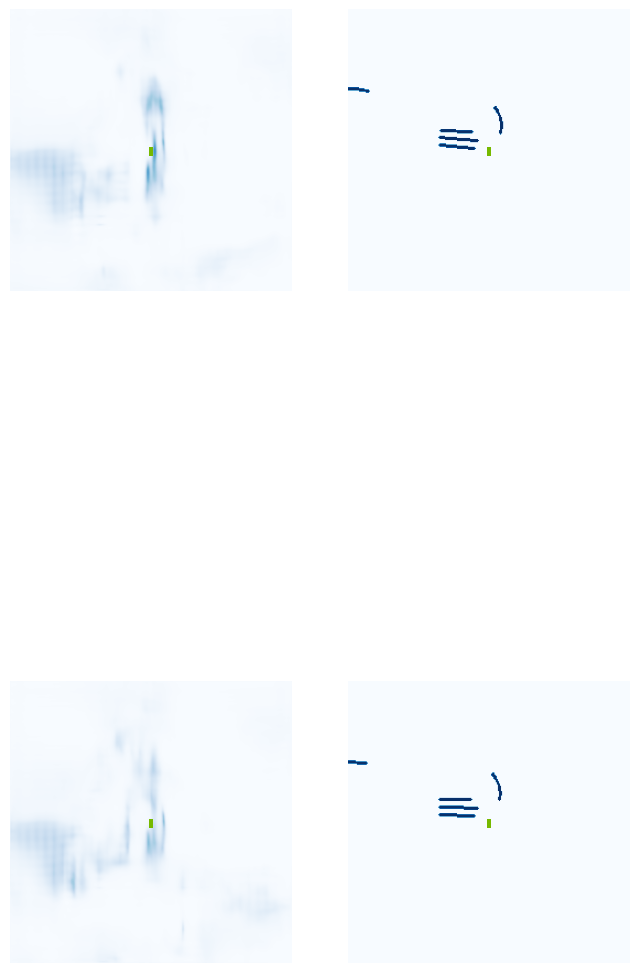

 18%|█▊        | 7/40 [00:02<00:07,  4.42it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a92f70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a91490>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe195c6d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe195c6d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e0540>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e0540>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609c

 22%|██▎       | 9/40 [00:02<00:05,  5.80it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1992750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1992750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15780e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde891760>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15780e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde891530>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15780e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde891760>
Forward pass of Block class - size

 25%|██▌       | 10/40 [00:02<00:04,  6.35it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0c37010>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b14bd0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde891800>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde891800>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a91d00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a91d00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde891bc0>
In Pillar Features - spatial_features size, whic

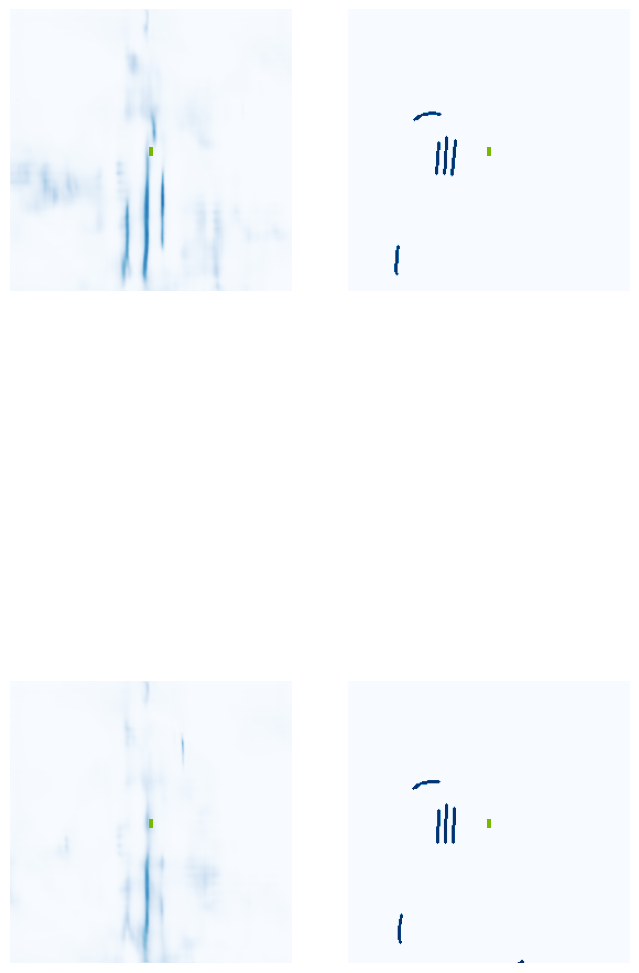

 30%|███       | 12/40 [00:03<00:05,  4.78it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2d74c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71ca200>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2d4f40>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2d4f40>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2d5e40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2d5e40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609

 35%|███▌      | 14/40 [00:03<00:04,  6.03it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2d4f40>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2d4f40>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5557b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5557b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2d5e40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2d5e40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a45e0>

 38%|███▊      | 15/40 [00:03<00:03,  6.52it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a6a20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a7e70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5557b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5557b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde8657b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde8657b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe160aac0>
In Pillar Features - spatial_features size, whic

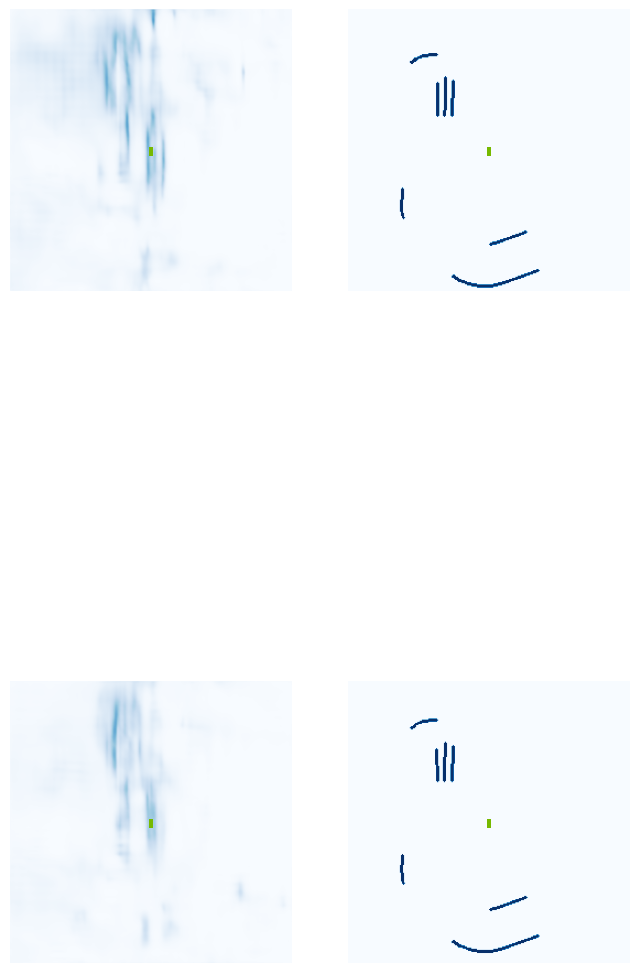

 42%|████▎     | 17/40 [00:03<00:04,  4.67it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a92f70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71ca200>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde440090>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde440090>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fb420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fb420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609

 48%|████▊     | 19/40 [00:04<00:03,  6.00it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c89c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde598090>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9ca930>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde59a750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9ca930>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde599210>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9ca930>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde9ca930> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde59a430>
Forward pass of Block class - 

 50%|█████     | 20/40 [00:04<00:03,  6.54it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde740220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde740220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2d74c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2d74c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde440090>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde440090>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5989a0>

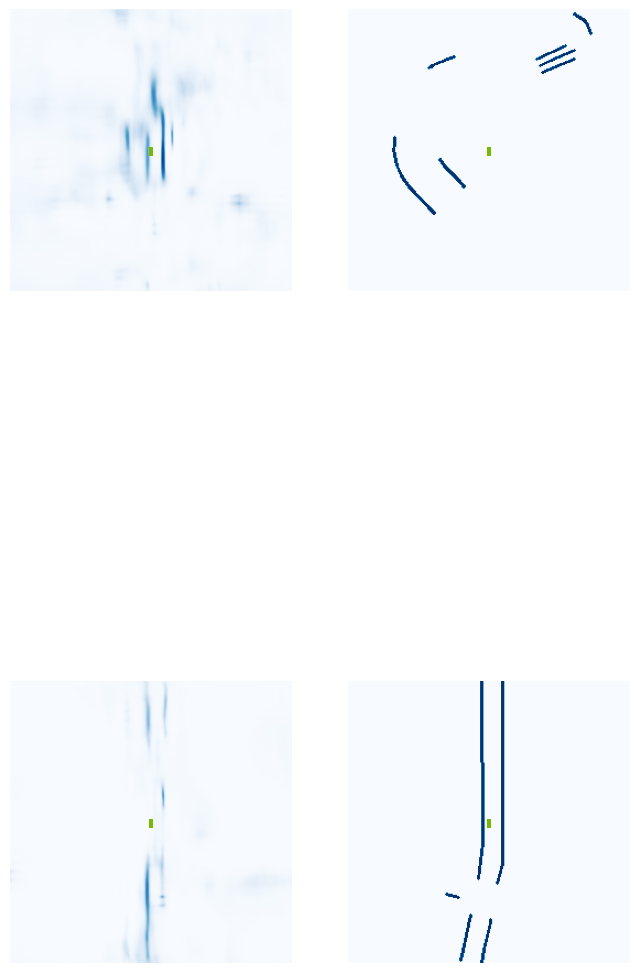

 55%|█████▌    | 22/40 [00:04<00:03,  4.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe0c8b290>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde578040>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde578040>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde298360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde298360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609

 60%|██████    | 24/40 [00:05<00:02,  6.12it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b23510>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b23510>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71e8220>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71e8220>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19fb420>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19fb420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe159a4d0>

 62%|██████▎   | 25/40 [00:05<00:02,  6.60it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde299170>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b23510>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1598d10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1598d10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5993a0>
In Pillar Features - spatial_features size, whic

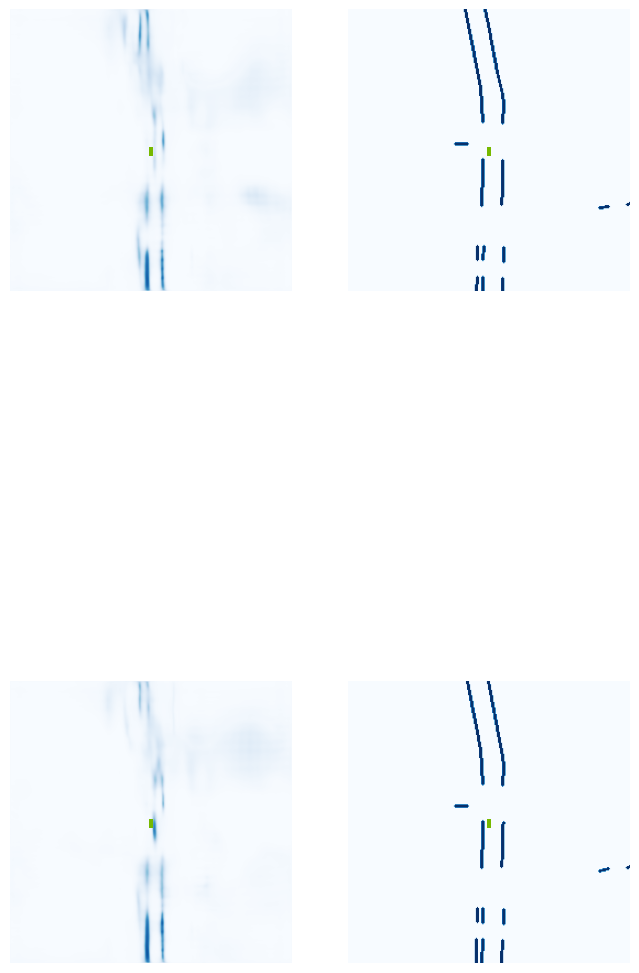

 68%|██████▊   | 27/40 [00:05<00:02,  4.82it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15993f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde642020>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a81c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a81c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1609

 72%|███████▎  | 29/40 [00:06<00:01,  5.97it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19cef20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19cef20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19cd170>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19cd170>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15a2610>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15a2610>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1547d80>

 75%|███████▌  | 30/40 [00:06<00:01,  6.47it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde460810>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde29a6b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde29a6b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5e6c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5e6c00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1598d10>
In Pillar Features - spatial_features size, whic

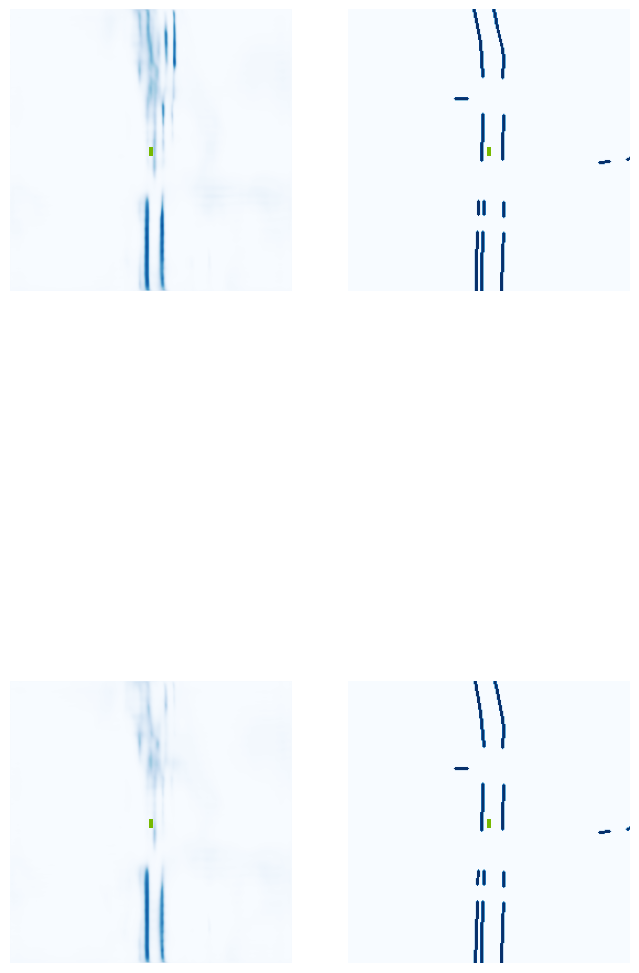

 80%|████████  | 32/40 [00:06<00:01,  4.45it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde477650>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde475df0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15c2020>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15c2020>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5b0770>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5b0770>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde436

 85%|████████▌ | 34/40 [00:07<00:01,  5.80it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2d7d80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2d7d80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5b22f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5b22f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde487920>

 88%|████████▊ | 35/40 [00:07<00:00,  6.24it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5b1490>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde476b10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71ea8e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19cf6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19cf6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde599f80>
In Pillar Features - spatial_features size, whic

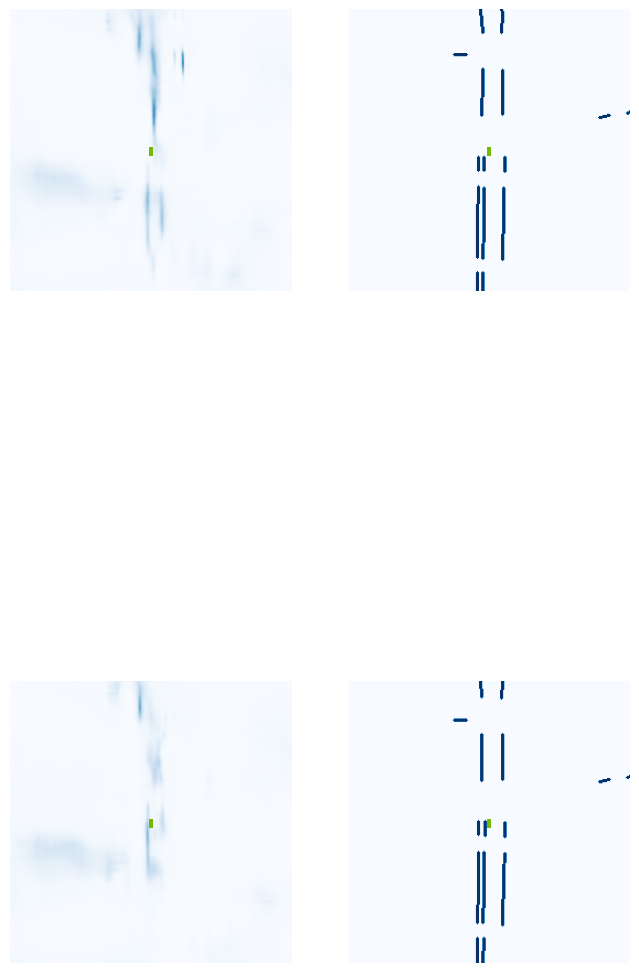

 92%|█████████▎| 37/40 [00:08<00:00,  3.50it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1604130>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe160efc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16057b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16057b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe160cea0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe160cea0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe160e

 98%|█████████▊| 39/40 [00:08<00:00,  4.97it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c7b50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b54ae0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b556c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b545e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b55a30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b54ae0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe15c7b50> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe0b540e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0b551c0>
Forward pass of Block class - 

100%|██████████| 40/40 [00:08<00:00,  4.64it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde346930>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde347e20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde347f60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3462a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3462a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3474c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde763420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde761d50>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde761170>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde761170>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde760450>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde760450>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde763010>
In Pillar Features - spatial_features size, whic

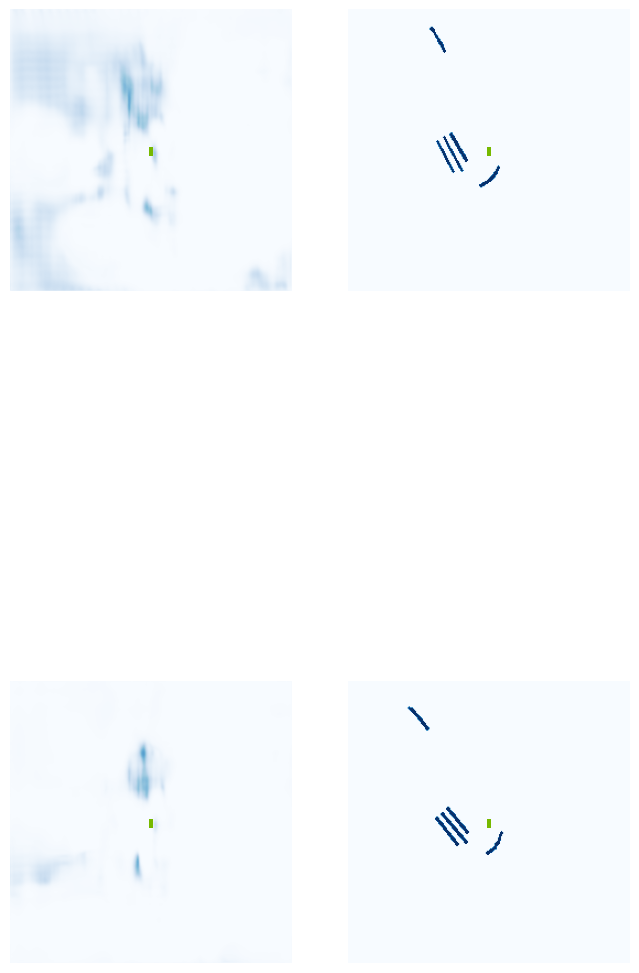

  5%|▌         | 2/40 [00:01<00:19,  1.94it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde48eac0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48d170>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159b150>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159b150>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde48d170>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde48d170>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3c73

 10%|█         | 4/40 [00:01<00:09,  3.86it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe160d030>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe160d030>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde762c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde762c00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe154ce50>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe154ce50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde761620>

 12%|█▎        | 5/40 [00:01<00:07,  4.72it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde761210>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5bf3d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3c76f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3c76f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde762980>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde762980>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2171a0>
In Pillar Features - spatial_features size, whic

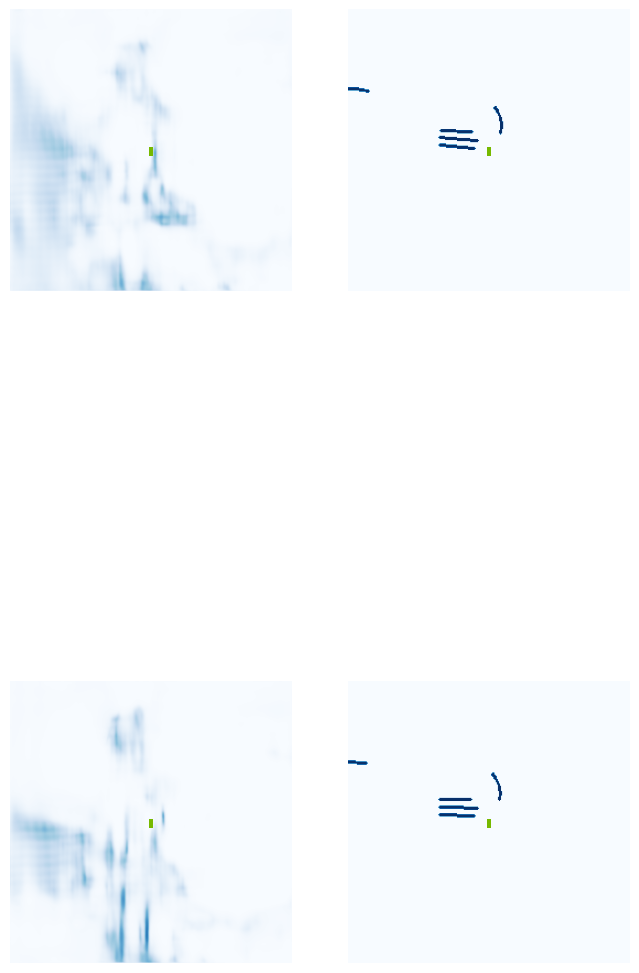

 18%|█▊        | 7/40 [00:02<00:07,  4.30it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b08630>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15c0360>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde720bd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde720bd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde720540>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde720540>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde460e

 22%|██▎       | 9/40 [00:02<00:05,  5.60it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6ad120>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6ad120>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15981d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15981d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde760a90>

 25%|██▌       | 10/40 [00:02<00:04,  6.14it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b0720>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b0630>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde762e30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde762e30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c76f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c76f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3c76f0>
In Pillar Features - spatial_features size, whic

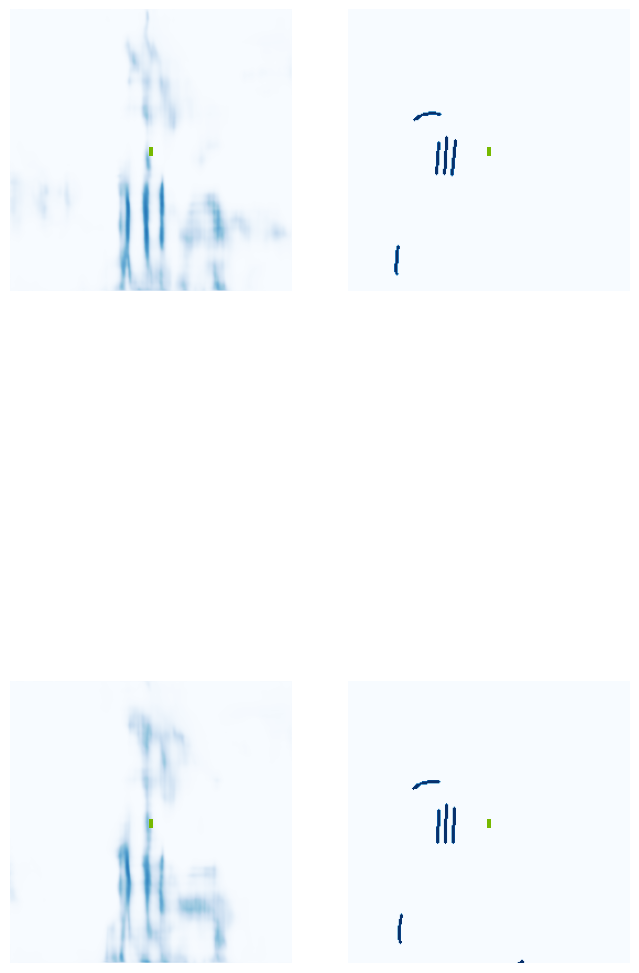

 30%|███       | 12/40 [00:03<00:06,  4.58it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71e83b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde34f1f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe154d2b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe154d2b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae76f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae76f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde579

 35%|███▌      | 14/40 [00:03<00:04,  5.79it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde720450>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde720450>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7627f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde7627f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7470>

 38%|███▊      | 15/40 [00:03<00:04,  6.21it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde337740>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a69da0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a7920>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a7920>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a7740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a7740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde723c40>
In Pillar Features - spatial_features size, whic

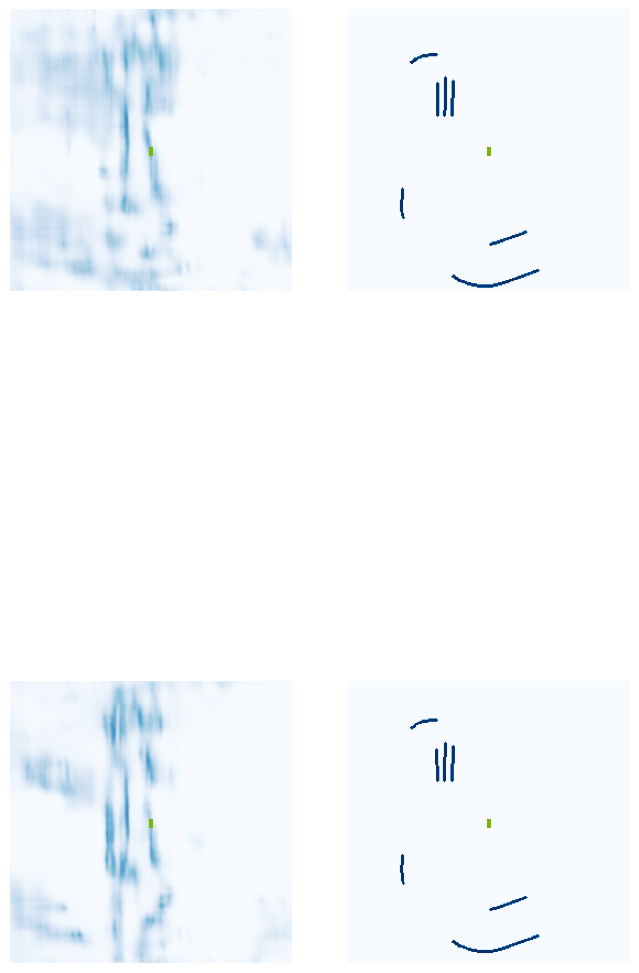

 42%|████▎     | 17/40 [00:04<00:05,  4.60it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde348950>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde441e40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19f9940>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19f9940>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde75ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde75ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde274

 48%|████▊     | 19/40 [00:04<00:03,  5.83it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde522d90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde522d90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4d34c0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde4d34c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a6b10>

 50%|█████     | 20/40 [00:04<00:03,  6.14it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2a7920>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b1530>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3483b0>
In Pillar Features - spatial_features size, whic

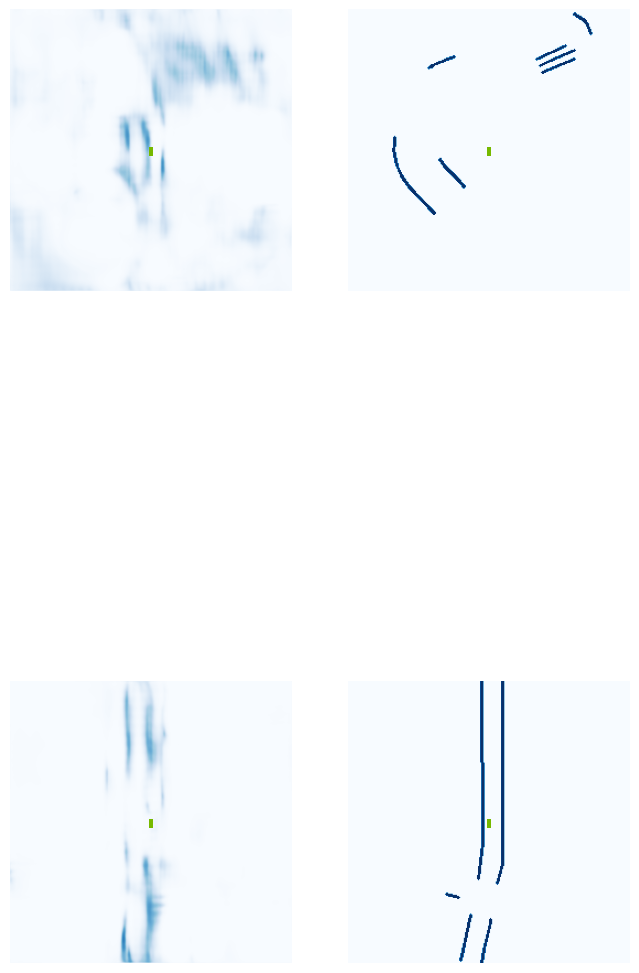

 55%|█████▌    | 22/40 [00:05<00:03,  4.68it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3c58a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde277d30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a7d80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a7d80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a7740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a7740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde300

 60%|██████    | 24/40 [00:05<00:02,  5.94it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a46d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1726a20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a46d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7d80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a46d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7d80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a46d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7d80>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde723ce0> and l

 62%|██████▎   | 25/40 [00:05<00:02,  6.19it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a7330>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a7ce0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a7740>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a7740>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a6b150>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a6b150>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3a7330>
In Pillar Features - spatial_features size, whic

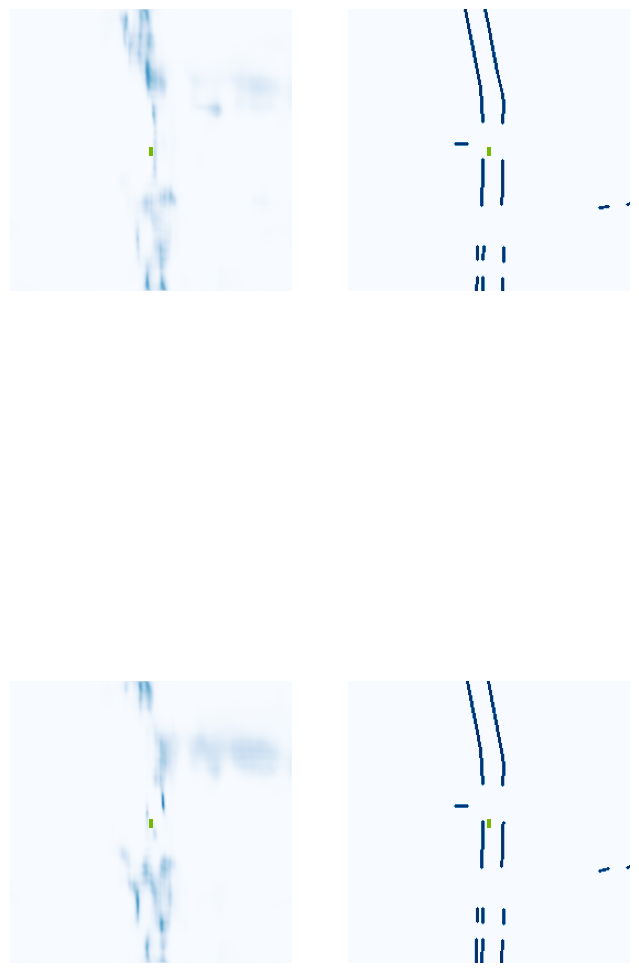

 68%|██████▊   | 27/40 [00:06<00:02,  4.58it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4d2980>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde34f1f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ad2750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ad2750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad1c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad1c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2d7

 72%|███████▎  | 29/40 [00:06<00:01,  5.80it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16c8770>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16c8770>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad0090>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad0090>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b230b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b230b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe157bfb0>

 75%|███████▌  | 30/40 [00:06<00:01,  5.57it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16ca8e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16c8770>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3c4c20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3c4c20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15e2f70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15e2f70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde351170>
In Pillar Features - spatial_features size, whic

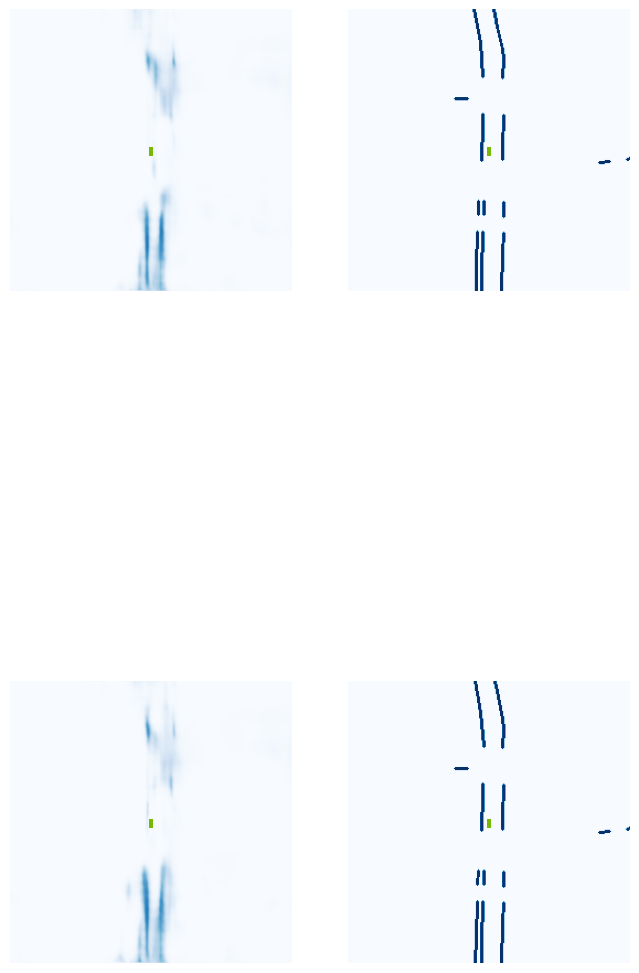

 80%|████████  | 32/40 [00:07<00:01,  4.47it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15e2f70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde57cc20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde46e9d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde46e9d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2d40e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2d40e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad1

 85%|████████▌ | 34/40 [00:07<00:01,  5.71it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe157ba60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe157ba60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4be2a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4be2a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9ca570>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde9ca570>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15810d0>

 88%|████████▊ | 35/40 [00:07<00:00,  6.22it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1580810>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5e4b80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a7d80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a7d80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1580900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1580900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57cc20>
In Pillar Features - spatial_features size, whic

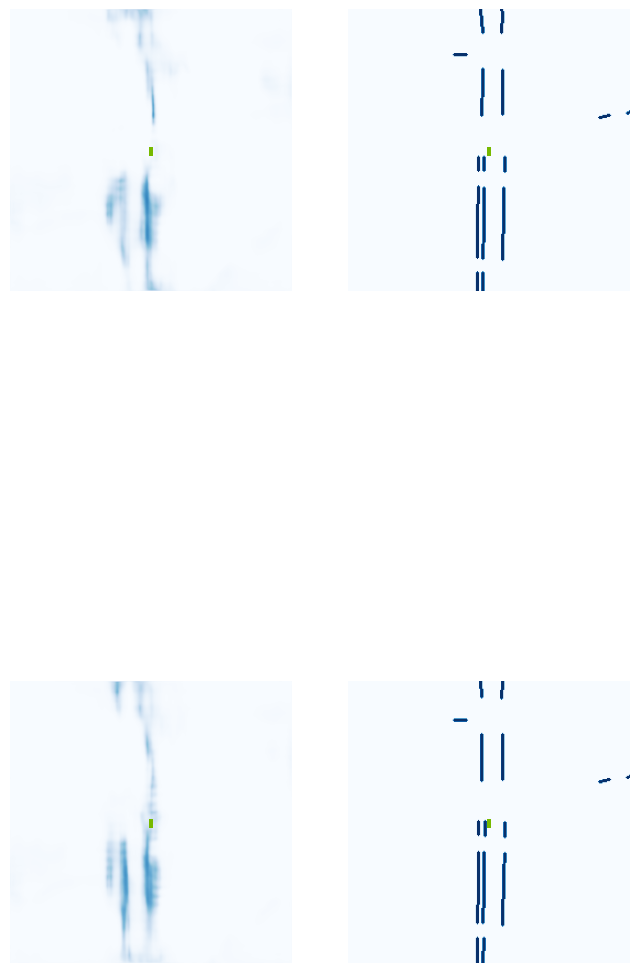

 92%|█████████▎| 37/40 [00:08<00:00,  4.17it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.08.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15829d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4371a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde487ec0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde487ec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad7330>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad7330>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde437

 98%|█████████▊| 39/40 [00:08<00:00,  5.62it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15714e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15714e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde43d9e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde43d9e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad2750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1ad2750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde5eacf0>

100%|██████████| 40/40 [00:08<00:00,  4.63it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe1786070>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1581940>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1581c60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1581fd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1581fd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1582cf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1574950>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15751c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1576b60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1576b60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1574a40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1574a40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15776a0>
In Pillar Features - spatial_features size, whic

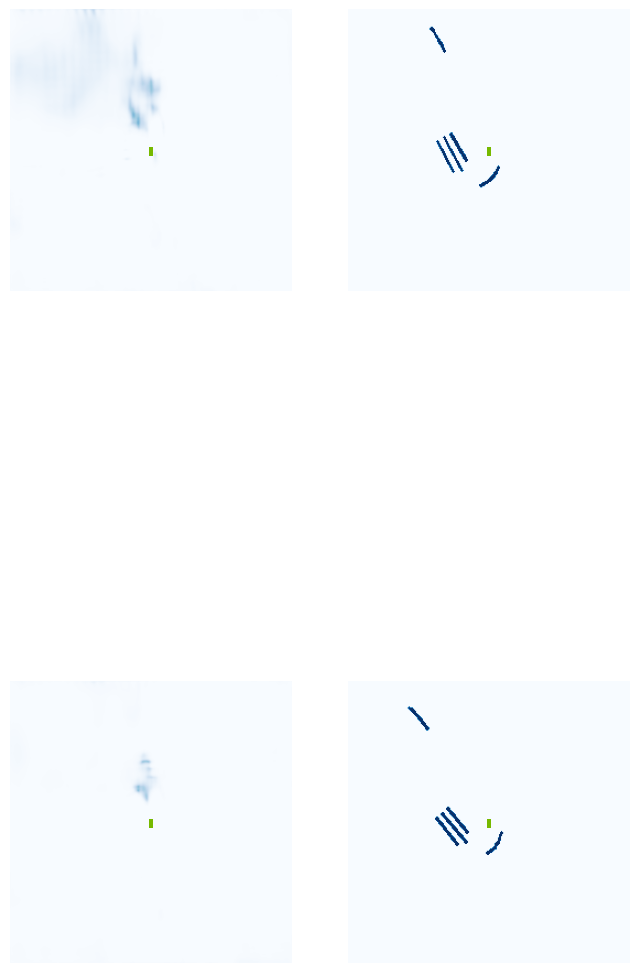

  5%|▌         | 2/40 [00:01<00:19,  1.96it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1575530>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe183a9d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe158ad90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe158ad90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1577dd0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1577dd0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15762

 10%|█         | 4/40 [00:01<00:09,  3.90it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde498cc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde498cc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe158ac50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe158ac50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1576340>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1576340>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4797b0>

 12%|█▎        | 5/40 [00:01<00:07,  4.66it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15758f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15771a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17875b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17875b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1574540>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1574540>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15748b0>
In Pillar Features - spatial_features size, whic

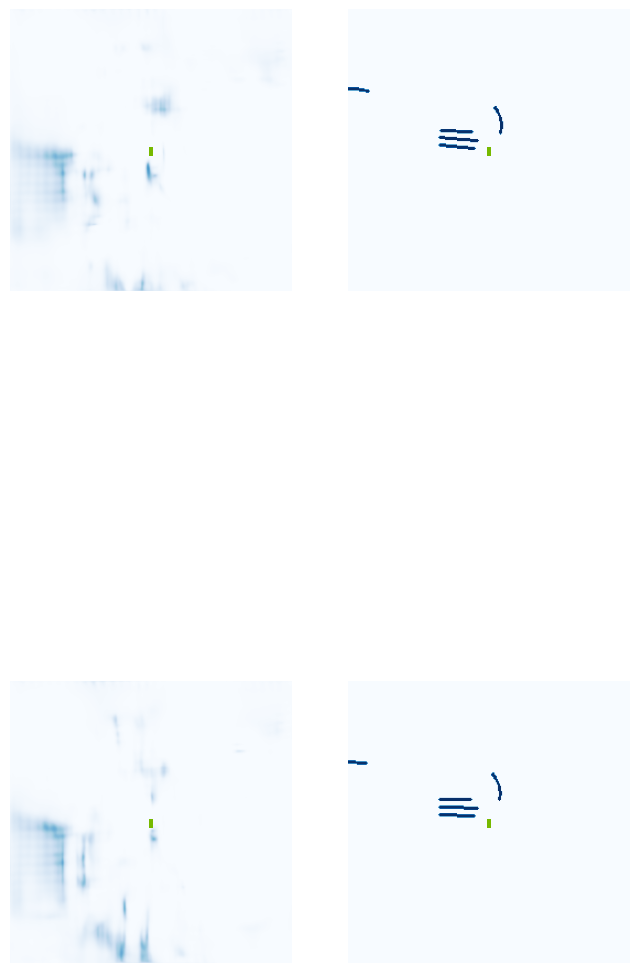

 18%|█▊        | 7/40 [00:02<00:08,  4.11it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1846430>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ad0220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde43f5b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde43f5b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde43cb80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde43cb80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a41c

 22%|██▎       | 9/40 [00:02<00:05,  5.36it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde43e160>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde43e160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1582840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1582840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad53a0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1ad53a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde9c86d0>

 25%|██▌       | 10/40 [00:02<00:05,  5.89it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde43d620>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1577dd0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a43a60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a43a60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe158ac50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe158ac50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ad53a0>
In Pillar Features - spatial_features size, whic

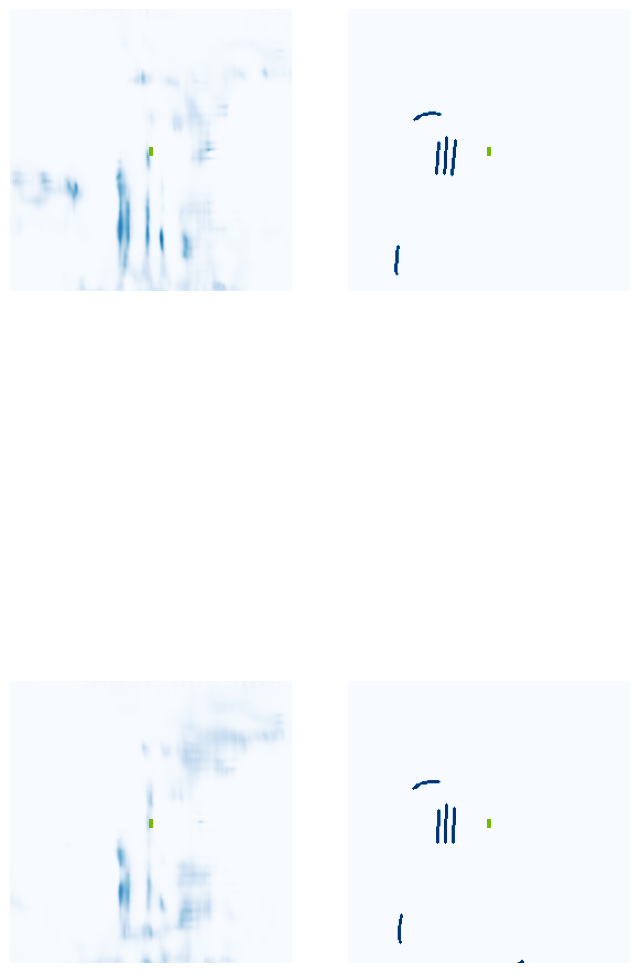

 30%|███       | 12/40 [00:03<00:06,  4.51it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde274040>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9bf970>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3a5990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3a5990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde523a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde523a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3a4

 35%|███▌      | 14/40 [00:03<00:04,  5.68it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5944a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5944a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde596f20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde596f20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde43e160>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde43e160>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde75aed0>

 38%|███▊      | 15/40 [00:03<00:04,  6.14it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19912b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd7006200>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1574540>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1574540>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9ca2f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9ca2f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7f5620>
In Pillar Features - spatial_features size, whic

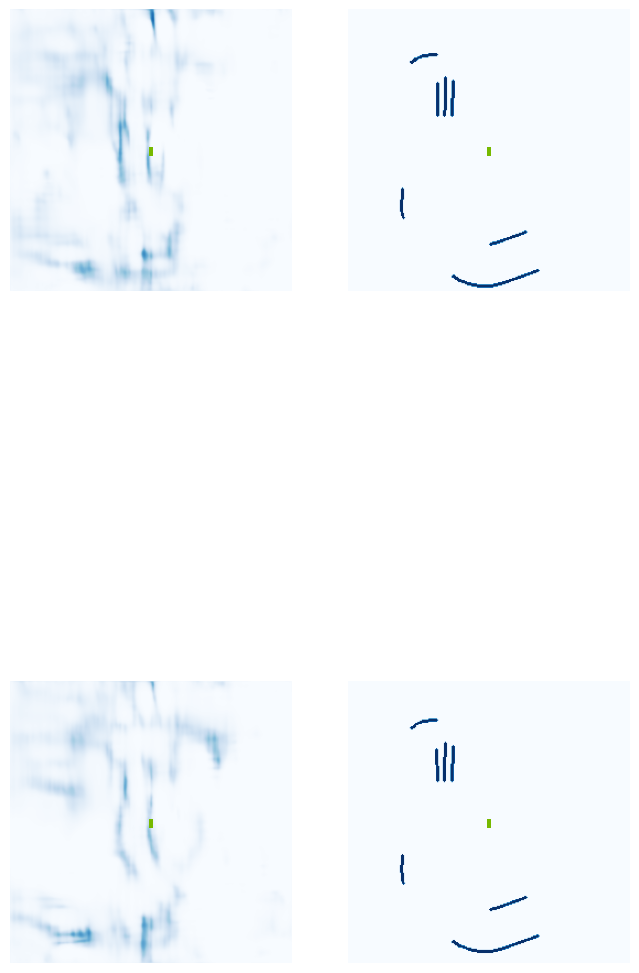

 42%|████▎     | 17/40 [00:04<00:04,  4.65it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0c37b00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3e0bd0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde91c6d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde91c6d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde92b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde92b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde43d

 48%|████▊     | 19/40 [00:04<00:03,  5.81it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe195d3a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7eba128ef0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7eba128ef0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f6250>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f71f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f76f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f6250>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f71f0>
Forwa

 50%|█████     | 20/40 [00:04<00:03,  6.30it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16d83b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16db420>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde596f20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde596f20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde596ca0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde596ca0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9a7600>
In Pillar Features - spatial_features size, whic

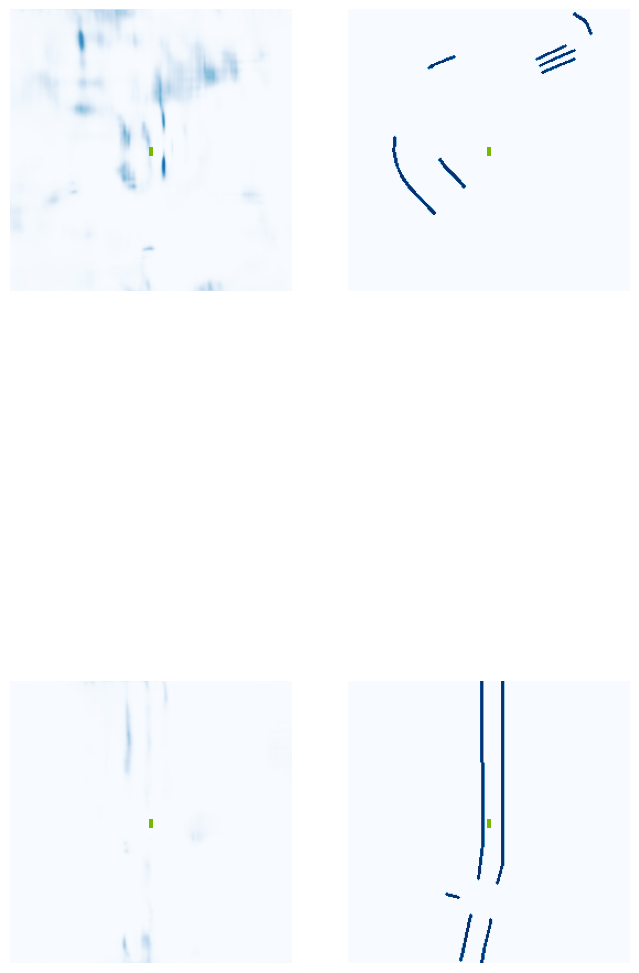

 55%|█████▌    | 22/40 [00:05<00:03,  4.98it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde357d80>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde578220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6ae2a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6ae2a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1547fb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1547fb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde274

 60%|██████    | 24/40 [00:05<00:02,  6.15it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a672e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1606430>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1606ed0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16041d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1605df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607470>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde640630> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe1607470>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1605490>
Forward pass of Block class - 

 62%|██████▎   | 25/40 [00:05<00:02,  6.57it/s]

Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71e8f40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1544900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1544900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71e8f40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71e8f40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde596f20>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde596f20>
Forwar

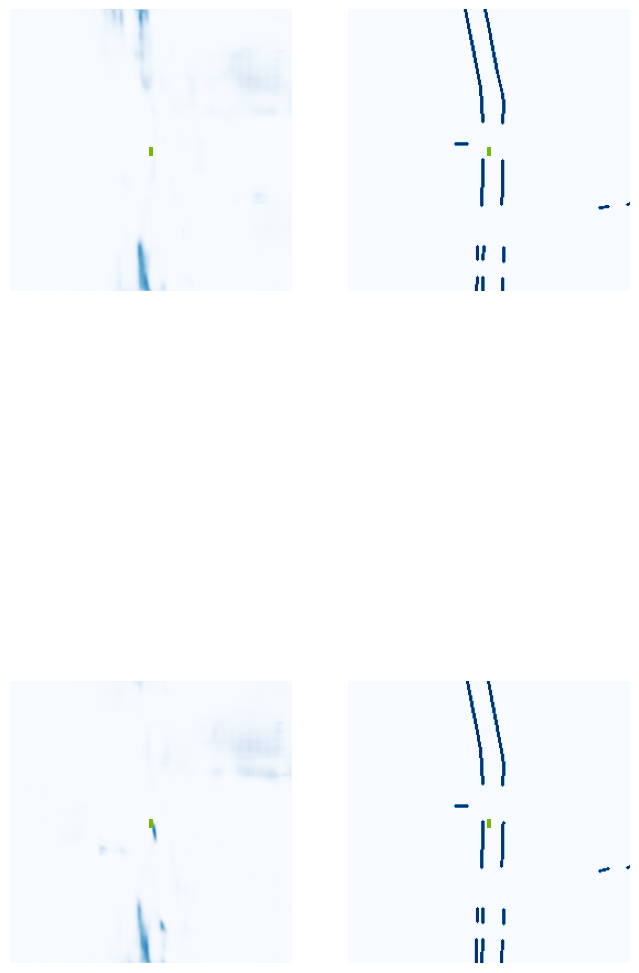

 68%|██████▊   | 27/40 [00:06<00:02,  4.42it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde434ae0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ad6ac0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde578220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde578220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde462cf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde462cf0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b54

 72%|███████▎  | 29/40 [00:06<00:01,  5.70it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde434ae0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde434ae0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde436b60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde436b60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0c17330>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe0c17330>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c2ca0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.20it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a672e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48fce0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5f2750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5f2750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15c3c40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15c3c40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8f4950>
In Pillar Features - spatial_features size, whic

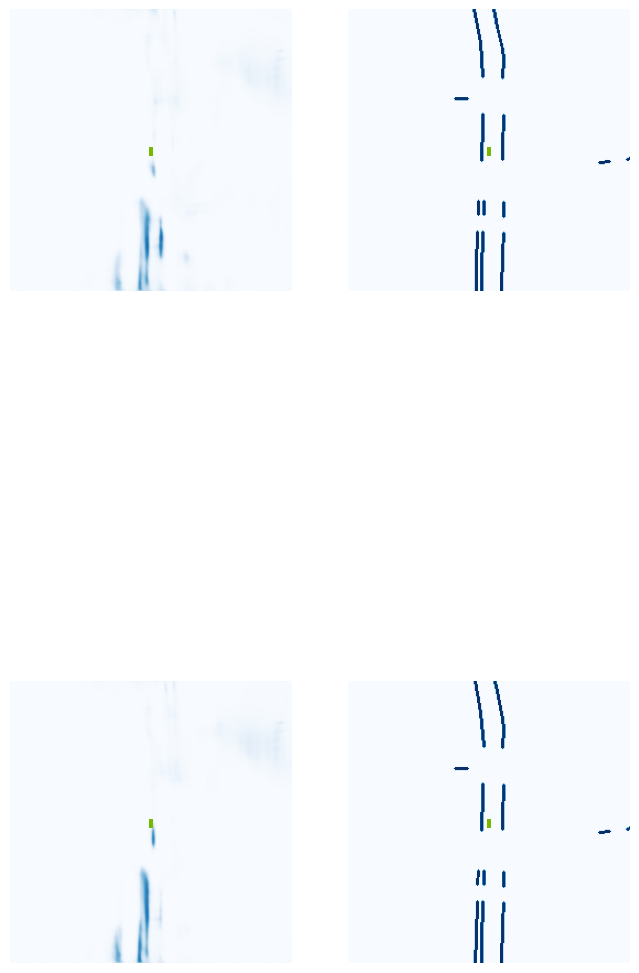

 80%|████████  | 32/40 [00:07<00:01,  4.99it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15c1c60>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9cbbf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15c2660>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15c2660>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde29a6b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde29a6b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1732

 85%|████████▌ | 34/40 [00:07<00:00,  6.31it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c3c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c1c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c3c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c2660>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c3c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c1c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c2660>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c1c60>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1a803b0> and l

 88%|████████▊ | 35/40 [00:07<00:00,  5.67it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde9ca2f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde435c60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9cbbf0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9cbbf0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde436b60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde436b60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16072e0>
In Pillar Features - spatial_features size, whic

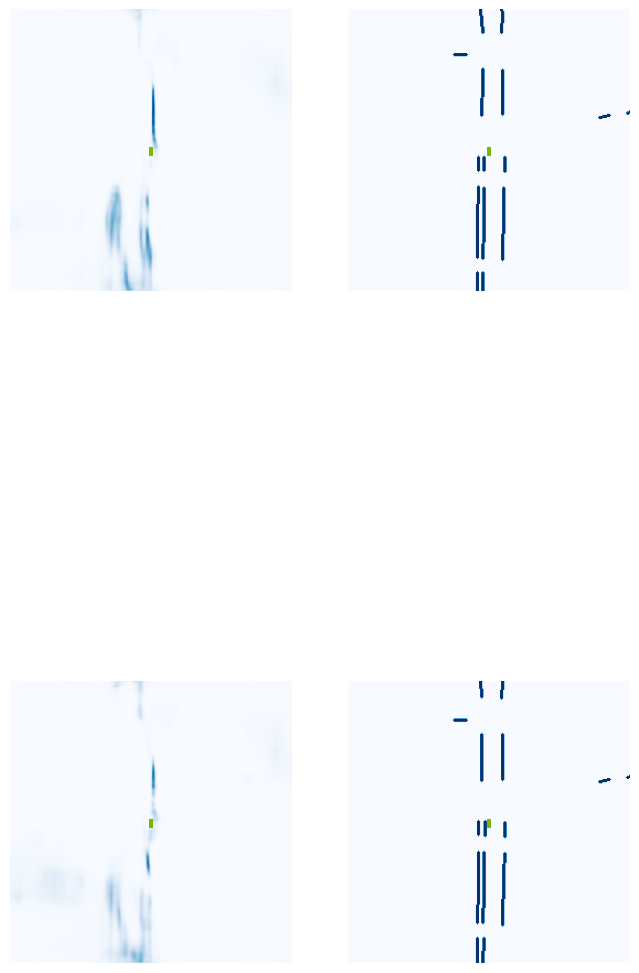

 92%|█████████▎| 37/40 [00:08<00:00,  4.48it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b0220>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde640630>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15c0770>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15c0770>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15ffbf0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15ffbf0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae0

 98%|█████████▊| 39/40 [00:08<00:00,  5.85it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde640630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde640630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15ffec0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15ffec0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae3510>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1ae3510>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a90c20>

100%|██████████| 40/40 [00:08<00:00,  4.71it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe15e5300>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde622160>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde6227a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde621da0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde621da0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde620fe0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1aafa10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1aacc70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1aac900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1aac900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1aae5c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1aae5c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aaf010>
In Pillar Features - spatial_features size, whic

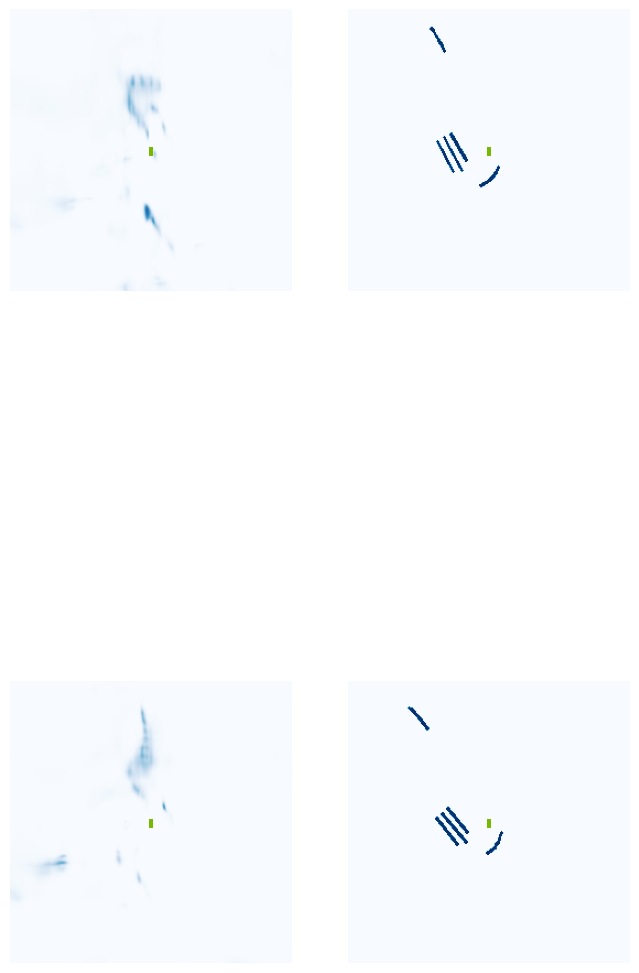

  5%|▌         | 2/40 [00:01<00:19,  1.95it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1aaeb60>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2999e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16caf70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16caf70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1aae200>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1aae200>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3531

 10%|█         | 4/40 [00:01<00:09,  3.87it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b33420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b33420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1aaec00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1aaec00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5bde40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5bde40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15e6fc0>

 12%|█▎        | 5/40 [00:01<00:07,  4.64it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1aac1d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1aace00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2999e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2999e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1aaf6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1aaf6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aac4f0>
In Pillar Features - spatial_features size, whic

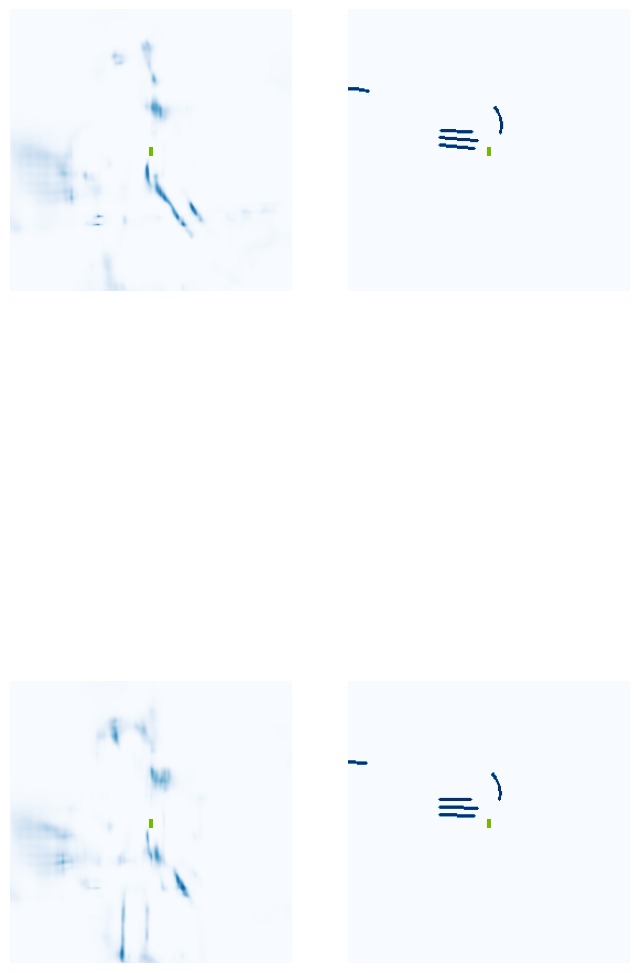

 18%|█▊        | 7/40 [00:02<00:08,  4.06it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b087c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde368400>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde741c10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde741c10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde335990>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde335990>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15e77

 22%|██▎       | 9/40 [00:02<00:05,  5.42it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde335990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde335990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1732c50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1732c50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5981d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5981d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde740220>

 25%|██▌       | 10/40 [00:02<00:05,  5.95it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a81bc0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a81b70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a827f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a827f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5bf790>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5bf790>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde351da0>
In Pillar Features - spatial_features size, whic

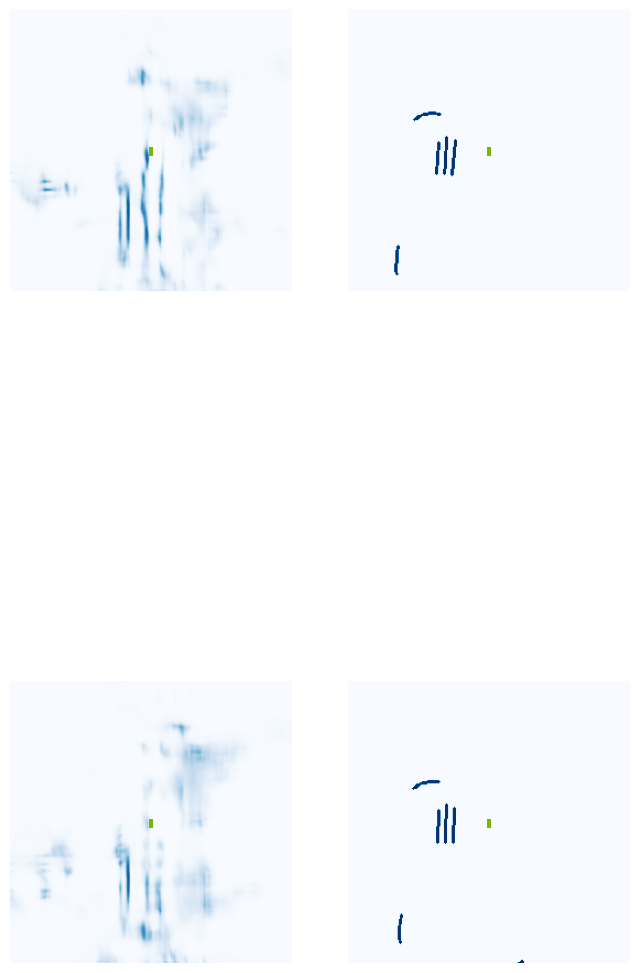

 30%|███       | 12/40 [00:03<00:06,  4.39it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0c55df0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde6f3790>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c56160>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c56160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a7970>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a7970>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3c7

 35%|███▌      | 14/40 [00:03<00:04,  5.70it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a827f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1a827f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde643d30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde441ee0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde643c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde643d30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde440b80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde643c40>
Forward pass of Block class - size

 38%|███▊      | 15/40 [00:03<00:04,  6.25it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde740180>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde741bc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e7600>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e7600>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c56160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c56160>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde442cf0>
In Pillar Features - spatial_features size, whic

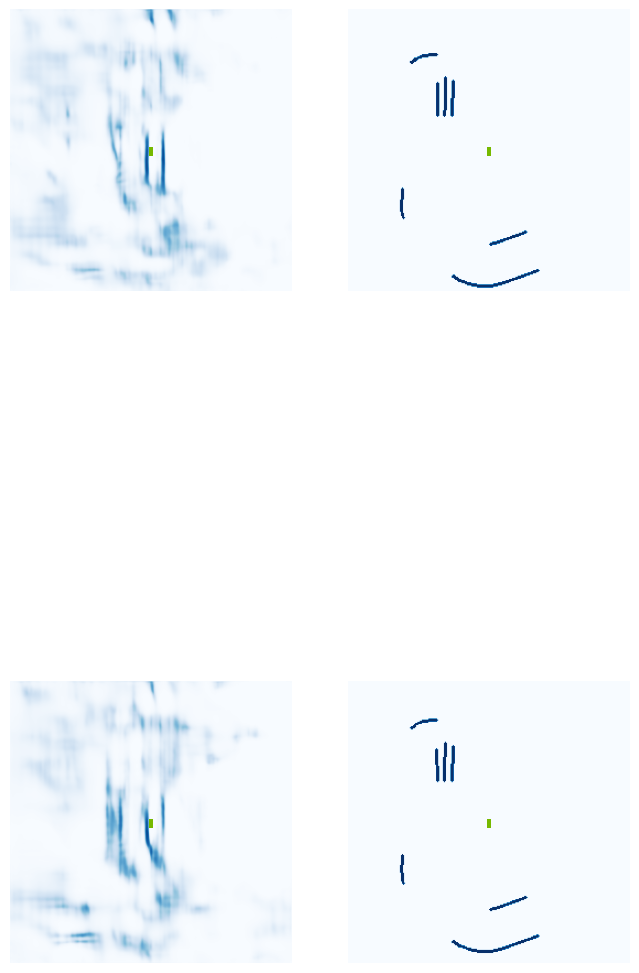

 42%|████▎     | 17/40 [00:04<00:05,  4.56it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5bf790>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde946430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e09a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e09a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1990360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1990360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5f1

 48%|████▊     | 19/40 [00:04<00:03,  5.83it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e2f70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e2f70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe195e750>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe195e750>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3c76a0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde3c76a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7b3f10>

 50%|█████     | 20/40 [00:04<00:03,  6.31it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde442a20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3c6430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde93b1a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde93b1a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde301bc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde301bc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0c56160>
In Pillar Features - spatial_features size, whic

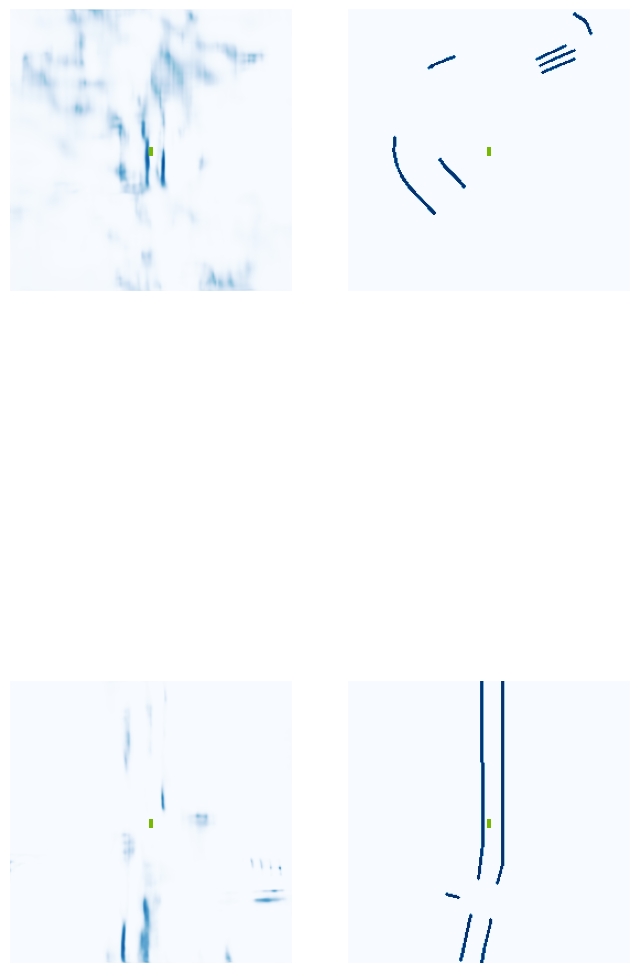

 55%|█████▌    | 22/40 [00:05<00:03,  4.84it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1847880>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15775b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a86430>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a86430>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15775b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15775b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1845

 60%|██████    | 24/40 [00:05<00:02,  6.08it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe159e1b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b22e30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b21670>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe159e1b0> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe1b22a20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b22750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b21b20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b20720>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b238d0>
Forward pass of Block class - 

 62%|██████▎   | 25/40 [00:05<00:02,  6.55it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159c680>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159c680>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159f290>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159f290>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5f1d50>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5f1d50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b238d0>

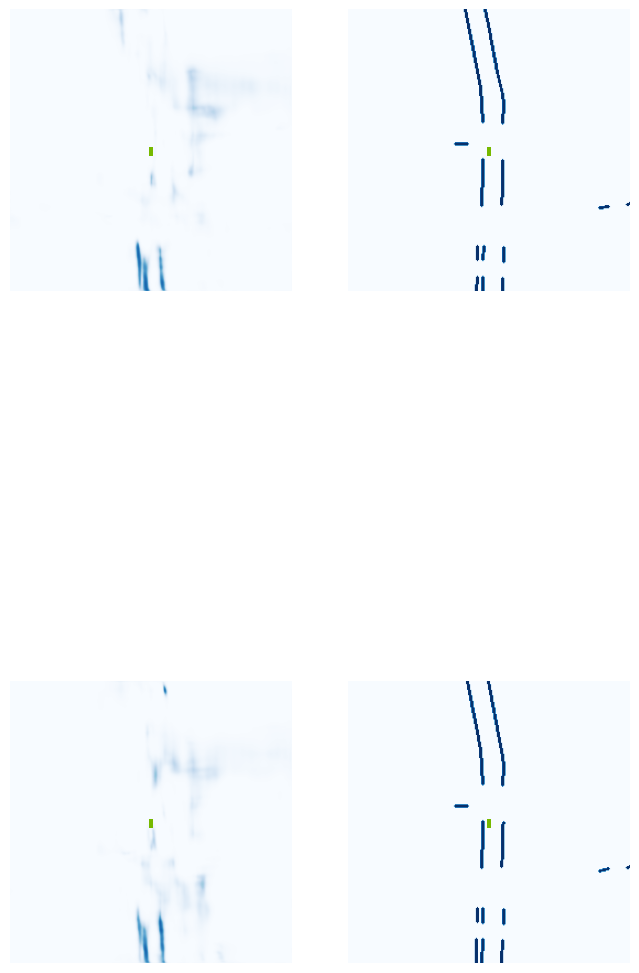

 68%|██████▊   | 27/40 [00:06<00:02,  5.10it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde67a610>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1845df0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16d83b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16d83b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a40360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a40360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde67a

 72%|███████▎  | 29/40 [00:06<00:01,  6.39it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1583420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b20540>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b23010>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1580040>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b21670>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b23fb0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1aac4a0> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe1a43a60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a859e0>
Forward pass of Block class - 

 75%|███████▌  | 30/40 [00:06<00:01,  6.78it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1580040>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1580040>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde351da0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde351da0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde75a7f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde75a7f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15b0bd0>

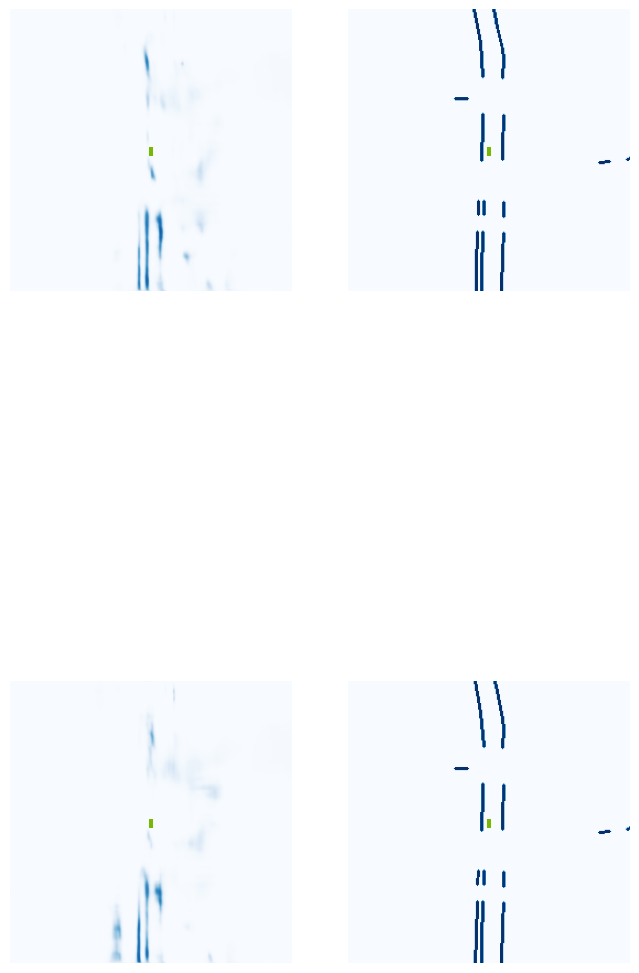

 80%|████████  | 32/40 [00:06<00:01,  5.18it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16daf70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1552a20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a859e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a859e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde865440>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde865440>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1552

 85%|████████▌ | 34/40 [00:07<00:00,  6.32it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1570720>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a42750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1a42750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15893f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158a200>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158ae30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158a610>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15884f0>
Forwa

 88%|████████▊ | 35/40 [00:07<00:00,  6.12it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1589b20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe158ae30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7612b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7612b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1589b20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1589b20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15893f0>
In Pillar Features - spatial_features size, whic

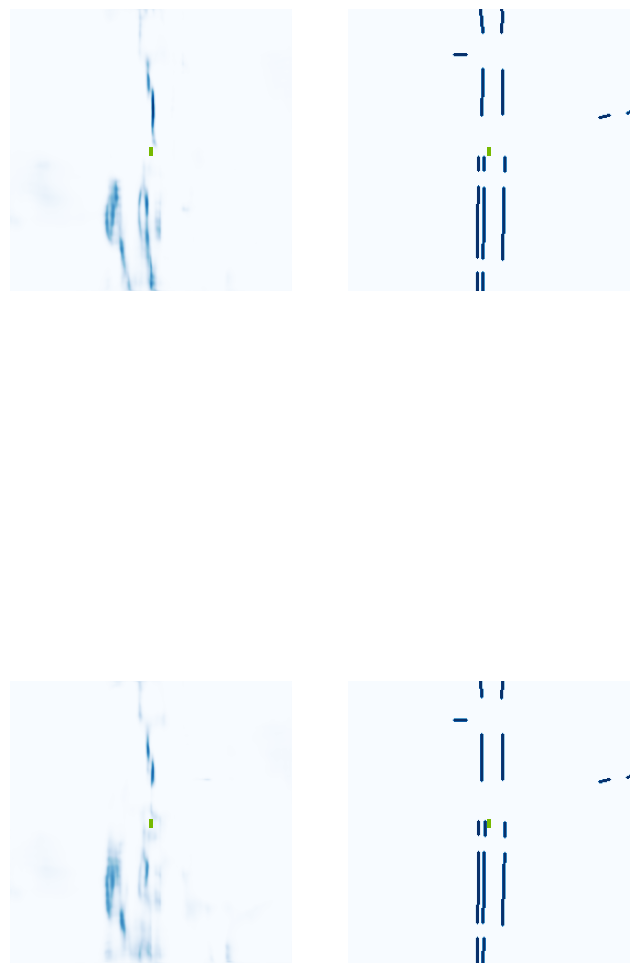

 92%|█████████▎| 37/40 [00:08<00:00,  3.49it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde4b1620>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5f93f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5d1940>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5d1940>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5fba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5fba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b1

 98%|█████████▊| 39/40 [00:08<00:00,  5.00it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde472d90>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1abf0b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1abf0b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde55a6b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde55b510>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde55b240>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde55bb00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde55a7a0>
Forwa

100%|██████████| 40/40 [00:08<00:00,  4.60it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde4adb20>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71e9f30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71e9760>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71e9990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71e9990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71ea020>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15501d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15538d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1553010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1553010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15513f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15513f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1550540>
In Pillar Features - spatial_features size, whic

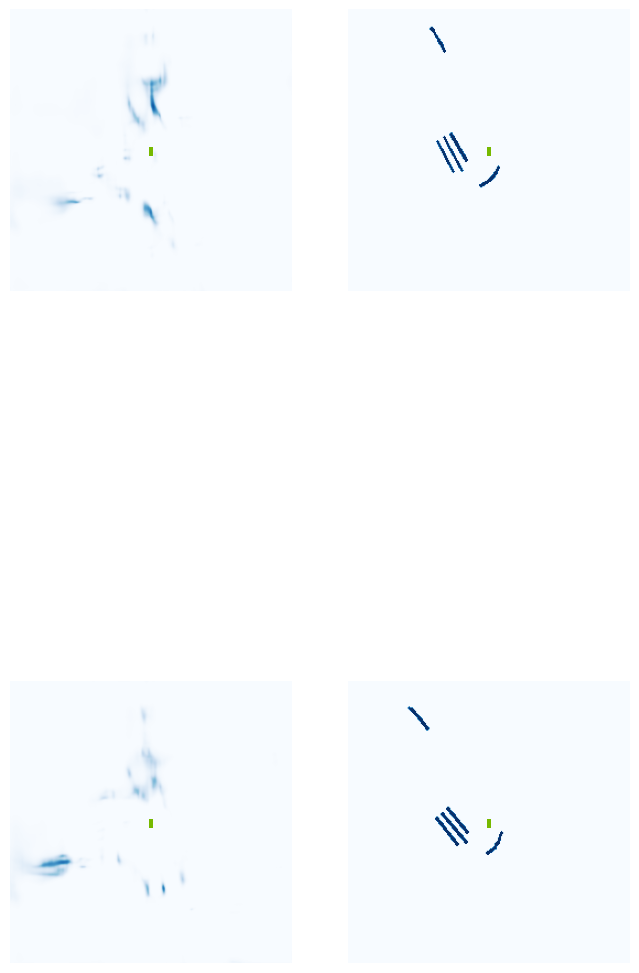

  5%|▌         | 2/40 [00:01<00:19,  1.98it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b56430>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9e4a40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4bf740>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4bf740>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde67ab10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde67ab10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4afd

 10%|█         | 4/40 [00:01<00:08,  4.01it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde67a6b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde67a6b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1551ad0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1551ad0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde458360>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde458360>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1abfd30>

 12%|█▎        | 5/40 [00:01<00:07,  4.90it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1551ad0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1550e50>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6794e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6794e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde67b4c0>
In Pillar Features - spatial_features size, whic

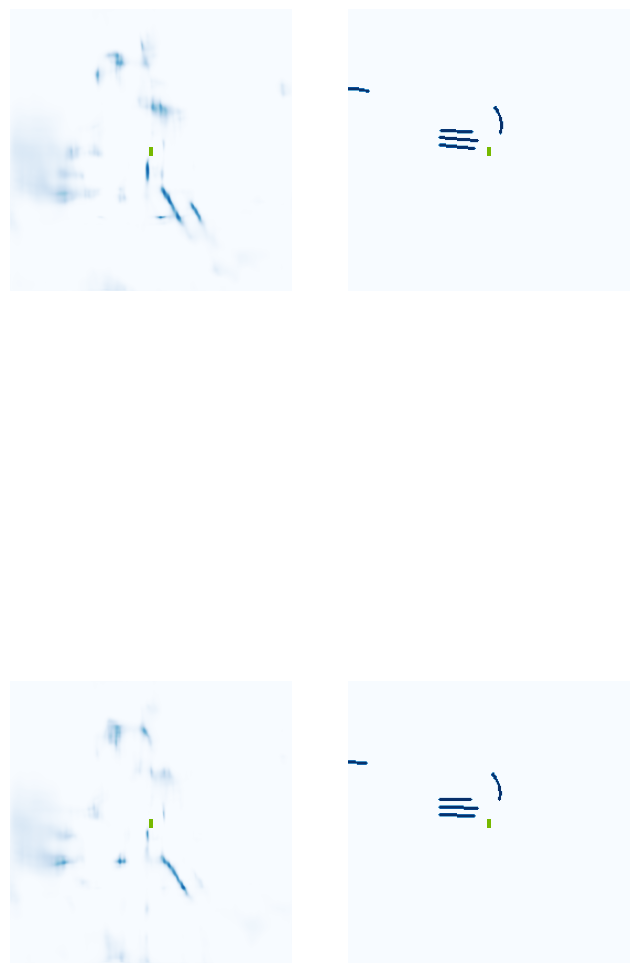

 18%|█▊        | 7/40 [00:02<00:07,  4.45it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1abe390>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde46f880>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde8f6ac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde8f6ac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde57db20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde57db20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1abe3

 22%|██▎       | 9/40 [00:02<00:05,  5.89it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71e8540>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd71e8540>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1544fe0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1544ea0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15468e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15479c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1545300>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1547970>
Forward pass of Block class - size

 25%|██▌       | 10/40 [00:02<00:04,  6.39it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde57db20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde57db20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde57c270>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde57c270>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8f45e0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde8f45e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde434ae0>

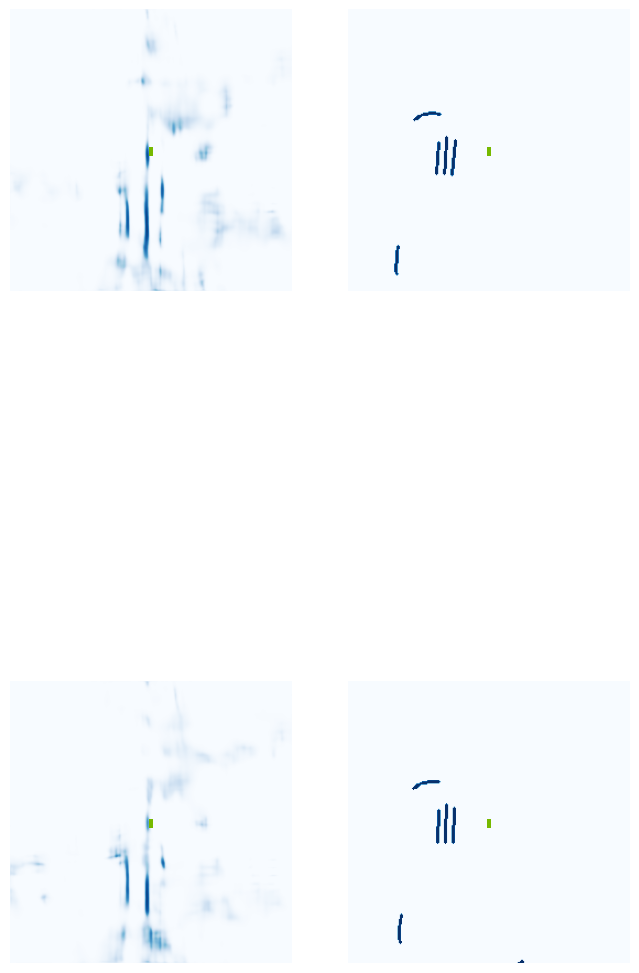

 30%|███       | 12/40 [00:03<00:06,  4.65it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ae07c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde46fec0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a86a70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a86a70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7b0f40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7b0f40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1551

 35%|███▌      | 14/40 [00:03<00:04,  5.93it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde459ee0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde459ee0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde57d7b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde57d7b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1582d90>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1582d90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde890040>

 38%|███▊      | 15/40 [00:03<00:03,  6.37it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde67b8d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4be020>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1551c10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1551c10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1577740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1577740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4be020>
In Pillar Features - spatial_features size, whic

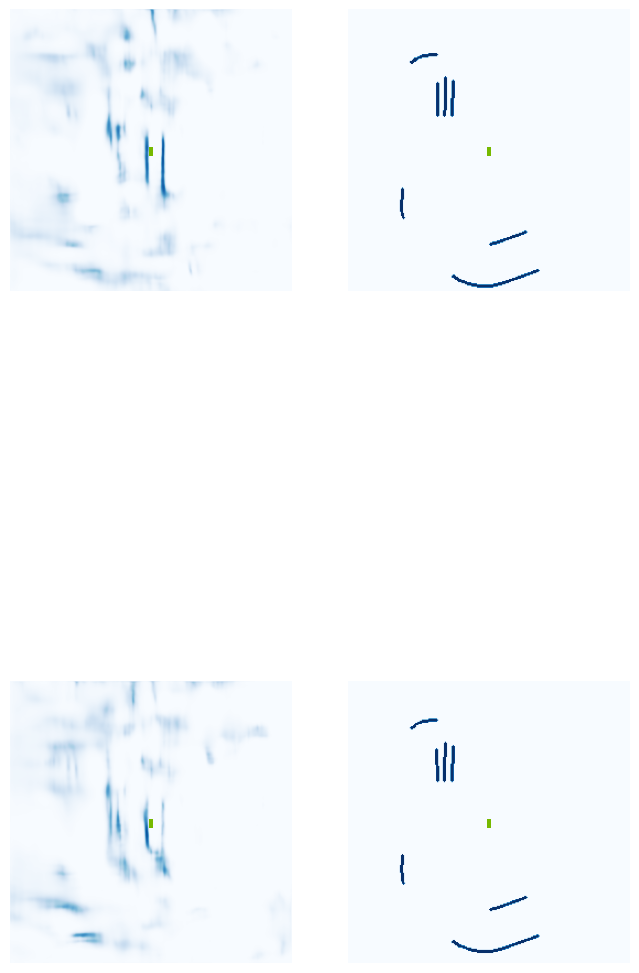

 42%|████▎     | 17/40 [00:03<00:04,  4.91it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde890450>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1abe9d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9ca7f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9ca7f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe195ccc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe195ccc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1551

 48%|████▊     | 19/40 [00:04<00:03,  6.12it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c895d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c8b5b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c89a30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c895d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c8b5b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c893f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c895d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c8b5b0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde890a40> and l

 50%|█████     | 20/40 [00:04<00:03,  6.55it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7b3650>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde300db0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159e1b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159e1b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c893f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c893f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7b3650>
In Pillar Features - spatial_features size, whic

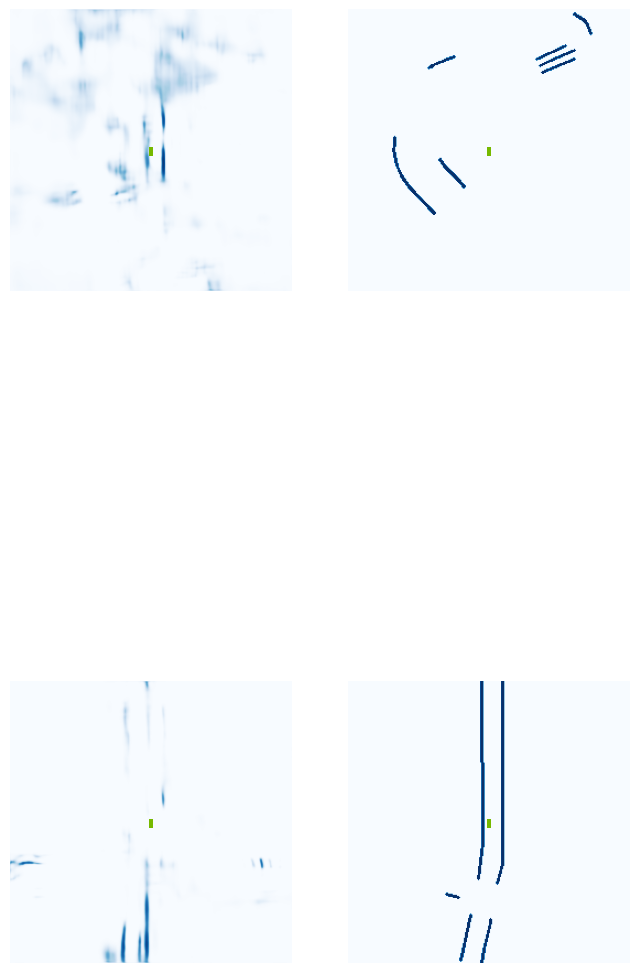

 55%|█████▌    | 22/40 [00:04<00:03,  5.00it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ae3510>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19f89f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9952b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9952b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fb420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fb420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8f6

 60%|██████    | 24/40 [00:05<00:02,  6.15it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad0f40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7ba0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2f8090>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a4cc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7c90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fbd80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a7ba0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2a4cc0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1ad0f40> and l

 62%|██████▎   | 25/40 [00:05<00:02,  6.65it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde9953a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19faf70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15a0bd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15a0bd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9953a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9953a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde463b00>
In Pillar Features - spatial_features size, whic

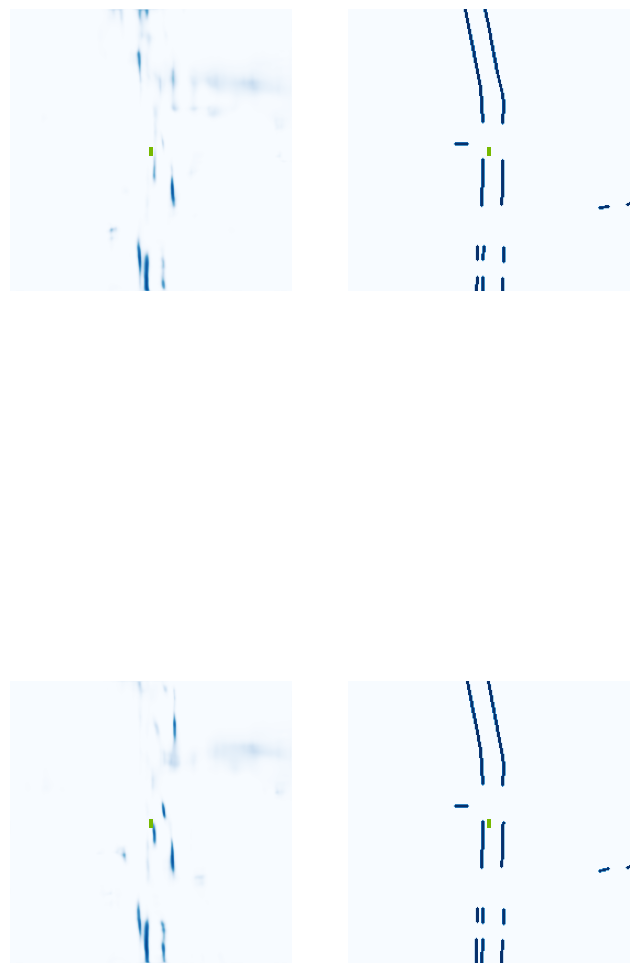

 68%|██████▊   | 27/40 [00:05<00:02,  4.90it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde276570>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15e2c50>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ae79c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ae79c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b0ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b0ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1551

 72%|███████▎  | 29/40 [00:06<00:01,  6.17it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3a76f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3a76f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a59e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a59e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde522890>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde522890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3373d0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.66it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ad1490>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe0d4c040>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19fb420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19fb420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde57ac00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde57ac00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde891210>
In Pillar Features - spatial_features size, whic

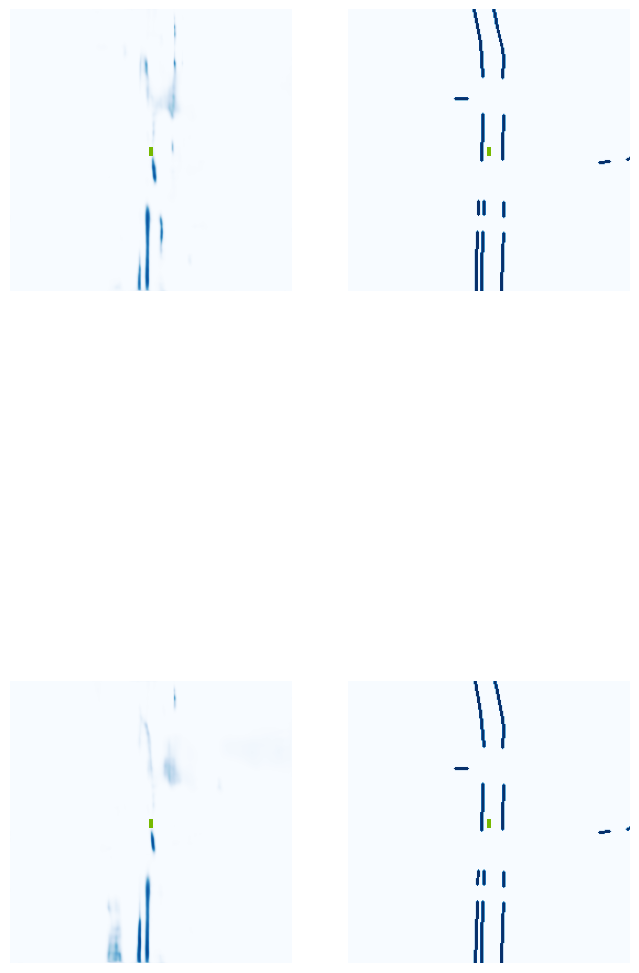

 80%|████████  | 32/40 [00:06<00:01,  4.76it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17332e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48d440>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5b2b10>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5b2b10>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a81c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a81c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1551

 85%|████████▌ | 34/40 [00:07<00:01,  6.00it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde352520>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde352520>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a65bc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a65bc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde334630>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde334630>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16c8900>

 88%|████████▊ | 35/40 [00:07<00:00,  6.01it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5b2b10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17332e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a67ec0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a67ec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde84dda0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde84dda0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7627f0>
In Pillar Features - spatial_features size, whic

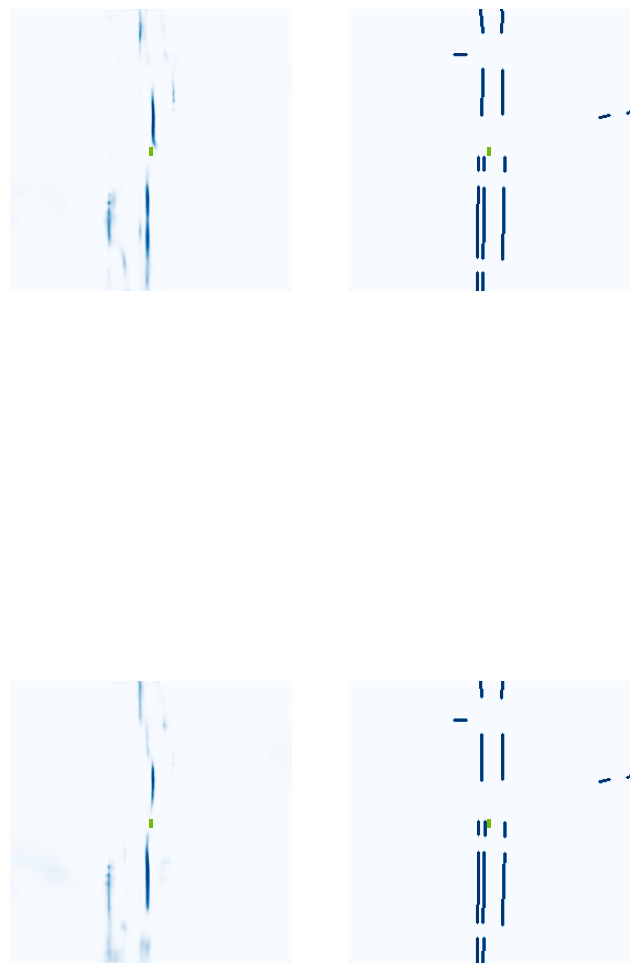

 92%|█████████▎| 37/40 [00:07<00:00,  4.93it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.08.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b0af70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16c9530>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2380e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2380e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde27ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde27ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1732

 95%|█████████▌| 38/40 [00:07<00:00,  5.51it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16ca980>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16ca980>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd714f3d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd714f3d0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd714dbc0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd714dbc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a507c0>

100%|██████████| 40/40 [00:08<00:00,  4.88it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde352520>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a50540>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a503b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a50630>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a508b0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde238770> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe1a51490>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a50950>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a50180>
Forward pass of Block class - 

Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe17869d0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16e9760>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16e8f90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16e8720>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16e8720>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16e9b70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd7068220>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd706ab10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde23b600>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde23b600>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd7068400>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd7068400>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd7069850>
In Pillar Features - spatial_features size, whic

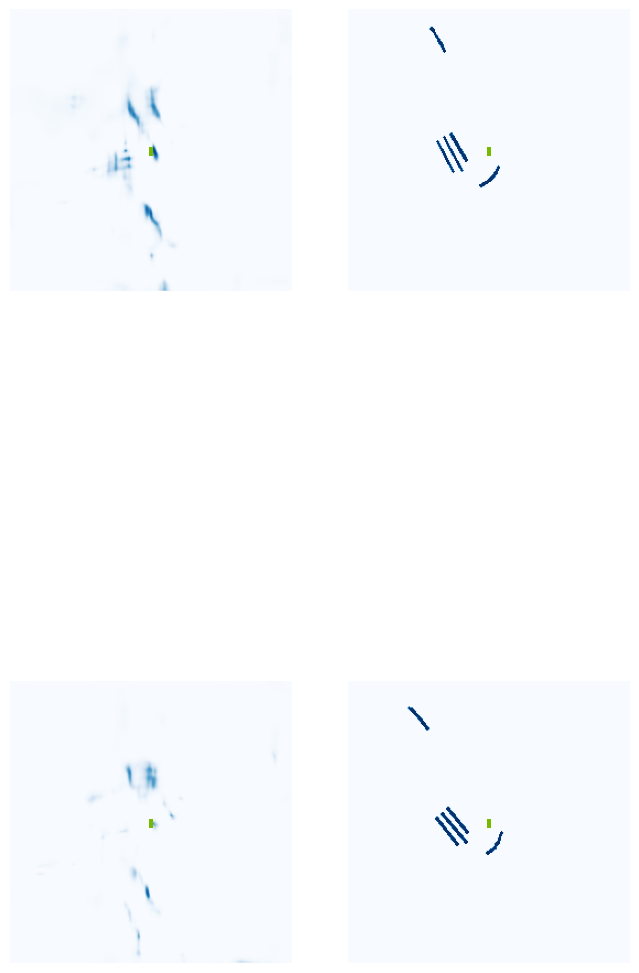

  5%|▌         | 2/40 [00:01<00:18,  2.06it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd70487c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd711ab10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde620220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde620220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd706b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd706b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde299c

 10%|█         | 4/40 [00:01<00:08,  4.09it/s]

In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe17ea7f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd706af70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7069580>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd706aac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd706b0b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7068f40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd706af70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd706bba0>
Forward pass of Block class - size of tensor returned:<built-i

 12%|█▎        | 5/40 [00:01<00:07,  4.85it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd706bba0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2388b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1785760>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1785760>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1787740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1787740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17ea7f0>
In Pillar Features - spatial_features size, whic

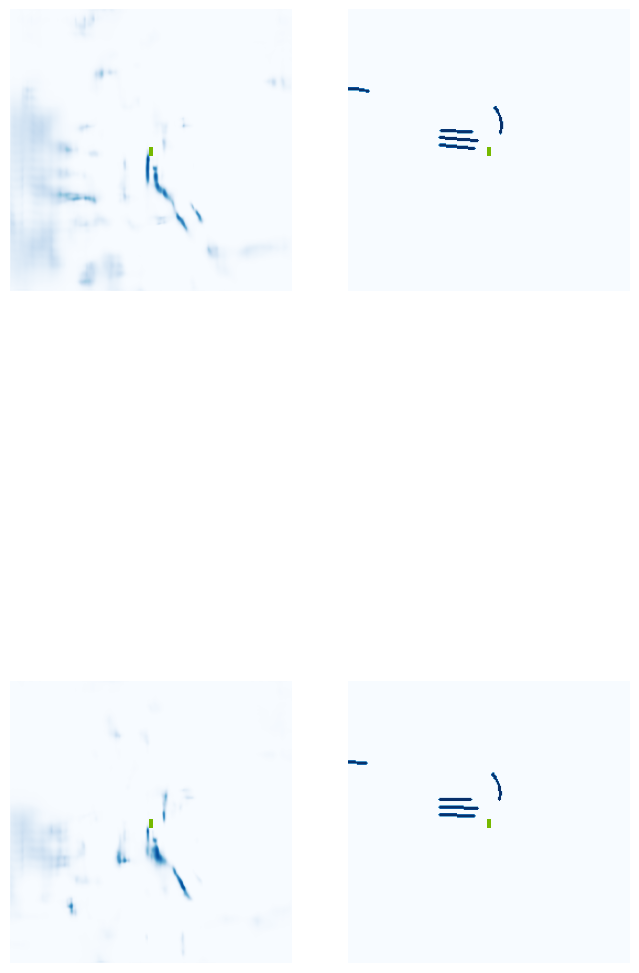

 18%|█▊        | 7/40 [00:02<00:07,  4.42it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a82b10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a67b00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd706aac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd706aac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5b3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5b3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde6421

 22%|██▎       | 9/40 [00:02<00:05,  5.75it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd706aac0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd706aac0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd706bba0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd706bba0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae6340>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1ae6340>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3c66b0>

 25%|██▌       | 10/40 [00:02<00:04,  6.32it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17071a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd706b0b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17ea7f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17ea7f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd706ade0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd706ade0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde29ae30>
In Pillar Features - spatial_features size, whic

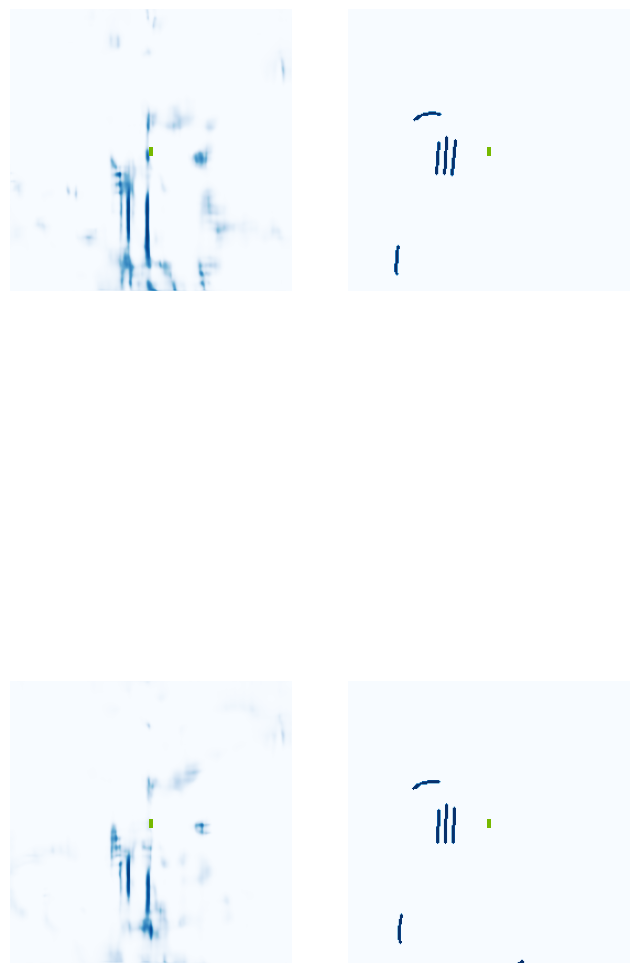

 30%|███       | 12/40 [00:02<00:05,  4.96it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde274680>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ae40e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd706af70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd706af70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5b1490>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5b1490>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde641

 35%|███▌      | 14/40 [00:03<00:04,  6.21it/s]

In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde27aac0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde27aac0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde34d030>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde34d030>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2df4c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde276f70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde275df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor objec

 38%|███▊      | 15/40 [00:03<00:03,  6.70it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde27aac0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde27a840>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4419e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4419e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a83010>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a83010>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde27a840>
In Pillar Features - spatial_features size, whic

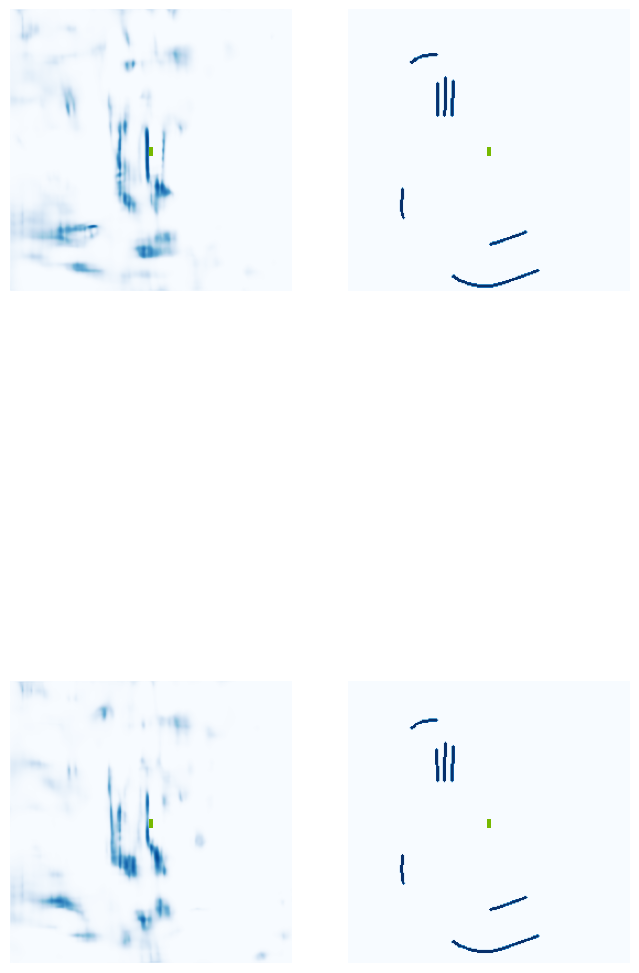

 42%|████▎     | 17/40 [00:03<00:04,  4.98it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a83290>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7f57b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c371a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c371a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad1c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad1c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde70f

 48%|████▊     | 19/40 [00:04<00:03,  6.33it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158d260>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158c130>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158f790>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158d710>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158e2a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158d260>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158f790>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158d710>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe158d710> and l

 50%|█████     | 20/40 [00:04<00:03,  6.62it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2dfec0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2dfec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a83010>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a83010>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2df4c0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2df4c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe158c8b0>

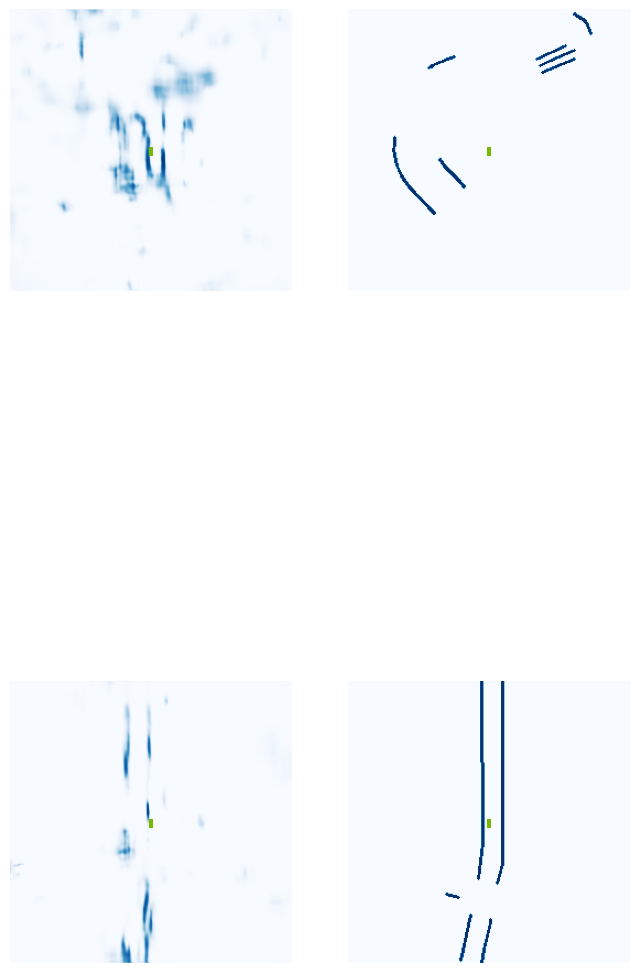

 55%|█████▌    | 22/40 [00:04<00:03,  4.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1605a80>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde6419e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde460770>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde460770>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde70f6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde70f6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1574

 60%|██████    | 24/40 [00:05<00:02,  6.06it/s]

In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1605a80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1547ab0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1545df0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15475b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1544fe0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1544c20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1547c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1547ab0>
Forward pass of Block class - size of tensor returned:<built-i

 62%|██████▎   | 25/40 [00:05<00:02,  6.62it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe195c310>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde440680>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe183a840>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe183a840>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159e3e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159e3e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7f57b0>
In Pillar Features - spatial_features size, whic

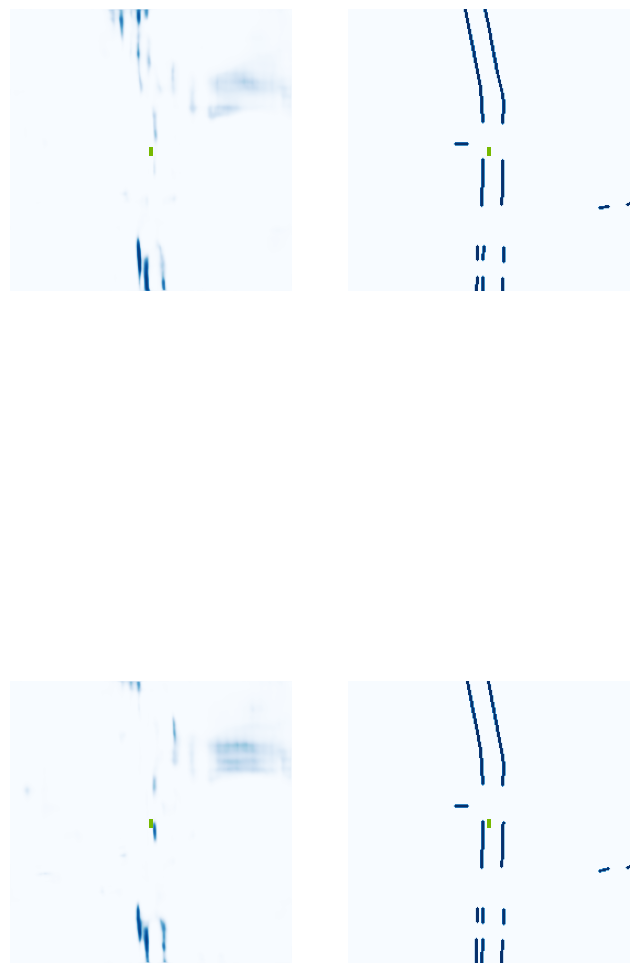

 68%|██████▊   | 27/40 [00:05<00:02,  4.97it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde458220>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde29b150>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a67010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a67010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b56430>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b56430>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde29b

 72%|███████▎  | 29/40 [00:06<00:01,  6.15it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159ea20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159ea20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1576610>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1576610>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159e3e0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159e3e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e30b0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.61it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1574270>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde356ac0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde29be70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde29be70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde45ae30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde45ae30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe187b1a0>
In Pillar Features - spatial_features size, whic

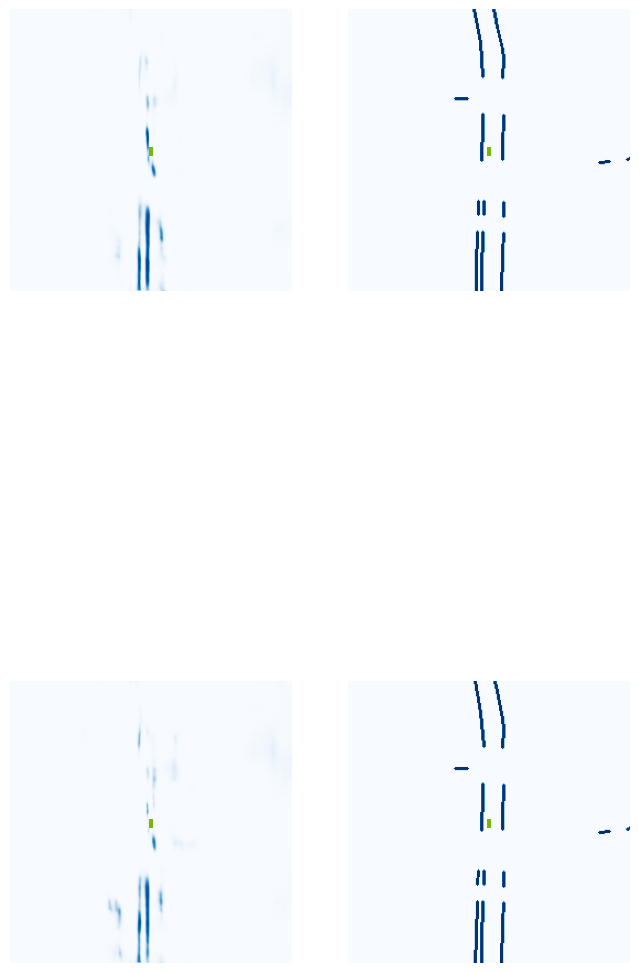

 80%|████████  | 32/40 [00:06<00:01,  4.92it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15e0bd0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde78cc20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a87970>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a87970>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe155ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe155ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde348

 85%|████████▌ | 34/40 [00:06<00:00,  6.07it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a51bc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a51bc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1733060>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1733060>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1704bd0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1704bd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3443b0>

 88%|████████▊ | 35/40 [00:07<00:00,  6.27it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde78eb60>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde29b150>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a503b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a503b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a51a30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a51a30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15993a0>
In Pillar Features - spatial_features size, whic

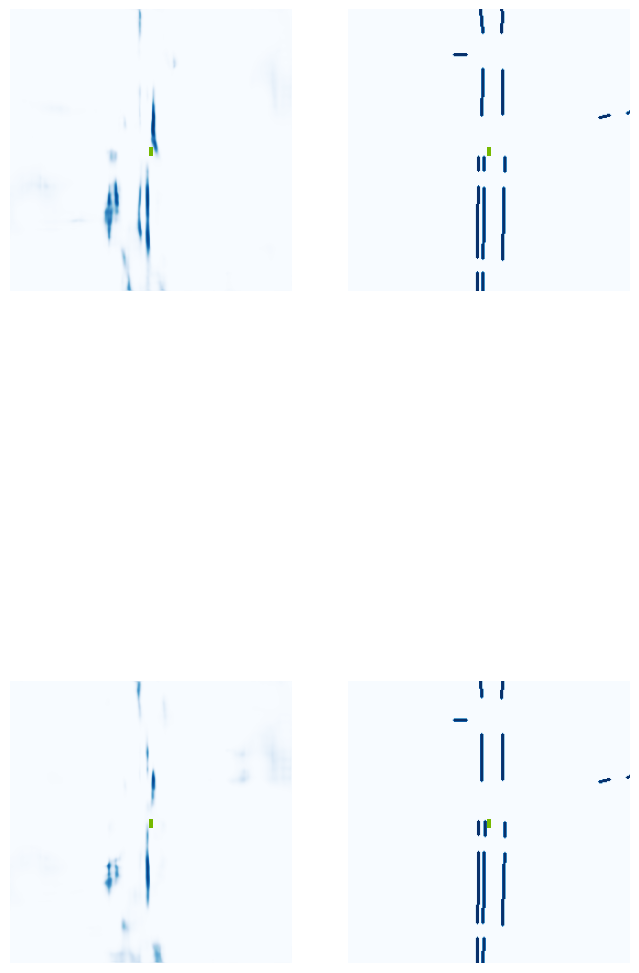

 92%|█████████▎| 37/40 [00:07<00:00,  4.58it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.09.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde298360>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1838630>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e7970>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e7970>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe158e

 98%|█████████▊| 39/40 [00:07<00:00,  5.88it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe158ede0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe158ede0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1838630>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1838630>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde23a890>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde23a890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15e7bf0>

100%|██████████| 40/40 [00:08<00:00,  4.94it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe1614c70>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15fc130>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15ffb50>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15ffa60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15ffa60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15ff740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19dd940>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19dea70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19dc860>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19dc860>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19df740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19df740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19ddee0>
In Pillar Features - spatial_features size, whic

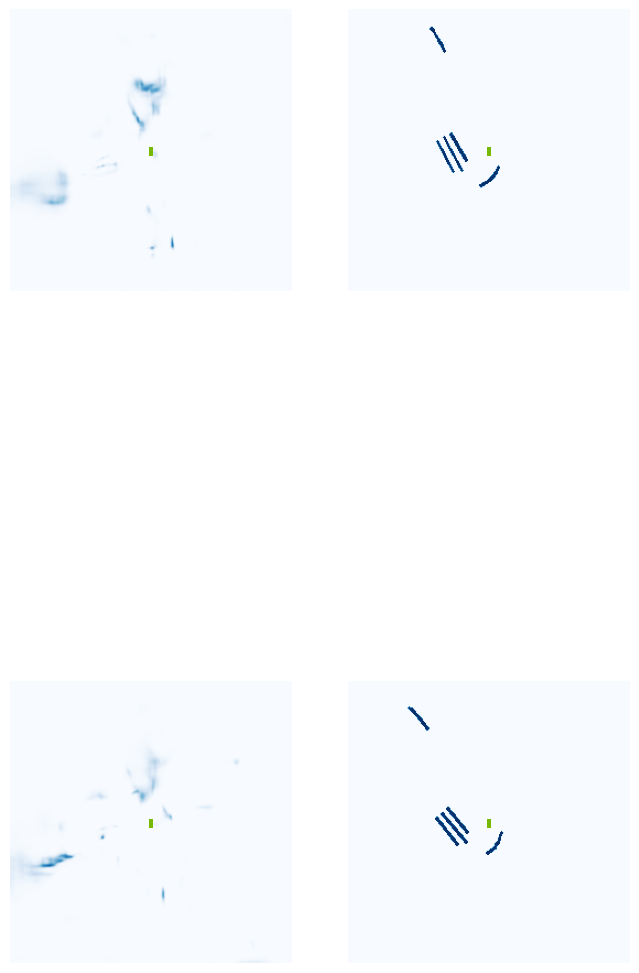

  5%|▌         | 2/40 [00:01<00:18,  2.06it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b2fc0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1617380>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde347ec0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde347ec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5d1300>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5d1300>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe181c2

 10%|█         | 4/40 [00:01<00:08,  4.04it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe181ce00>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe181ce00>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19dd2b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19dd2b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15fcbd0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15fcbd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19df5b0>

 12%|█▎        | 5/40 [00:01<00:07,  4.91it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe181ce00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15fdf80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1aaed90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1aaed90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19df6a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19df6a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15ff970>
In Pillar Features - spatial_features size, whic

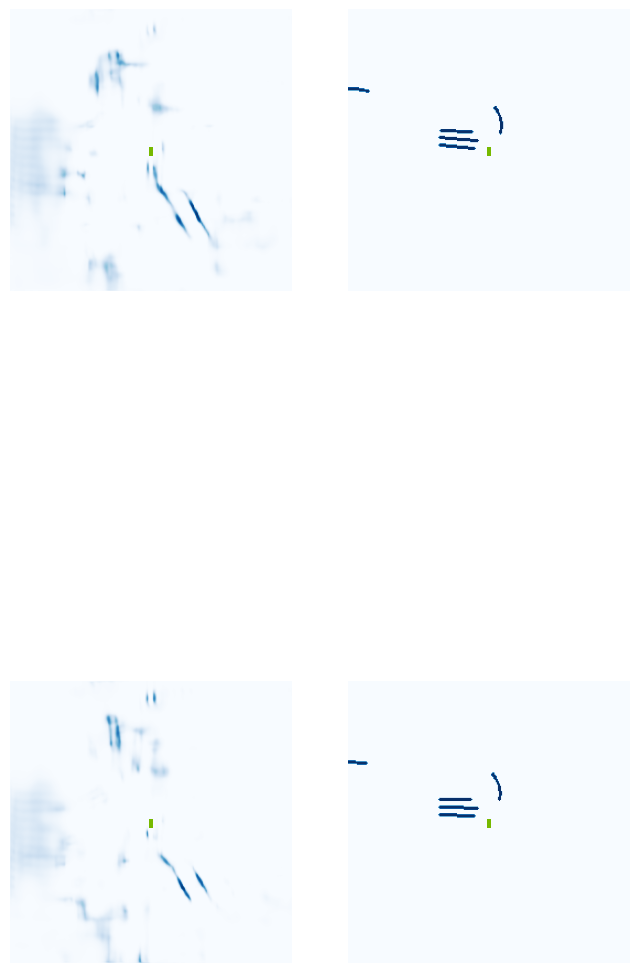

 18%|█▊        | 7/40 [00:02<00:07,  4.48it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1727fb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1725c60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19dc860>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19dc860>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1732110>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1732110>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19ddd

 22%|██▎       | 9/40 [00:02<00:05,  5.86it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aacf40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e0810>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aacf40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e02c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1551a30>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1551a30> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fde344fe0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e1b70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e0090>
Forward pass of Block class - 

 25%|██▌       | 10/40 [00:02<00:04,  6.31it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1727740>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1725a80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15538d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15538d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1730bd0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1730bd0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1551a30>
In Pillar Features - spatial_features size, whic

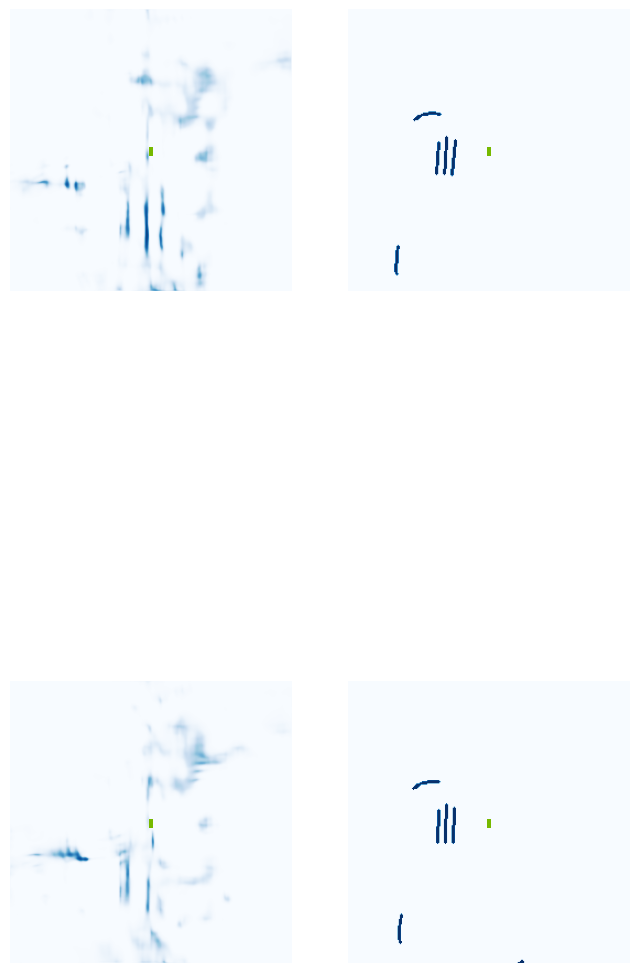

 30%|███       | 12/40 [00:02<00:05,  4.97it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15fd670>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde437bf0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15fd300>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15fd300>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1725a80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1725a80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87bc

 35%|███▌      | 14/40 [00:03<00:04,  6.17it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e3150>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607ec0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607c40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1604130>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1606e30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607bf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607ec0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1604130>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe0b54ae0> and l

 38%|███▊      | 15/40 [00:03<00:03,  6.58it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b54e00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe0b54ae0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde8f7970>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde8f7970>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b54ae0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b54ae0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b08770>
In Pillar Features - spatial_features size, whic

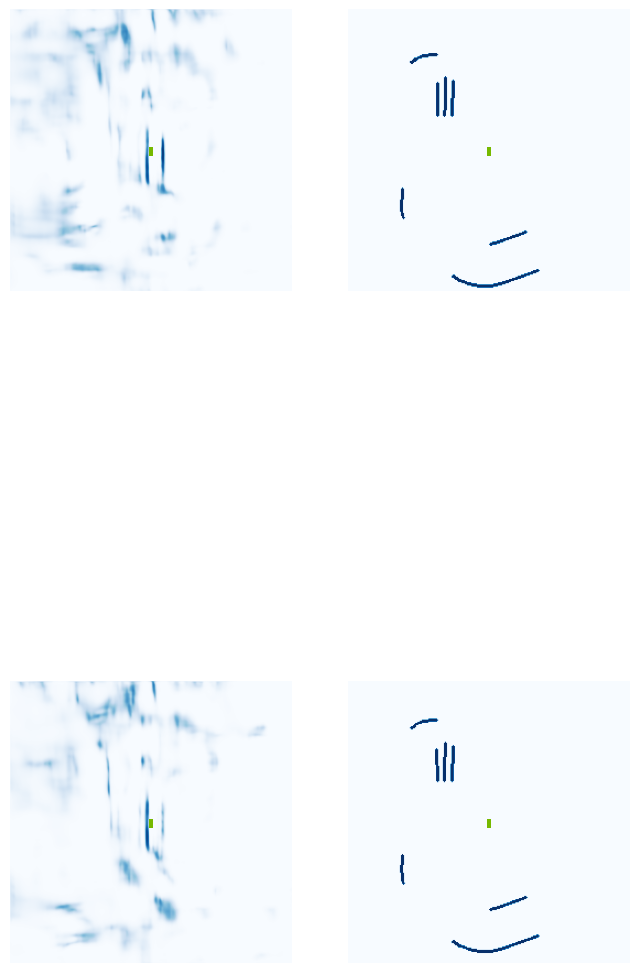

 42%|████▎     | 17/40 [00:03<00:04,  4.92it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159ea20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19ce430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9bf380>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9bf380>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1725a80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1725a80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1

 48%|████▊     | 19/40 [00:04<00:03,  6.12it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde903240>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde903240>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15776f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15776f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde761080>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde761080>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde70ed40>

 50%|█████     | 20/40 [00:04<00:03,  6.49it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde70e660>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde436f70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde57bce0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde57bce0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15776f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15776f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1552d90>
In Pillar Features - spatial_features size, whic

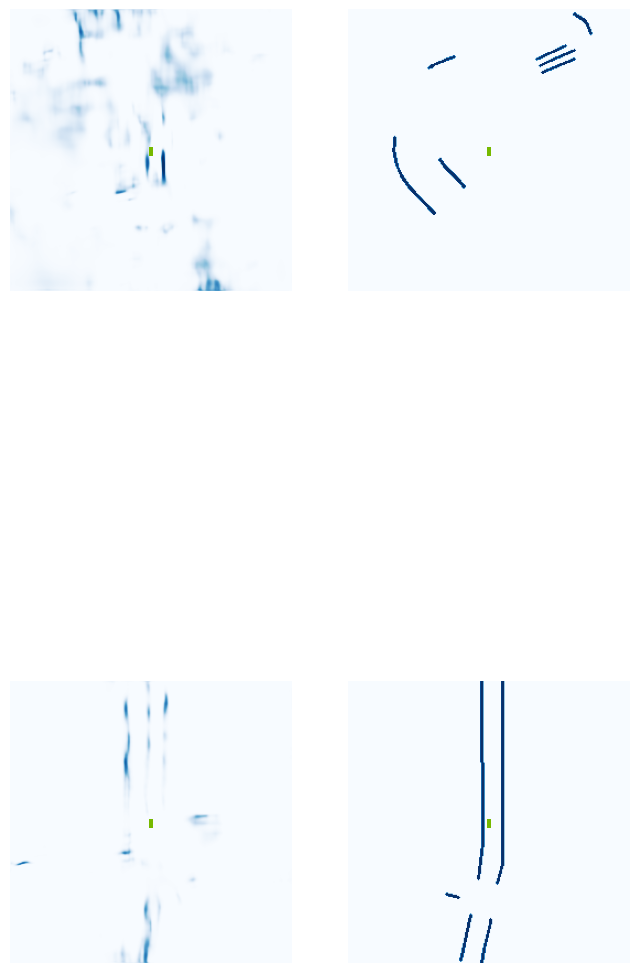

 55%|█████▌    | 22/40 [00:04<00:03,  4.92it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7f4b80>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1608630>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde356700>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde356700>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c89c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c89c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1606

 60%|██████    | 24/40 [00:05<00:02,  6.06it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c376f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c376f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7f76f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7f76f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0c89c60>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe0c89c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde946430>

 62%|██████▎   | 25/40 [00:05<00:02,  6.42it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19dc860>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe159c040>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ae2430>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ae2430>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c376f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c376f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1c10>
In Pillar Features - spatial_features size, whic

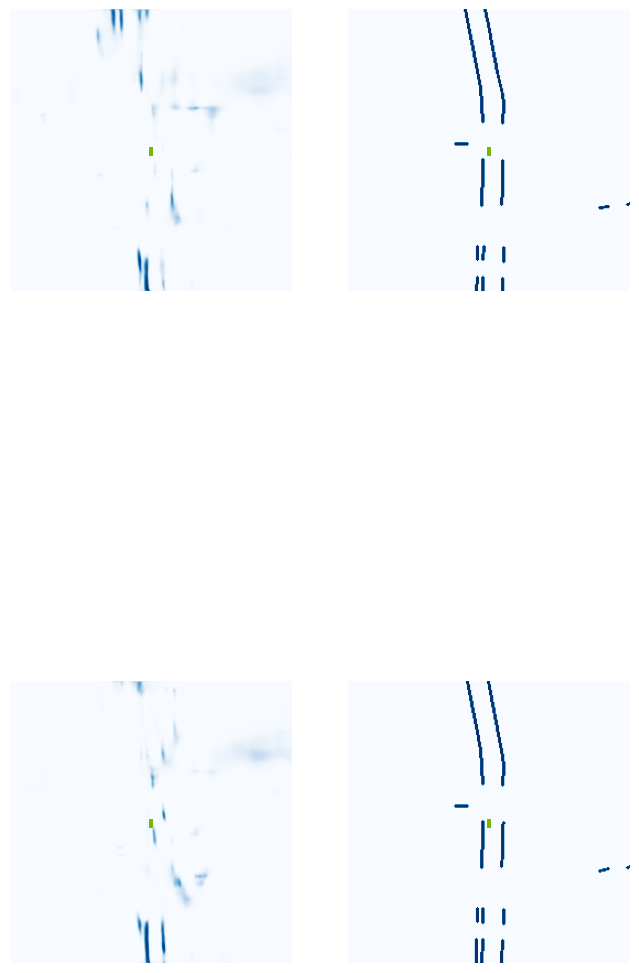

 68%|██████▊   | 27/40 [00:05<00:02,  4.64it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0b55670>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde336d40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15fea20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15fea20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b55670>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b55670>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15a1

 72%|███████▎  | 29/40 [00:06<00:01,  5.91it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde274630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde274630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde344c70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde344c70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1725a80>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1725a80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ae4590>

 75%|███████▌  | 30/40 [00:06<00:01,  6.47it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7f5bc0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe157b470>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1839c60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1839c60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde579170>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde579170>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15a1670>
In Pillar Features - spatial_features size, whic

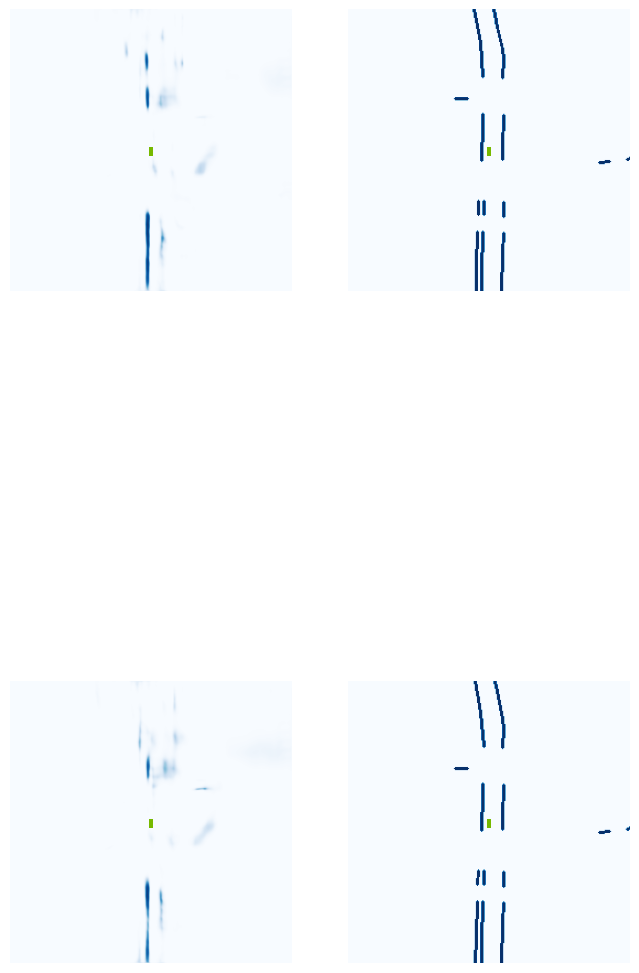

 80%|████████  | 32/40 [00:06<00:01,  4.06it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde45b790>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15a1670>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4d3ce0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4d3ce0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71b0630>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71b0630>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1

 85%|████████▌ | 34/40 [00:07<00:01,  5.34it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde45b790>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde45b790>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c70b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c70b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe181f510>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe181f510>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde59b920>

 88%|████████▊ | 35/40 [00:07<00:00,  5.16it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ae1c10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde579170>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4d2520>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4d2520>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde45b790>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde45b790>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3c6250>
In Pillar Features - spatial_features size, whic

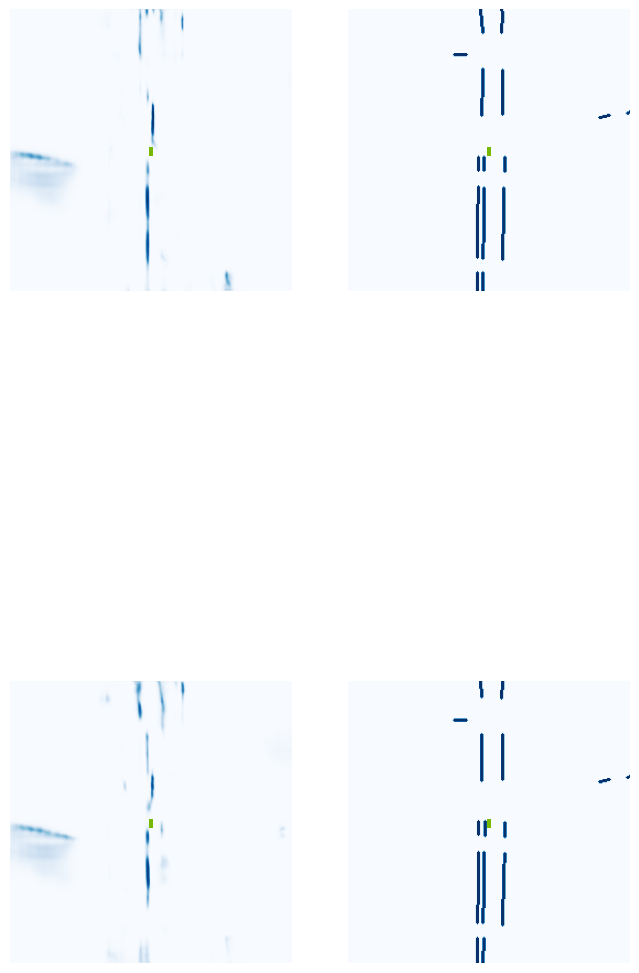

 92%|█████████▎| 37/40 [00:08<00:00,  4.25it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde49c9f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16e9a30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde761da0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde761da0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16eba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16eba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde239

 98%|█████████▊| 39/40 [00:08<00:00,  5.60it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde946f70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde946f70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde49d490>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde49d490>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7cf6f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde7cf6f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde485300>

100%|██████████| 40/40 [00:08<00:00,  4.73it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe17be0c0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b17f10>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b15580>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b176f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b176f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b16c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16bc810>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16bf380>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16bee30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16bee30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16be7f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16be7f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16bde90>
In Pillar Features - spatial_features size, whic

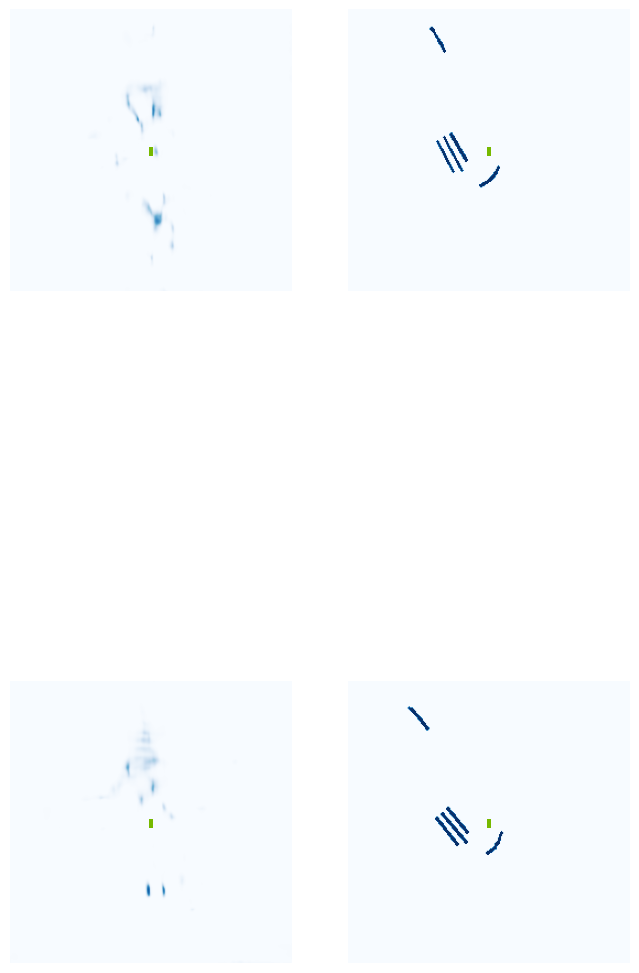

  5%|▌         | 2/40 [00:01<00:18,  2.01it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde49e2a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15d8220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16bf2e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16bf2e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15d9c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15d9c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3506

 10%|█         | 4/40 [00:01<00:09,  3.98it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde49e2a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde49e2a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1753e70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1753e70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15d8220>

 12%|█▎        | 5/40 [00:01<00:07,  4.72it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16bf740>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16bcd10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a43b50>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a43b50>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bea70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bea70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe18127f0>
In Pillar Features - spatial_features size, whic

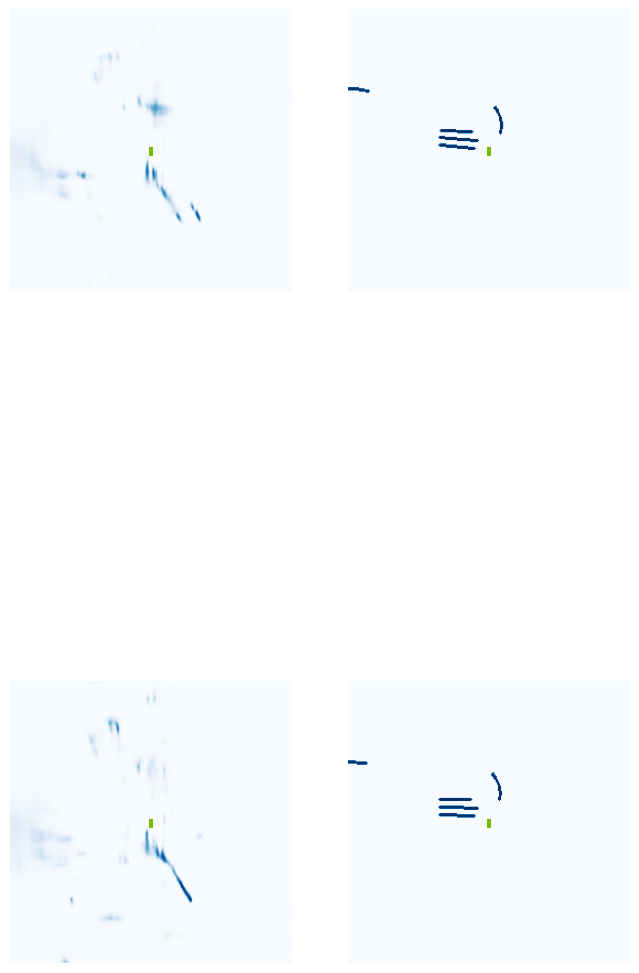

 18%|█▊        | 7/40 [00:02<00:08,  4.10it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16bf740>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19a6200>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2f8810>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2f8810>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19a62

 22%|██▎       | 9/40 [00:02<00:05,  5.48it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b17880>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b17880>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2f8590>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2f8590>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b17f10>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b17f10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ae5440>

 25%|██▌       | 10/40 [00:02<00:05,  5.98it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19a4fe0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2f8040>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16bc900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16bc900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bcd10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bcd10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b04f0>
In Pillar Features - spatial_features size, whic

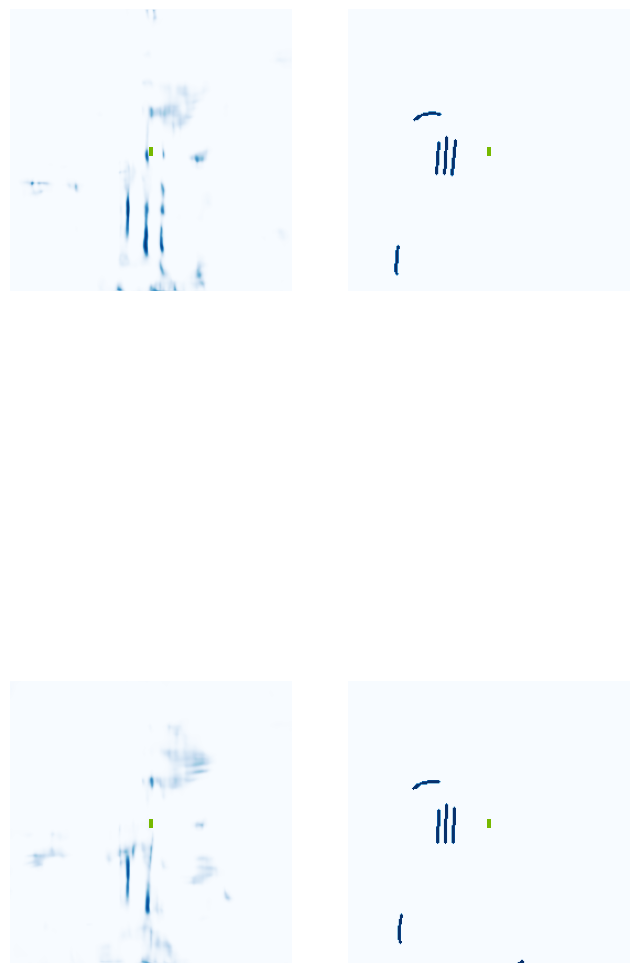

 30%|███       | 12/40 [00:03<00:05,  4.78it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde59a750>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ae5440>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15783b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15783b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15a2

 35%|███▌      | 14/40 [00:03<00:04,  5.89it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71cb2e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71cb2e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fa200>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fa200>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15d8220>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15d8220>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1993ce0>

 38%|███▊      | 15/40 [00:03<00:04,  6.16it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7f4270>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ae6160>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19faf70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19faf70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fa200>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fa200>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1993ce0>
In Pillar Features - spatial_features size, whic

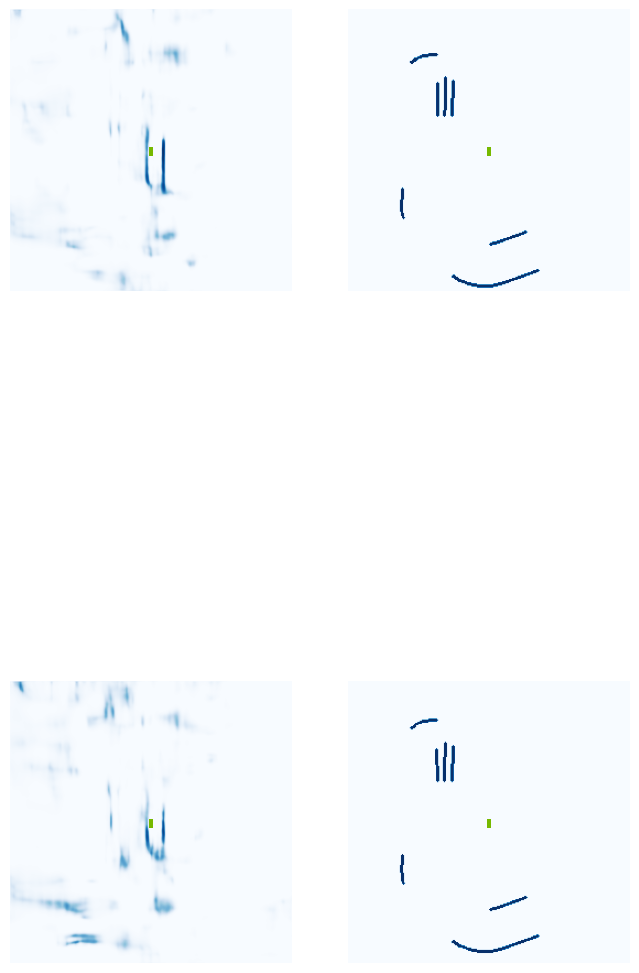

 42%|████▎     | 17/40 [00:04<00:05,  4.54it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19faf70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9a71f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159dcb0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159dcb0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1991

 48%|████▊     | 19/40 [00:04<00:03,  5.81it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9c9c60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fa890>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fa890>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde70dad0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde70dad0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad24d0>

 50%|█████     | 20/40 [00:04<00:03,  6.23it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19f8220>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde463420>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19fa890>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19fa890>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159e070>
In Pillar Features - spatial_features size, whic

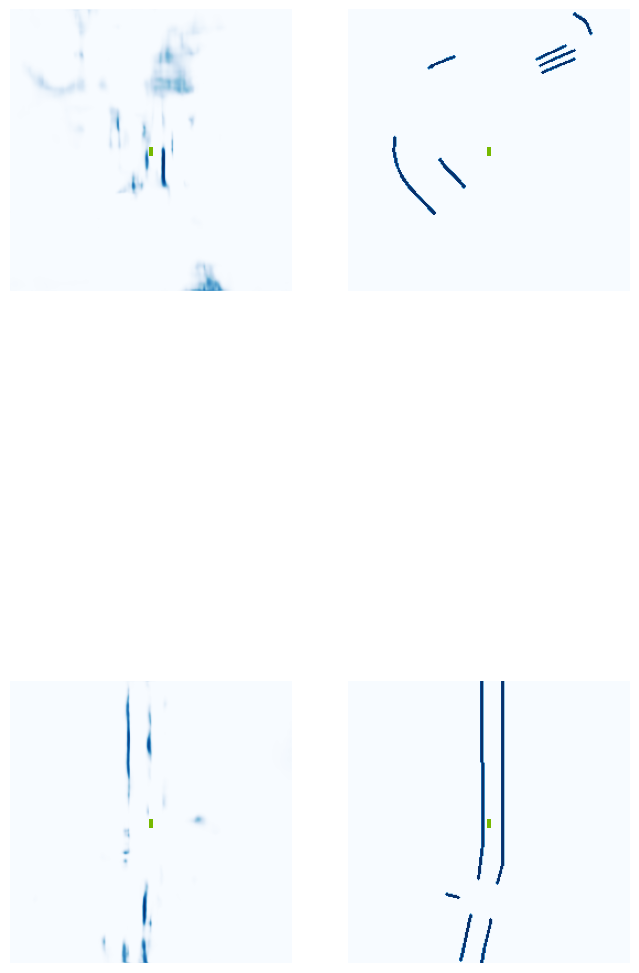

 55%|█████▌    | 22/40 [00:05<00:03,  4.64it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17ea890>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd704d2b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde679300>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde679300>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4376f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4376f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1991

 60%|██████    | 24/40 [00:05<00:02,  5.98it/s]

In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde3e2750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f7c90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde67b600>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f6750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f5e90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde67b8d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f6750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f5e90>
Forward pass of Block class - size of tensor returned:<built-i

 62%|██████▎   | 25/40 [00:05<00:02,  6.56it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17ea890>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17ea890>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde67b600>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde67b600>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9c9c60>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde9c9c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1846c50>

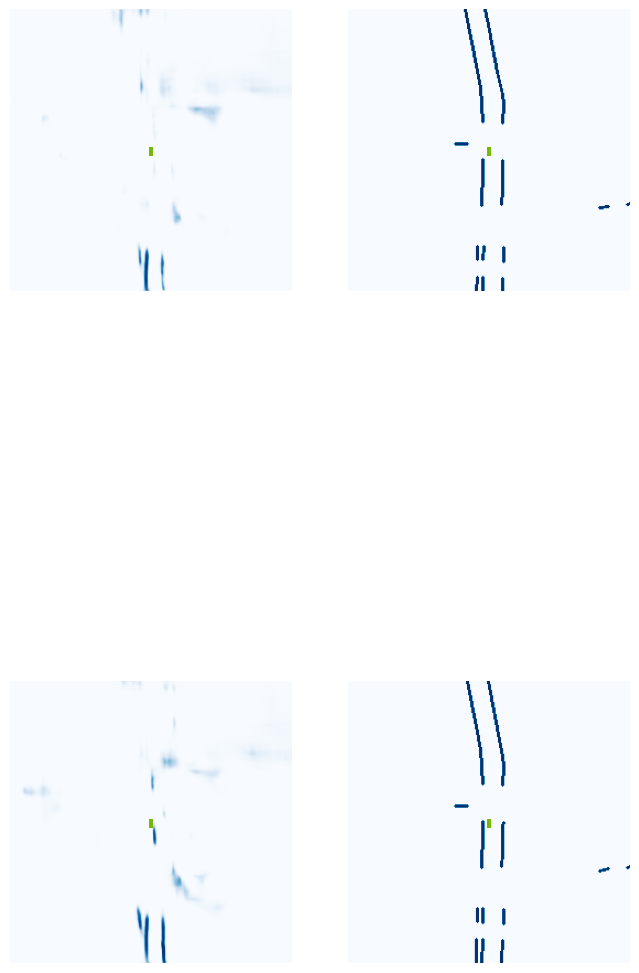

 68%|██████▊   | 27/40 [00:06<00:02,  4.70it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde348090>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ad15d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a842c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a842c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde348090>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde348090>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1991

 72%|███████▎  | 29/40 [00:06<00:01,  6.05it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2fa840>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2fa840>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1552c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1552c00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a40220>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1a40220>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3e1990>

 75%|███████▌  | 30/40 [00:06<00:01,  6.40it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde348090>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5bdd00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e1990>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e1990>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a84450>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a84450>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15459e0>
In Pillar Features - spatial_features size, whic

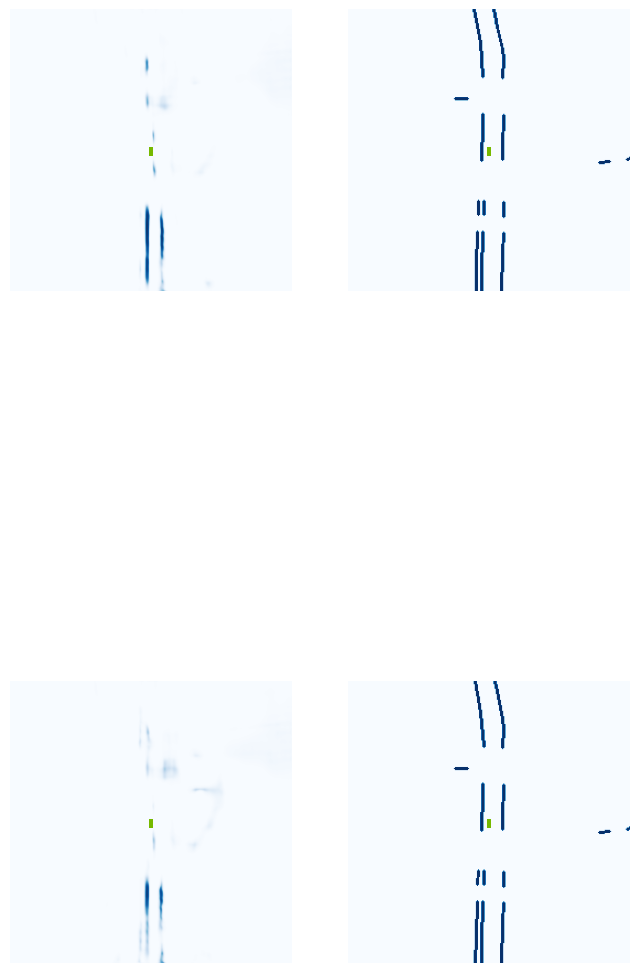

 80%|████████  | 32/40 [00:07<00:01,  4.82it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17327f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2fa840>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde298950>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde298950>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1949c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1949c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15b2

 85%|████████▌ | 34/40 [00:07<00:01,  5.98it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde2fa840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe15e2de0> and l

 88%|████████▊ | 35/40 [00:07<00:00,  6.44it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3e3b50>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde623010>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0b54900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0b54900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1aadbc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b54540>
In Pillar Features - spatial_features size, whic

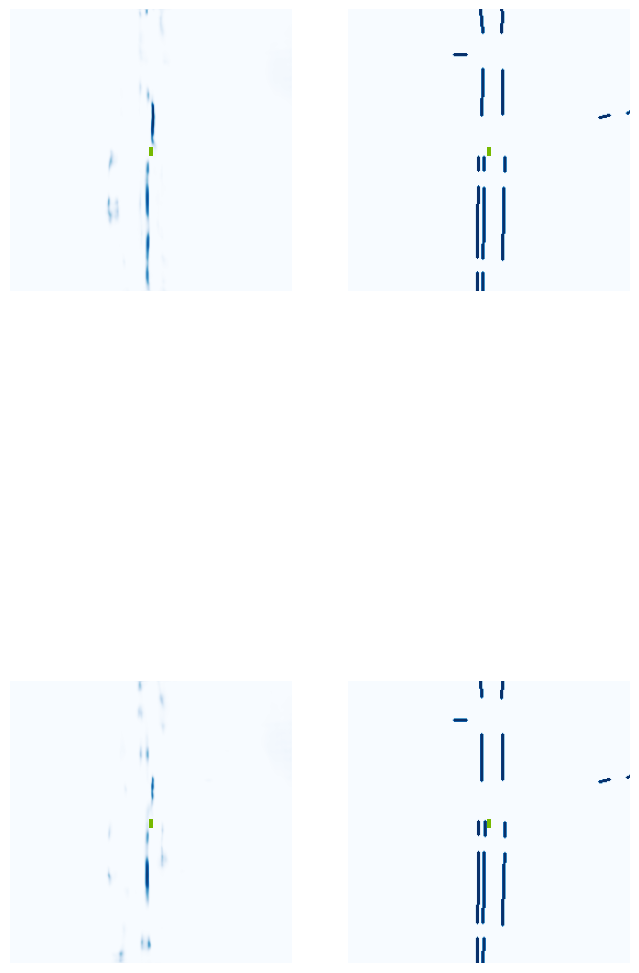

 92%|█████████▎| 37/40 [00:08<00:00,  4.30it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16bd530>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5f28e0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e2660>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e2660>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c37470>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c37470>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1814

 98%|█████████▊| 39/40 [00:08<00:00,  5.64it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe18174c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19ddcb0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19ddcb0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642980>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642f70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde641030>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642e30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642980>
Forwa

100%|██████████| 40/40 [00:08<00:00,  4.71it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde5b1fd0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1706160>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1707ba0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b09e40>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b09e40>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b0b8d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5b3ab0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5b0400>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5b14e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5b14e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5b2c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5b2c00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5b0860>
In Pillar Features - spatial_features size, whic

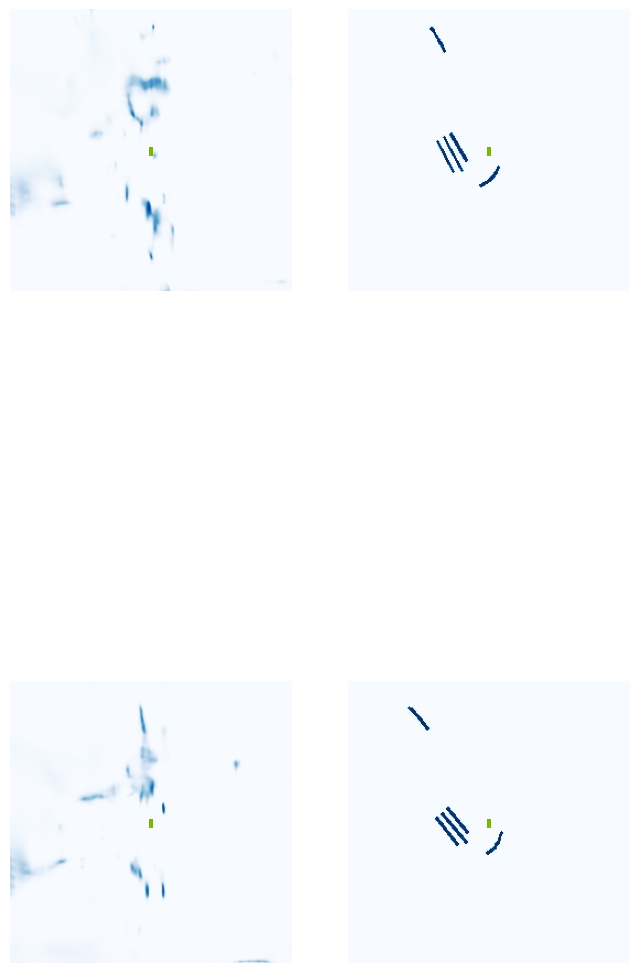

  5%|▌         | 2/40 [00:01<00:20,  1.90it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde578220>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5d0950>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b0a660>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b0a660>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde57ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde57ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9a29

 10%|█         | 4/40 [00:01<00:09,  3.82it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5d0950>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5d0950>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2773d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2773d0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57b1f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde57b1f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe0c29580>

 12%|█▎        | 5/40 [00:01<00:07,  4.66it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5b2250>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5b38d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1aed300>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1aed300>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5b22a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5b22a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5b1850>
In Pillar Features - spatial_features size, whic

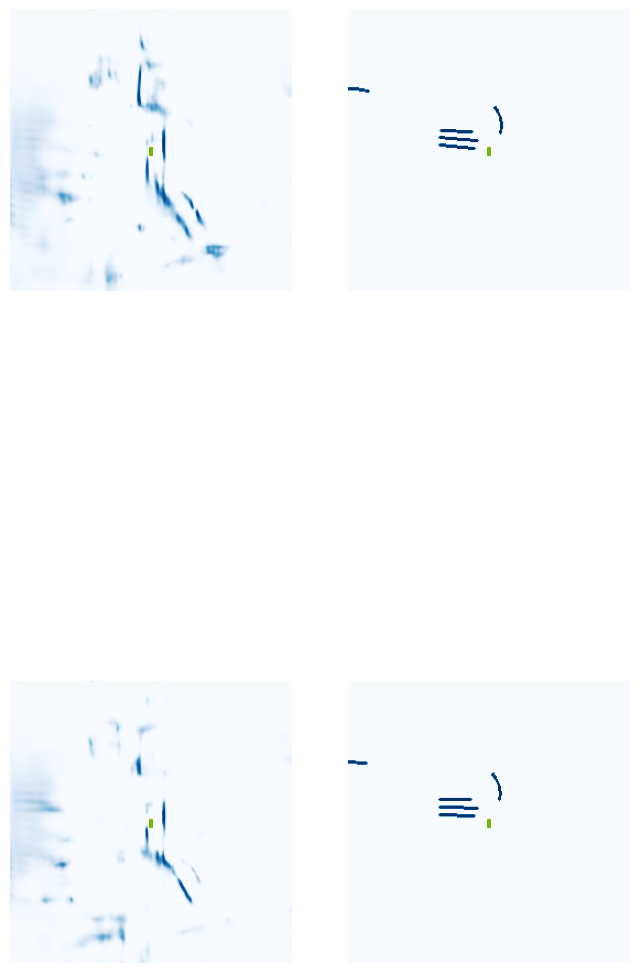

 18%|█▊        | 7/40 [00:02<00:07,  4.24it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159b010>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1598630>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde29a520>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde29a520>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde67b240>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde67b240>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde275e

 22%|██▎       | 9/40 [00:02<00:05,  5.62it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159b010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159b010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a649a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a649a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159a6b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159a6b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde866110>

 25%|██▌       | 10/40 [00:02<00:04,  6.21it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde45aac0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde947100>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde578950>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde578950>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde8655d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde8655d0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde891620>
In Pillar Features - spatial_features size, whic

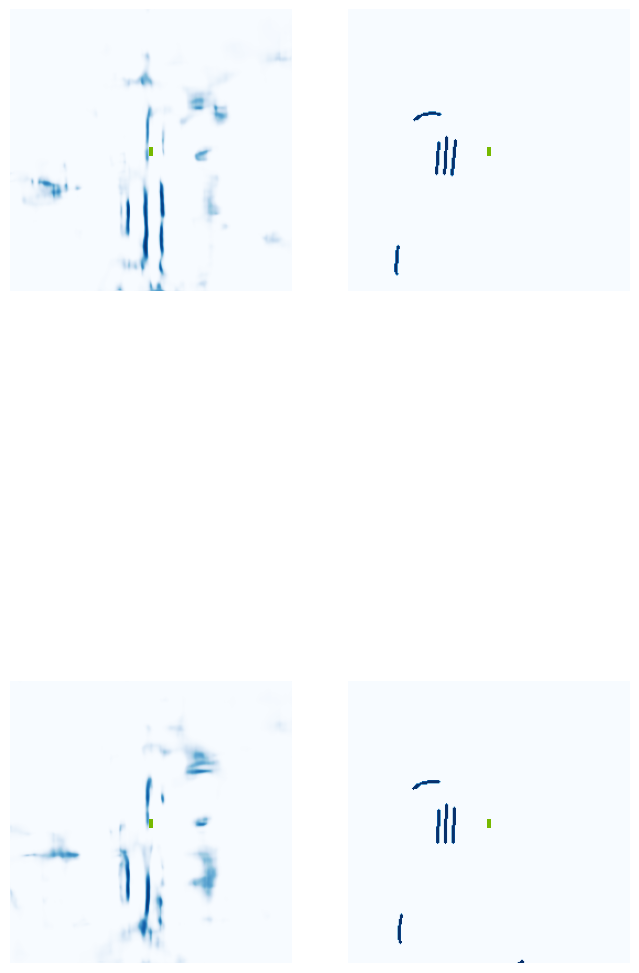

 30%|███       | 12/40 [00:03<00:05,  4.93it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe160af70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde763010>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1608950>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1608950>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159ea20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159ea20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a64

 35%|███▌      | 14/40 [00:03<00:04,  6.09it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a64a90>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a64a90>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1608c70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1608c70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8643b0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde8643b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe195ebb0>

 38%|███▊      | 15/40 [00:03<00:03,  6.60it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe160b880>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1598680>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde45a2a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde45a2a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde760360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde760360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0b55580>
In Pillar Features - spatial_features size, whic

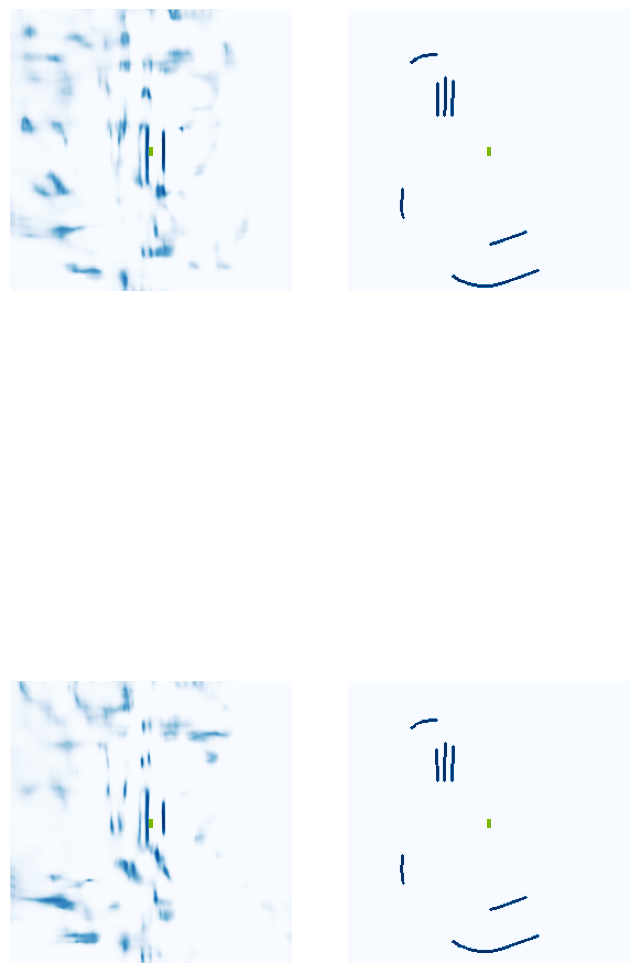

 42%|████▎     | 17/40 [00:04<00:04,  4.91it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159b010>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71c9530>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe195e250>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe195e250>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15a1c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15a1c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde522

 48%|████▊     | 19/40 [00:04<00:03,  6.12it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde867060>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7eaba83e70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7eaba83e70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1578770>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7f4450>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1578770>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7f49a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1578770>
Forwa

 50%|█████     | 20/40 [00:04<00:03,  6.58it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2773d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a4fe0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a64270>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a64270>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1608c70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1608c70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde3a4fe0>
In Pillar Features - spatial_features size, whic

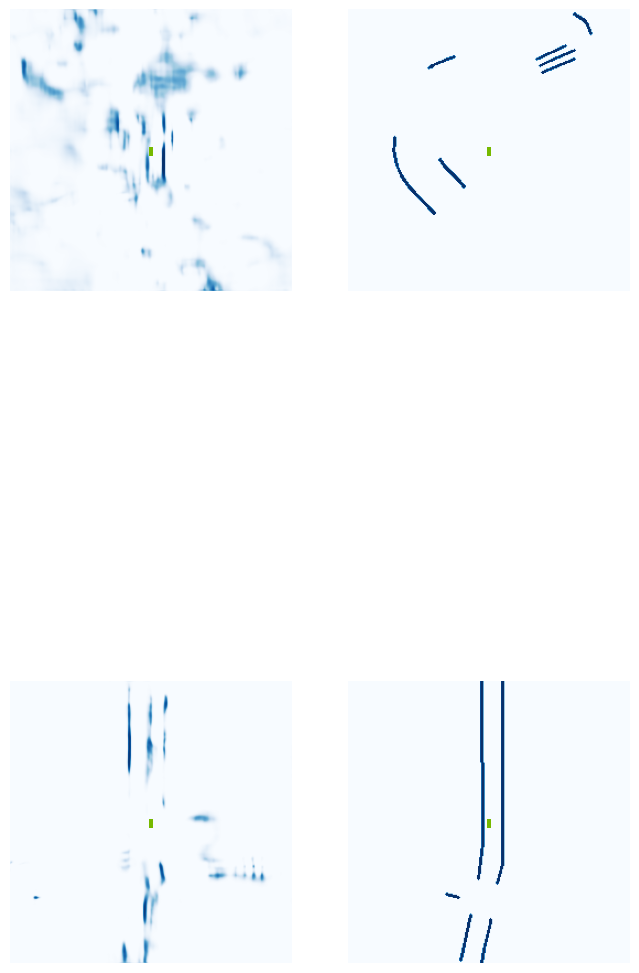

 55%|█████▌    | 22/40 [00:04<00:03,  4.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde48fce0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde6231a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9bf330>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9bf330>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a83a60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a83a60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde623

 60%|██████    | 24/40 [00:05<00:02,  6.14it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15dafc0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cdcb0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cec50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cce50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cdcb0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cec50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cf9c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7cdcb0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe159ea20> and l

 62%|██████▎   | 25/40 [00:05<00:02,  6.62it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a4cc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a4cc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe160ae30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe160ae30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71c9530>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd71c9530>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde334900>

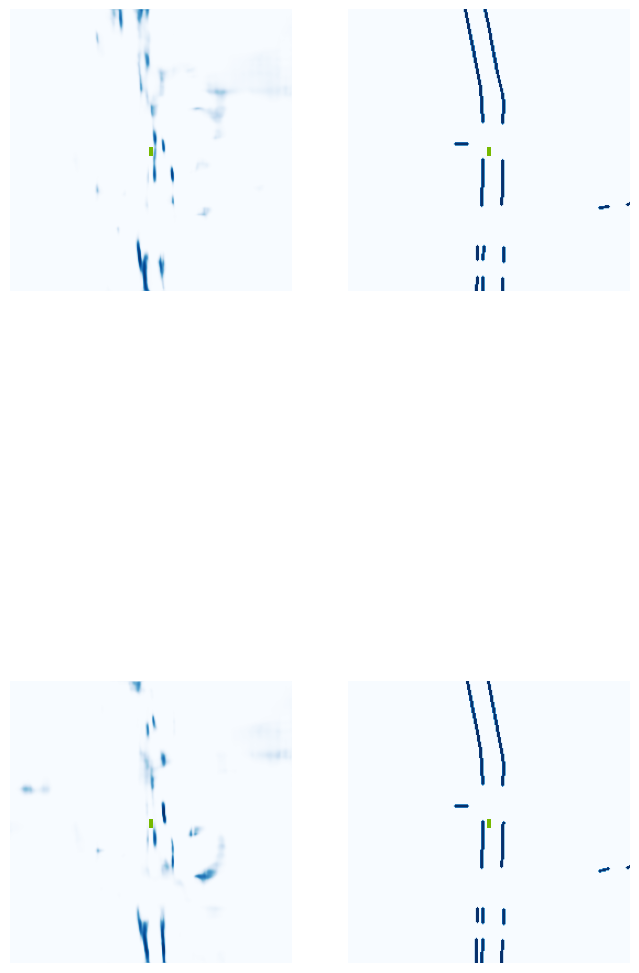

 68%|██████▊   | 27/40 [00:05<00:02,  4.91it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1811350>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17be430>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1812890>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1812890>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1811350>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1811350>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde23a

 72%|███████▎  | 29/40 [00:06<00:01,  6.03it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1706a20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1706a20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1813fb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1813fb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd7068680>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fd7068680>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde723ce0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.51it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b15d00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2a7d30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1810220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1810220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7cdd50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7cdd50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17ead90>
In Pillar Features - spatial_features size, whic

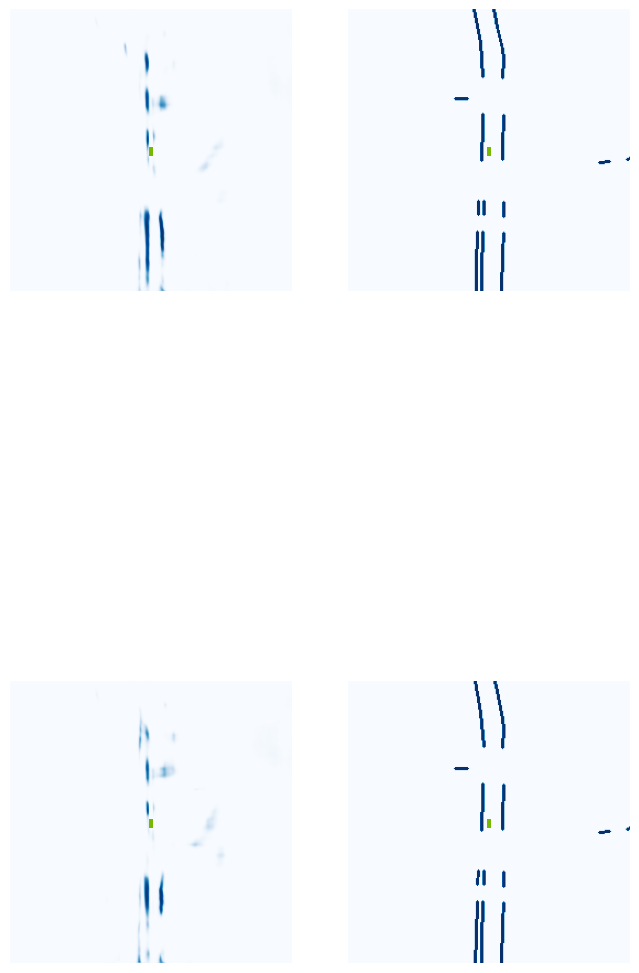

 80%|████████  | 32/40 [00:06<00:01,  4.66it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd71b39c0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde2fab10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde642f70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde642f70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71b0360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71b0360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b2

 85%|████████▌ | 34/40 [00:07<00:01,  5.90it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71b39c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71b39c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7cf6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7cf6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15c2d90>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15c2d90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8f6a20>

 88%|████████▊ | 35/40 [00:07<00:00,  6.33it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde8f5d00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde8f79c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16bd080>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16bd080>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19fb010>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19fb010>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a86570>
In Pillar Features - spatial_features size, whic

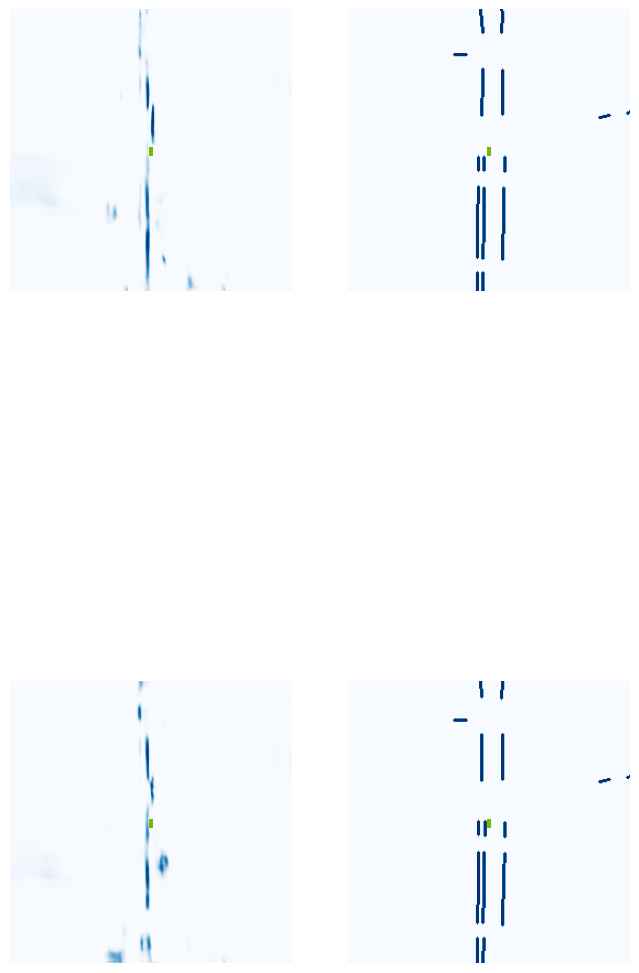

 92%|█████████▎| 37/40 [00:08<00:00,  3.53it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.09.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5e1e40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5e1d50>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15453f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15453f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1547470>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1547470>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1544

 98%|█████████▊| 39/40 [00:08<00:00,  5.07it/s]

In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5e2d90>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5e2d90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad07c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad3bf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad0bd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad39c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad0db0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad2cf0>
Forward pass of Block class - size

100%|██████████| 40/40 [00:08<00:00,  4.65it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe19dd3a0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1576250>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1574450>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1574680>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1574680>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1574400>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b2660>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b1580>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde720590>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde720590>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b1080>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b1080>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15b0e50>
In Pillar Features - spatial_features size, whic

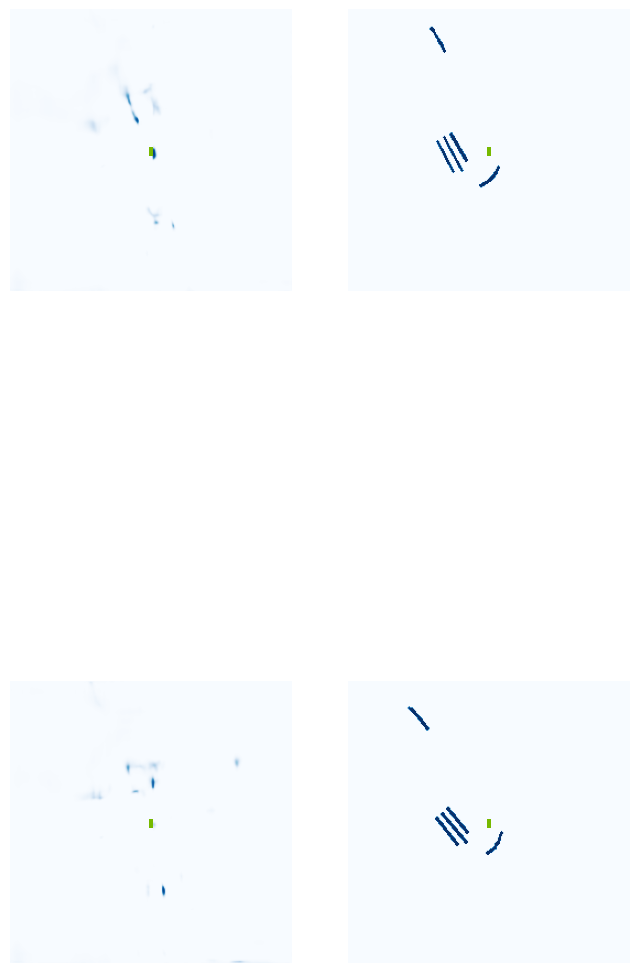

  5%|▌         | 2/40 [00:01<00:18,  2.03it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde349e40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16bce00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1576a70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1576a70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b1580>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b1580>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16bcd

 10%|█         | 4/40 [00:01<00:08,  4.08it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde239a30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde239a30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15b1120>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b1120>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2faac0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2faac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b17fb0>

 12%|█▎        | 5/40 [00:01<00:07,  4.95it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2fb290>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe183b150>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde239a30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde239a30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16bce00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16bce00>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2faac0>
In Pillar Features - spatial_features size, whic

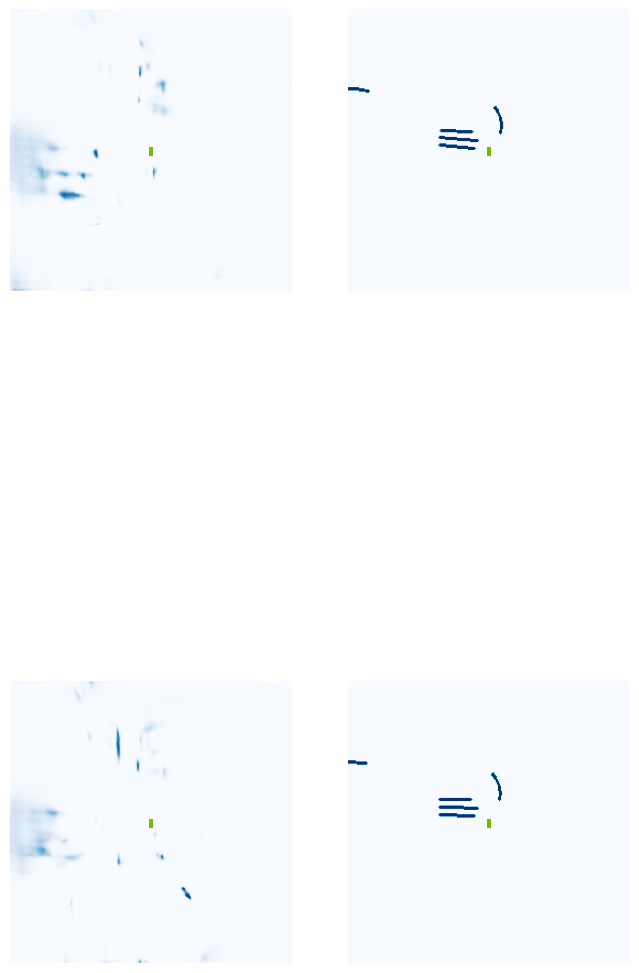

 18%|█▊        | 7/40 [00:02<00:07,  4.44it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde642f70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15b0ef0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe18453a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe18453a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17eba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17eba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16d87

 22%|██▎       | 9/40 [00:02<00:05,  5.78it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15b3d30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17bce00>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe17bce00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad22a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad1f80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad2200>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad22a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad1f80>
Forwa

 25%|██▌       | 10/40 [00:02<00:04,  6.20it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde555f30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde554f40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde352160>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde352160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17bc130>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17bc130>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde352de0>
In Pillar Features - spatial_features size, whic

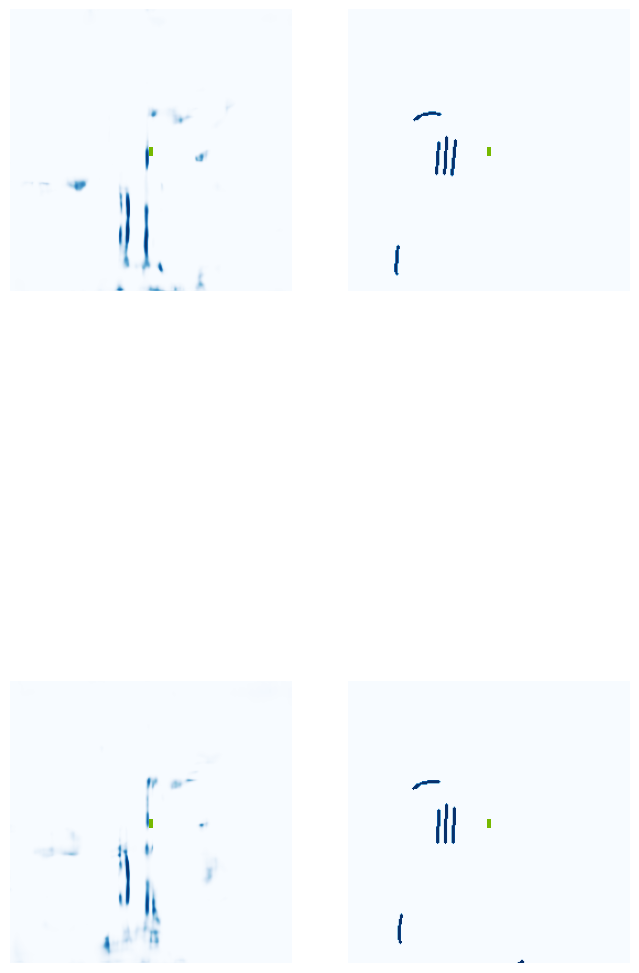

 30%|███       | 12/40 [00:03<00:06,  4.57it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1577ec0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16e8090>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde598680>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde598680>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3531a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3531a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde642

 35%|███▌      | 14/40 [00:03<00:04,  5.87it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe183bfb0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe183bfb0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a7920>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a7920>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe18162a0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe18162a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe17bcbd0>

 38%|███▊      | 15/40 [00:03<00:03,  6.37it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16e8090>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16dad90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3c56c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3c56c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3c4950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3c4950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19a7d30>
In Pillar Features - spatial_features size, whic

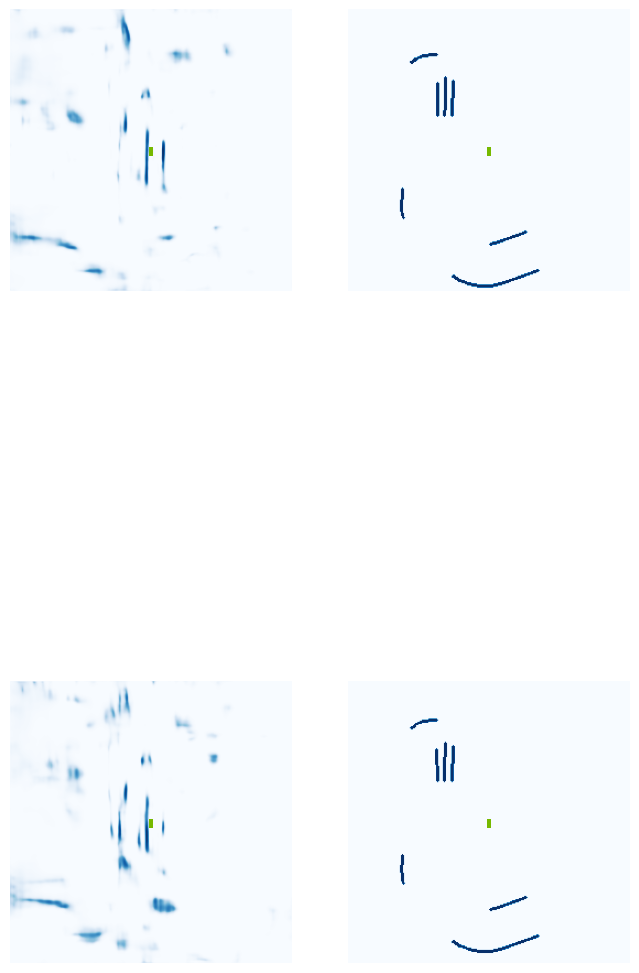

 42%|████▎     | 17/40 [00:03<00:04,  4.87it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7cc950>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7cca40>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c8b4c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c8b4c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71cb420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71cb420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde6f2

 48%|████▊     | 19/40 [00:04<00:03,  6.04it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e0770>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e0770>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd71b02c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd71b02c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde359210>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde359210>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ae7b00>

 50%|█████     | 20/40 [00:04<00:03,  6.53it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17273d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15e33d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71cb420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71cb420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c8b4c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c8b4c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15e33d0>
In Pillar Features - spatial_features size, whic

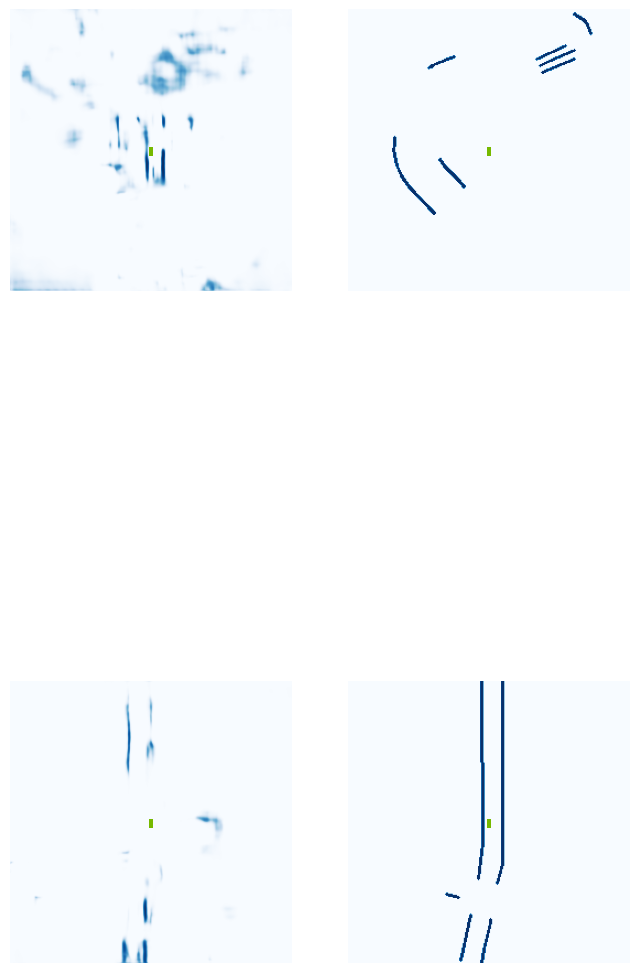

 55%|█████▌    | 22/40 [00:04<00:03,  4.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1727650>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe157bc90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4433d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4433d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe157b

 60%|██████    | 24/40 [00:05<00:02,  6.05it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2a62a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2a62a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7cef20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7cef20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2a5ad0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2a5ad0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1992e30>

 62%|██████▎   | 25/40 [00:05<00:02,  6.46it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde7cc950>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1991300>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7cef20>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159e2a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159e2a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1608e00>
In Pillar Features - spatial_features size, whic

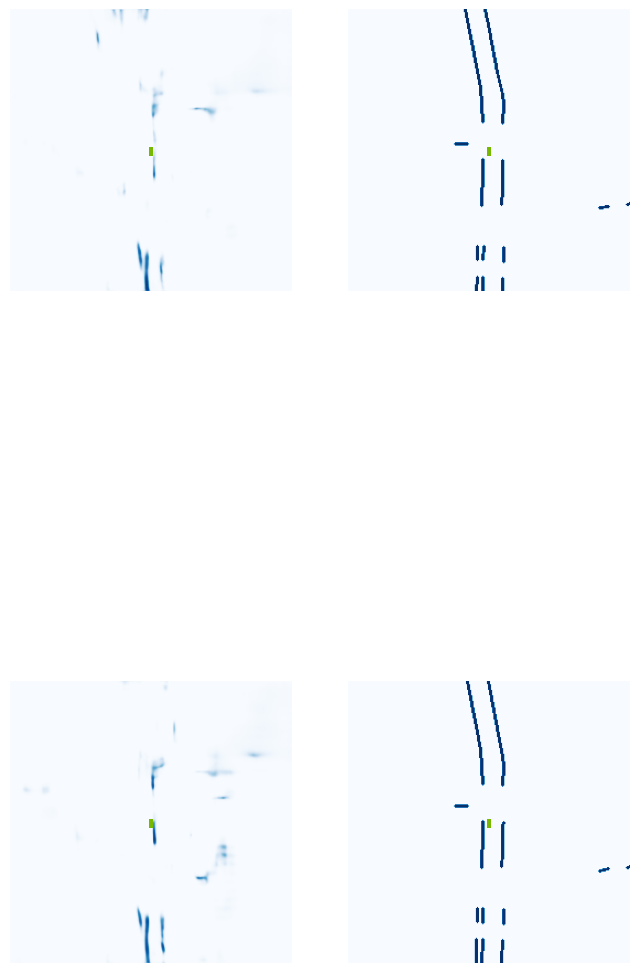

 68%|██████▊   | 27/40 [00:05<00:02,  5.12it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159e2a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde67af70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe195c9f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe195c9f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde760360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde760360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aad

 72%|███████▎  | 29/40 [00:06<00:01,  6.27it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159cbd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159cbd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15c3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15c3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde6784a0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde6784a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde8679c0>

 75%|███████▌  | 30/40 [00:06<00:01,  6.70it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1732d90>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1730810>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe195c9f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe195c9f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a7330>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a7330>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde760040>
In Pillar Features - spatial_features size, whic

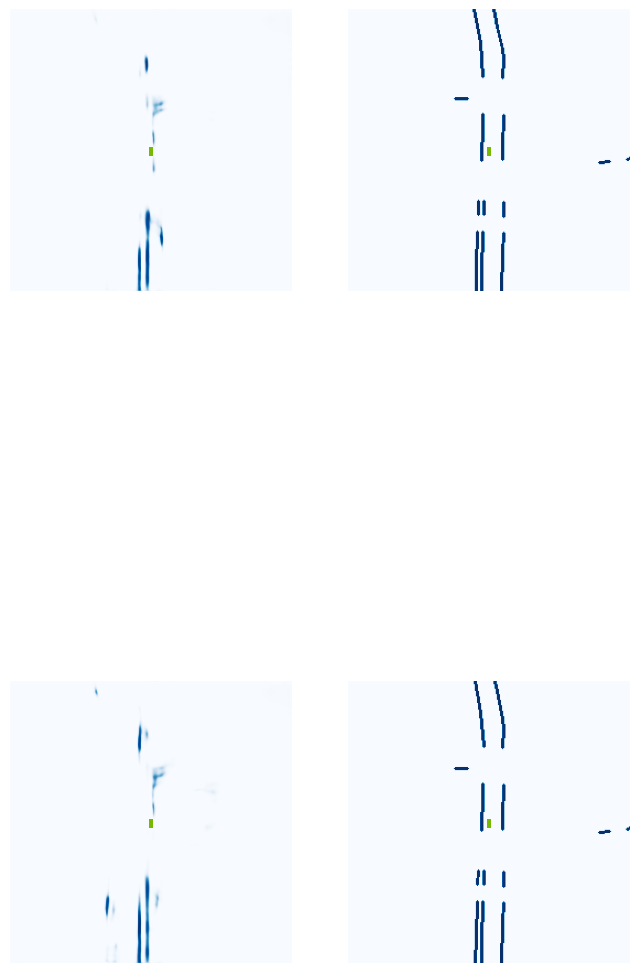

 80%|████████  | 32/40 [00:06<00:01,  4.84it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15c2520>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a66fc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c375b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c375b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1598360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1598360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5f2

 85%|████████▌ | 34/40 [00:07<00:00,  6.06it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a66570>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a66570>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0b540e0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0b540e0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87be020>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7ea87be020>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3450d0>

 88%|████████▊ | 35/40 [00:07<00:00,  6.35it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16c8e00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde761490>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd711a200>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd711a200>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde8653f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde8653f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87be020>
In Pillar Features - spatial_features size, whic

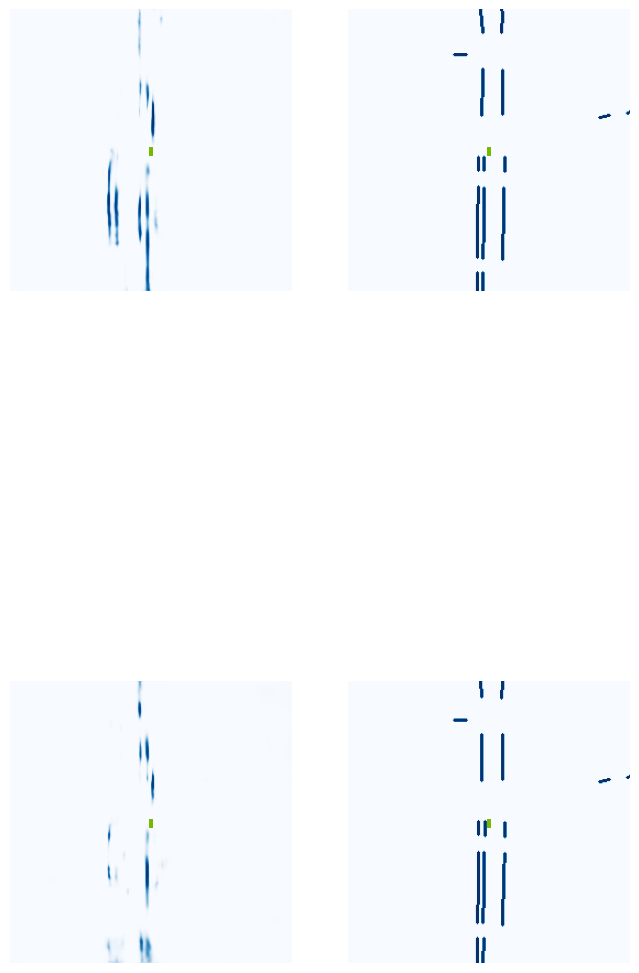

 92%|█████████▎| 37/40 [00:07<00:00,  5.05it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.09.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5bd260>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1aef5b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1707600>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1707600>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1706660>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1706660>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4d2

 95%|█████████▌| 38/40 [00:07<00:00,  5.61it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15c5030>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15c5030>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7eaba822f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7eaba822f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19fa160>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19fa160>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19483b0>

100%|██████████| 40/40 [00:08<00:00,  4.90it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe194a930>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe194a340>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1949620>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1949620> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe194a340>
final output-fused features-of Transfuser forward pass is of size:<built-in method size of Tensor object at 0x7d7fe194a930>
Number of feature channels should match number of input channels to be expected for input to BEVEncode
Resulting size coming out of BEVEncode<built-in method size of Tensor object at 0x7d7fe1aee890>
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7

Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fd70608b0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15c7b00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15c6d90>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15c46d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15c46d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15c6c00>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b05080>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b042c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b06070>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b06070>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b057b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b057b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b05cb0>
In Pillar Features - spatial_features size, whic

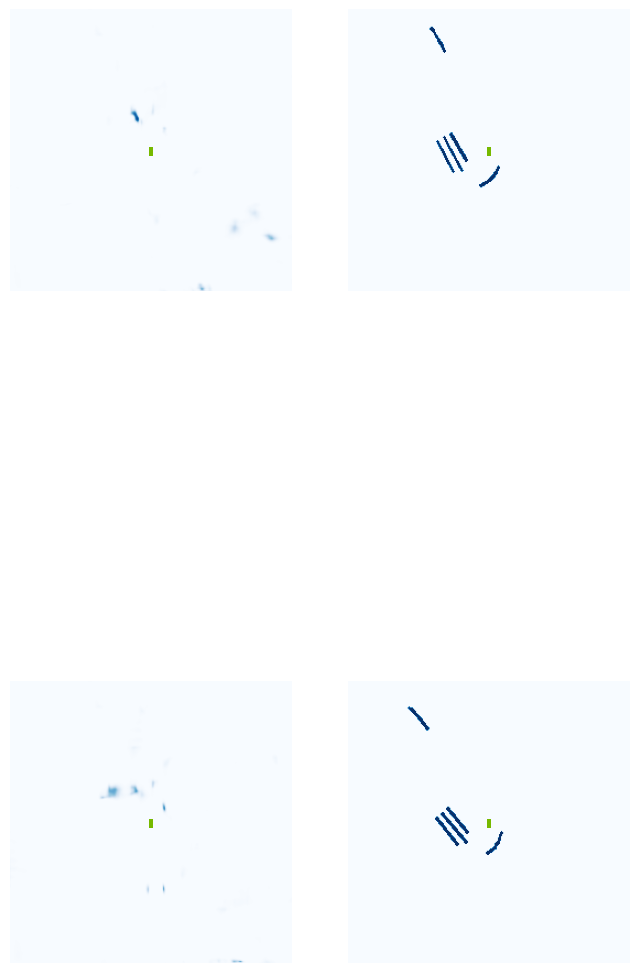

  5%|▌         | 2/40 [00:01<00:19,  1.95it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1704900>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5b0540>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b06660>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b06660>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b04b30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b04b30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17049

 10%|█         | 4/40 [00:01<00:09,  3.90it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe171f4c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe171f4c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b05a80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b05a80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b07650>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b07650>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd70603b0>

 12%|█▎        | 5/40 [00:01<00:07,  4.74it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b063e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b05350>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe174e750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe174e750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b07ce0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b07ce0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b07a10>
In Pillar Features - spatial_features size, whic

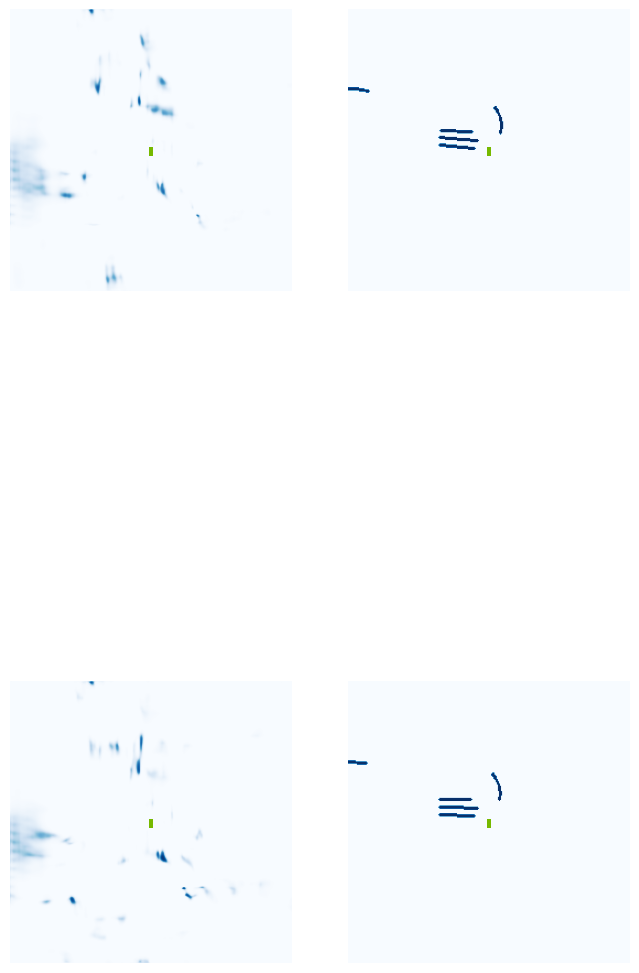

 18%|█▊        | 7/40 [00:02<00:07,  4.19it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159a700>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe183f600>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16ca750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16ca750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5f0360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5f0360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde29a1

 22%|██▎       | 9/40 [00:02<00:05,  5.57it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57a8e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde578ef0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57aac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57a700>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57a8e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde578090>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde57aac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde578ef0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe16cbce0> and l

 25%|██▌       | 10/40 [00:02<00:04,  6.09it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159b010>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5d0b30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7ea87befc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7ea87befc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b05a80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b05a80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16dc4a0>
In Pillar Features - spatial_features size, whic

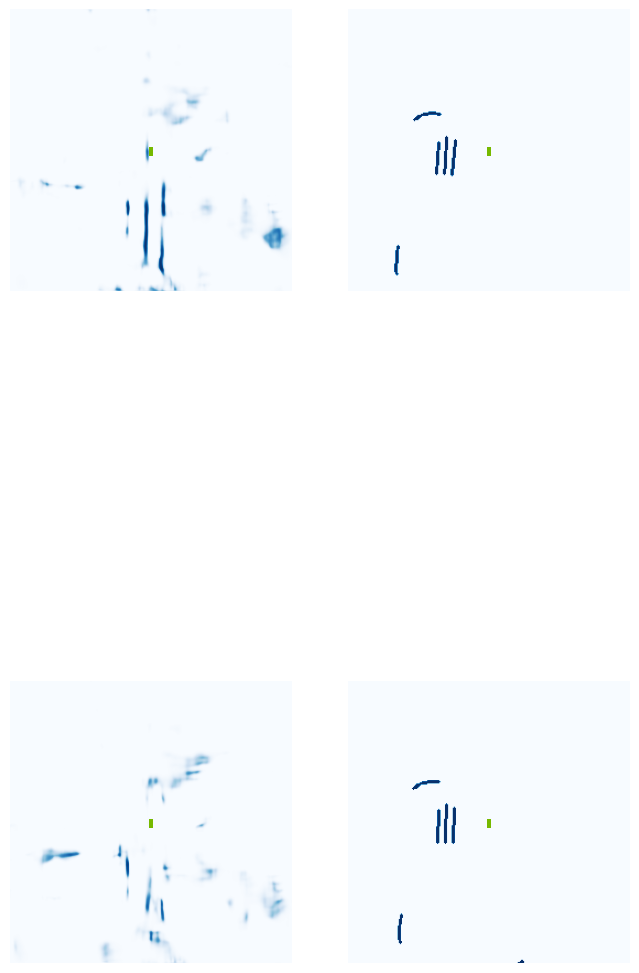

 30%|███       | 12/40 [00:03<00:05,  4.72it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5be390>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde866a20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3e0540>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3e0540>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde867740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde867740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16dc

 35%|███▌      | 14/40 [00:03<00:04,  5.98it/s]

In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0d17650>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0d17650>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b06a70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b06a70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde867740>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe17049a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1704400>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor objec

 38%|███▊      | 15/40 [00:03<00:03,  6.43it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde30c590>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde866070>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b07240>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b07240>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1948950>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1948950>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57bc40>
In Pillar Features - spatial_features size, whic

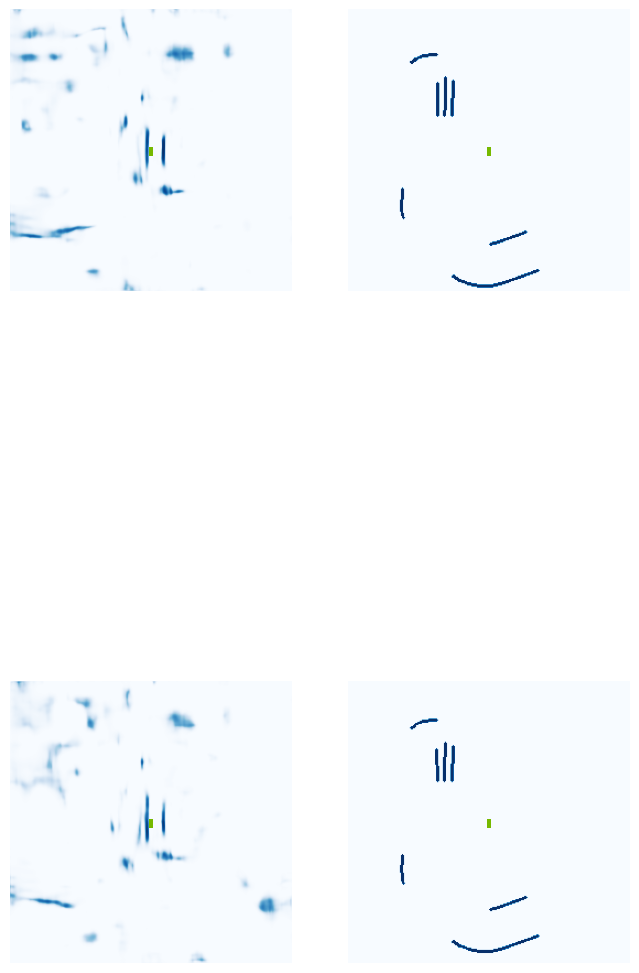

 42%|████▎     | 17/40 [00:04<00:04,  5.03it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1b07240>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a4220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe171c4a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe171c4a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b07a10>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b07a10>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1

 48%|████▊     | 19/40 [00:04<00:03,  6.31it/s]

Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6219e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde866a20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde866a20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9e5490>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde9e5490>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde443970>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4417b0>
Forward pass of Block class - size of t

 50%|█████     | 20/40 [00:04<00:02,  6.85it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b06a70>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b06a70>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde45bd80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde45bd80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde30c590>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde30c590>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde45bd80>

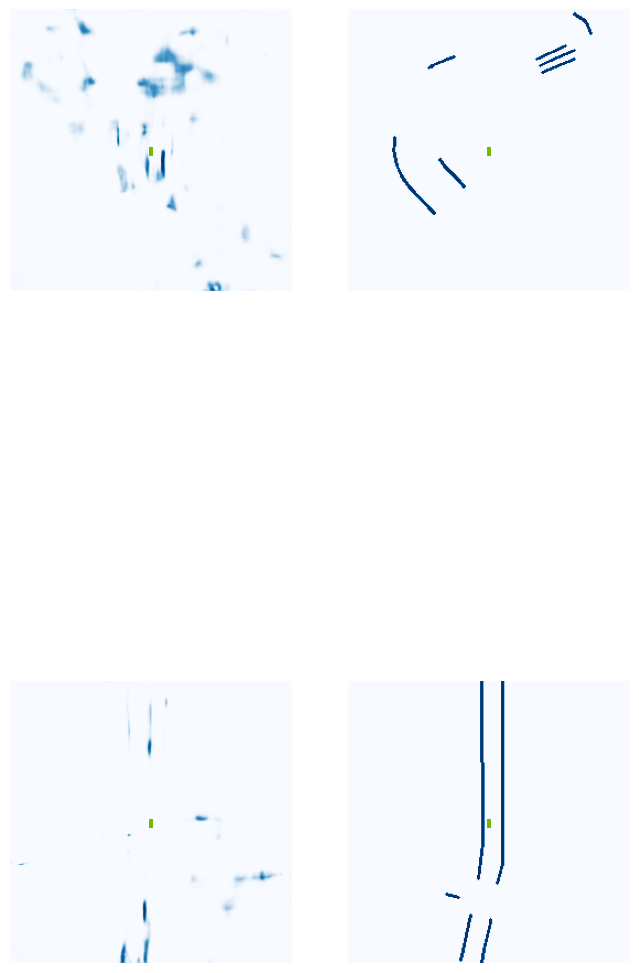

 55%|█████▌    | 22/40 [00:04<00:03,  4.76it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd7118590>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7f62a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde867470>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde867470>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd7118590>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd7118590>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1

 60%|██████    | 24/40 [00:05<00:02,  6.09it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f62a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f62a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde7f53a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde7f53a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5d1260>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde5d1260>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1817740>

 62%|██████▎   | 25/40 [00:05<00:02,  6.57it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1ae49f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b06a70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6af0b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6af0b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae49f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae49f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1544ae0>
In Pillar Features - spatial_features size, whic

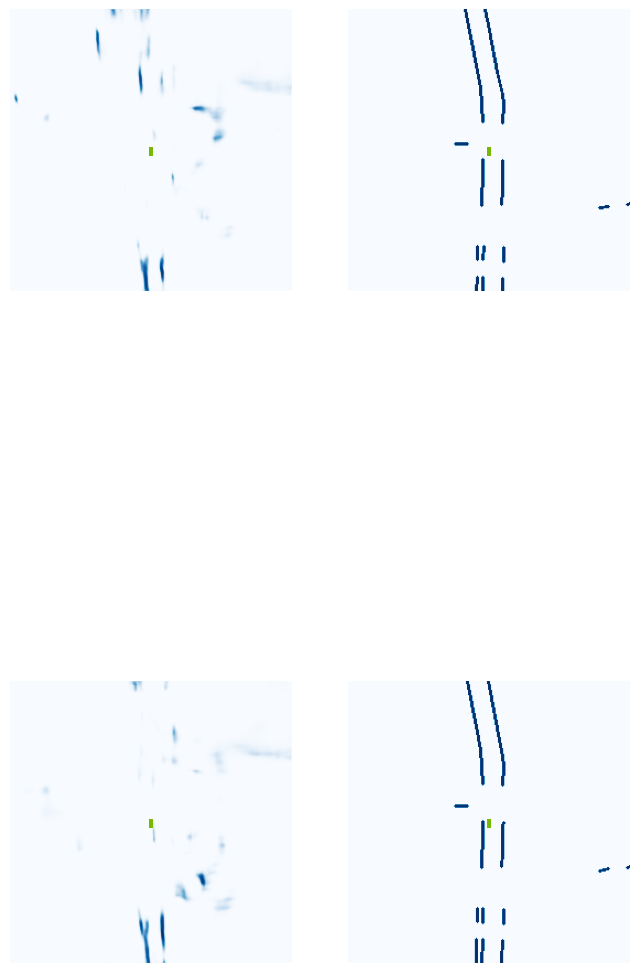

 68%|██████▊   | 27/40 [00:05<00:02,  5.13it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1579e90>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17bf9c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a83150>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a83150>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1579e90>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1579e90>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1ae1

 72%|███████▎  | 29/40 [00:06<00:01,  6.25it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde59a2a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde59a2a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde78da80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde78da80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde440720>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde440720>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16d9940>

 75%|███████▌  | 30/40 [00:06<00:01,  6.68it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16eb650>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a80770>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7cdad0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7cdad0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde440630>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde440630>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe18173d0>
In Pillar Features - spatial_features size, whic

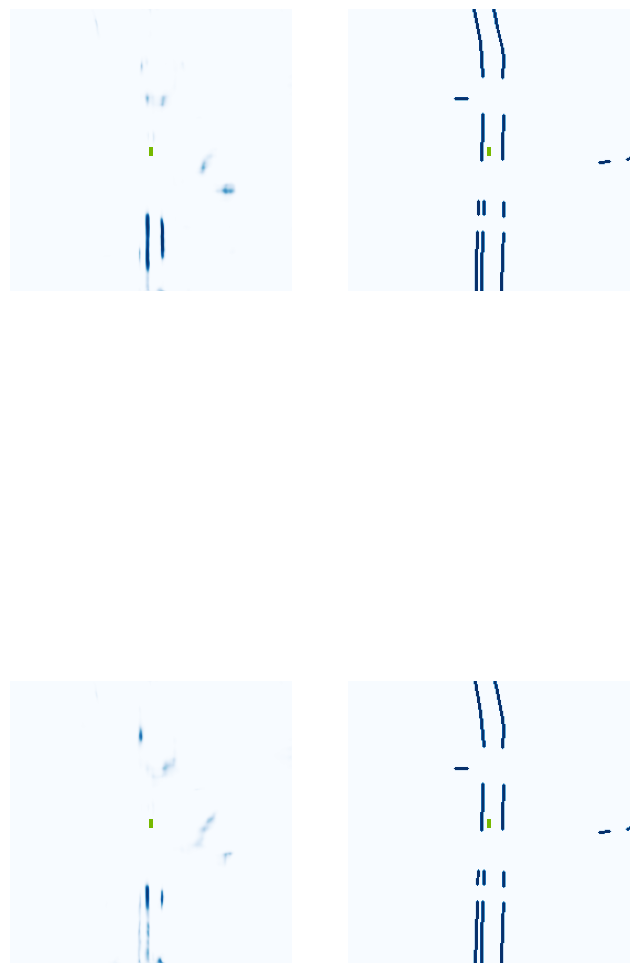

 80%|████████  | 32/40 [00:06<00:01,  4.62it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde461080>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1b07a10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17e8f40>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17e8f40>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde460ef0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde460ef0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15e3

 85%|████████▌ | 34/40 [00:07<00:01,  5.63it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1a822f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1a822f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde460ef0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde460ef0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16dbd30>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe16dbd30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b158f0>

 88%|████████▊ | 35/40 [00:07<00:00,  6.00it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19a75b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde8671f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde460b80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde460b80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde45ac50>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde45ac50>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16da890>
In Pillar Features - spatial_features size, whic

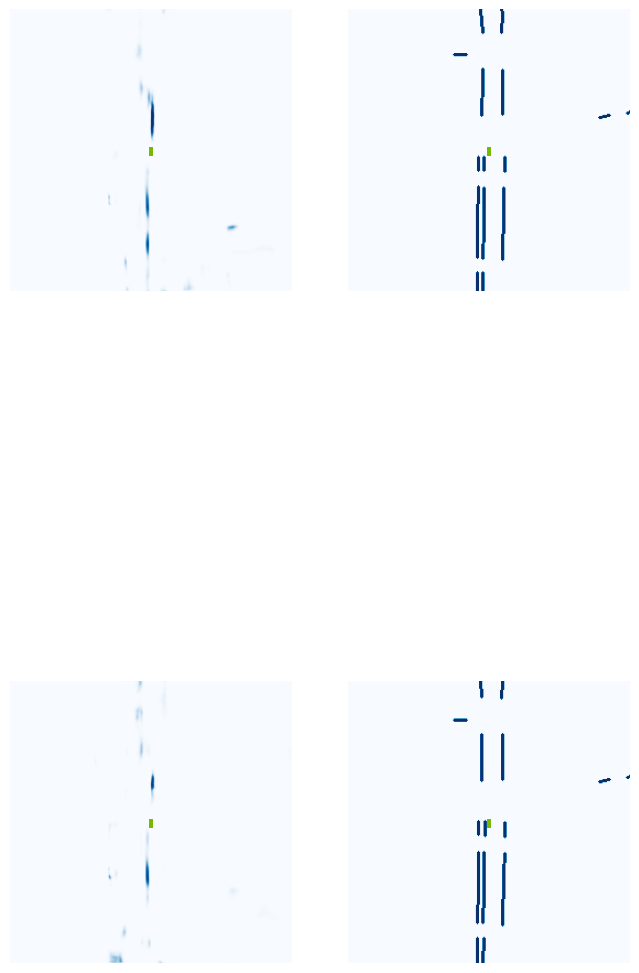

 92%|█████████▎| 37/40 [00:07<00:00,  4.48it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.04.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe19938d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16be4d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde348630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde348630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a2d3a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a2d3a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde864

 98%|█████████▊| 39/40 [00:08<00:00,  5.73it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde348630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde348630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2f93a0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2f93a0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde4b3e70>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde4b3e70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1a2f9c0>

100%|██████████| 40/40 [00:08<00:00,  4.76it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15b32e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde49ea20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16dbd30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16dbd30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde6433d0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde6433d0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17eb790>
In Pillar Features - spatial_features size, whic

Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fde23bec0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2389f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde23a070>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde23b420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde23b420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde239cb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a86a20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a853f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde8f5350>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde8f5350>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde8f6840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde8f6840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde84c860>
In Pillar Features - spatial_features size, whic

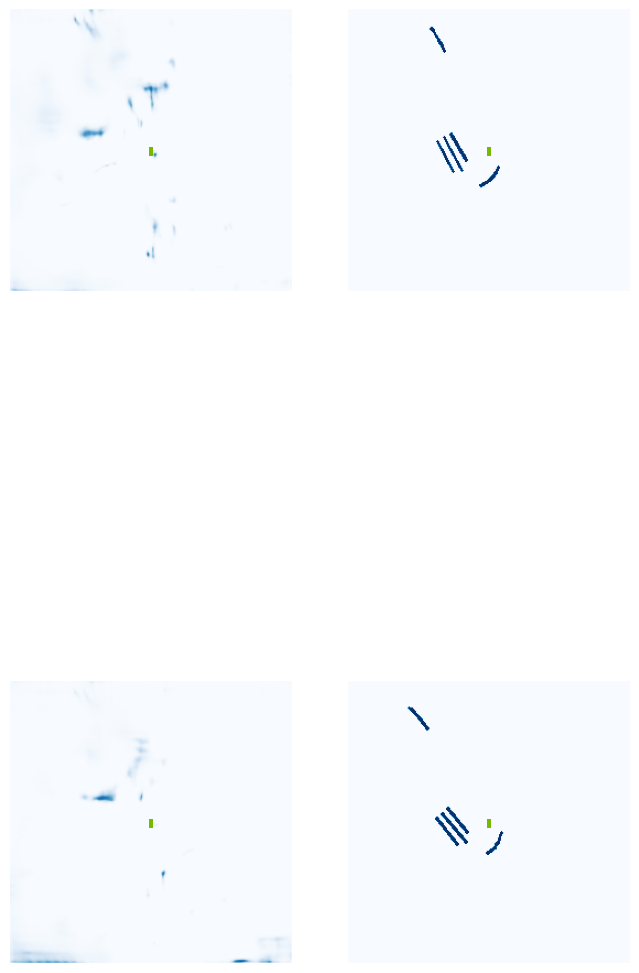

  5%|▌         | 2/40 [00:01<00:19,  1.94it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1577fb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1576fc0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2f99e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2f99e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde4d3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde4d3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde34f1

 10%|█         | 4/40 [00:01<00:09,  3.83it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1576fc0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1576fc0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1a87740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1a87740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde2fa840>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde2fa840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad1a80>

 12%|█▎        | 5/40 [00:01<00:07,  4.64it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a84630>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1a87150>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6423e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6423e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde8f6e30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde8f6e30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1576fc0>
In Pillar Features - spatial_features size, whic

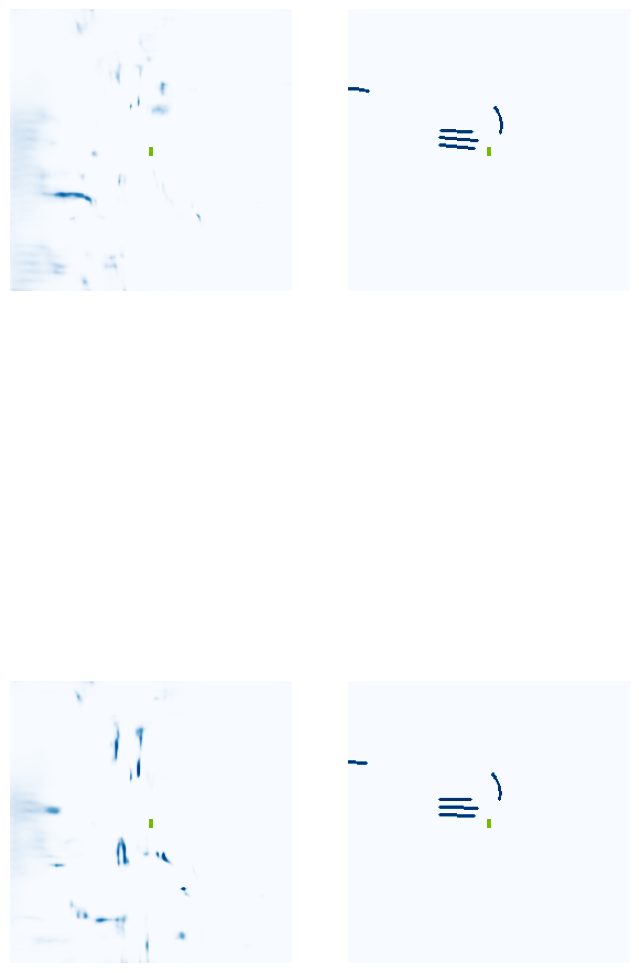

 18%|█▊        | 7/40 [00:02<00:08,  4.12it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17e9940>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3c79c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ad24d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ad24d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde59b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde59b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a877

 22%|██▎       | 9/40 [00:02<00:05,  5.44it/s]

Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd706bec0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15e2b10>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15e2b10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19fb830>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19f8a40>
Forward pass of Block class - size of t

 25%|██▌       | 10/40 [00:02<00:05,  5.93it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde8f7560>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3c79c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71b1080>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71b1080>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde337740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8f7560>
In Pillar Features - spatial_features size, whic

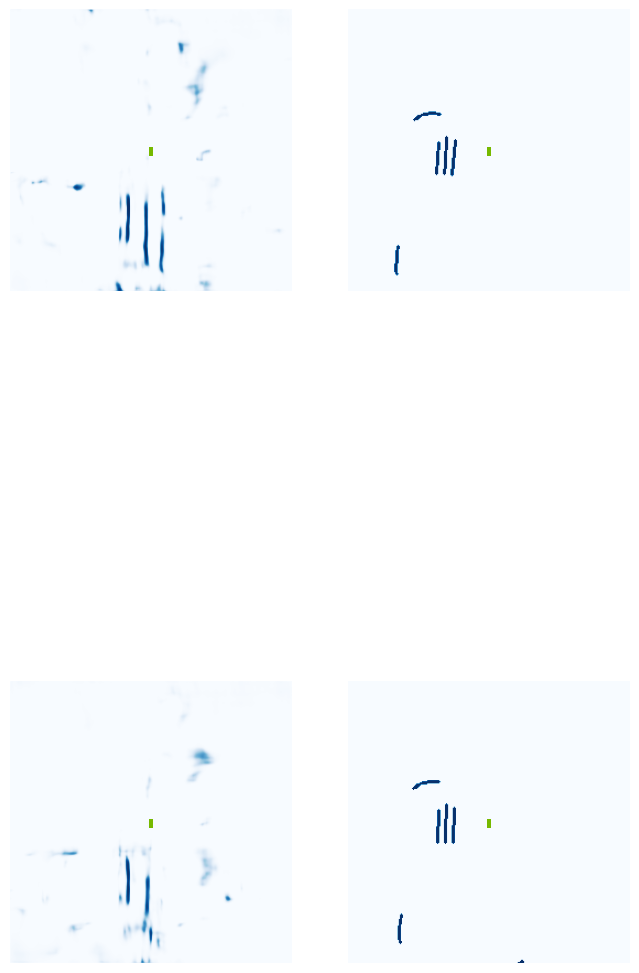

 30%|███       | 12/40 [00:03<00:06,  4.35it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe195dcb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1ae0090>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3a6160>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3a6160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae1c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae1c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7eaba81

 35%|███▌      | 14/40 [00:03<00:04,  5.60it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1ae1c60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1ae1c60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2fa840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2fa840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde522840>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde522840>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19fac00>

 38%|███▊      | 15/40 [00:03<00:04,  6.07it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a4310>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a49f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e0950>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e0950>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19a42c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19a42c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde355e40>
In Pillar Features - spatial_features size, whic

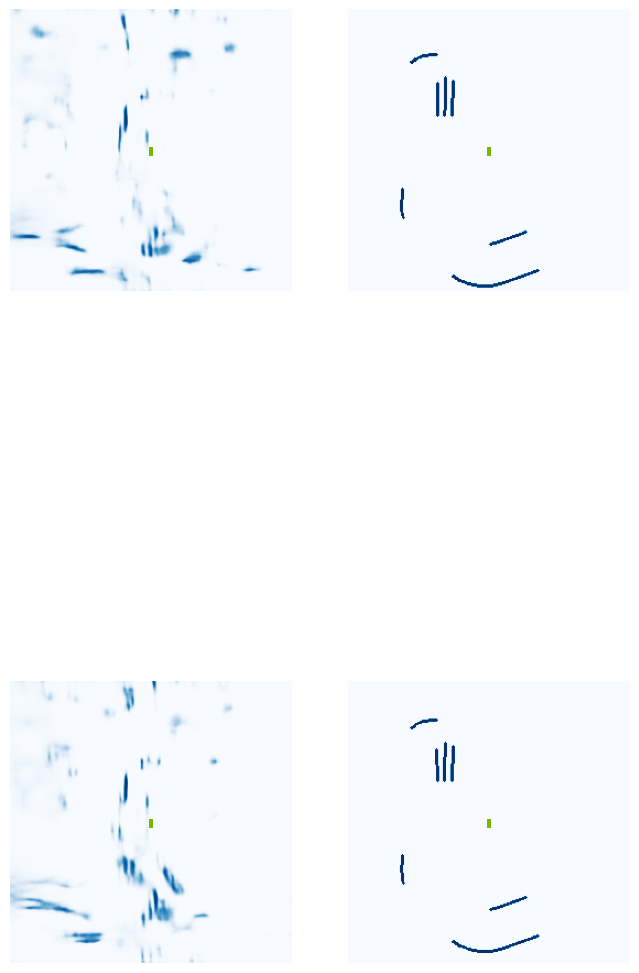

 42%|████▎     | 17/40 [00:04<00:05,  4.34it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7ea87bf1f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7ea87bcc20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9ca200>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9ca200>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9cba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9cba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7ea87bf

 48%|████▊     | 19/40 [00:04<00:03,  5.49it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7eaba60630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7eaba60630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde336160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde336160>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe155a750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe155a750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe17e9ee0>

 50%|█████     | 20/40 [00:04<00:03,  5.88it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a7b00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a6160>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17e9ee0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17e9ee0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae0360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae0360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159df30>
In Pillar Features - spatial_features size, whic

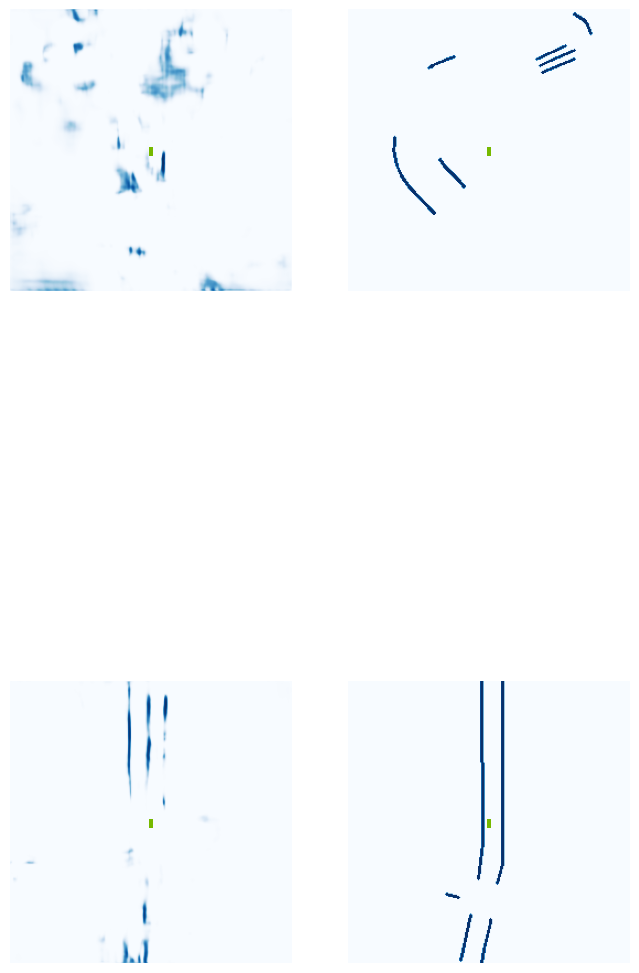

 55%|█████▌    | 22/40 [00:05<00:03,  4.53it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde623470>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1727e20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5788b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5788b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde623470>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde623470>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde436

 60%|██████    | 24/40 [00:05<00:02,  5.66it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe171c630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe171c630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde336160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde336160>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16c9030>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe16c9030>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde298770>

 62%|██████▎   | 25/40 [00:05<00:02,  6.10it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde890900>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde48f290>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde29a480>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde29a480>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde29a200>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde29a200>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5b3510>
In Pillar Features - spatial_features size, whic

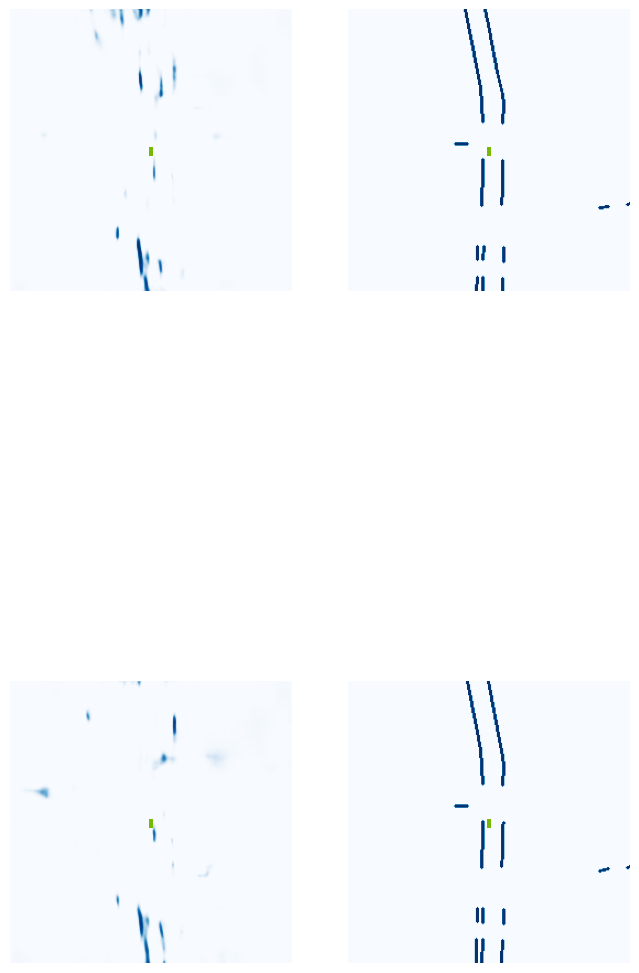

 68%|██████▊   | 27/40 [00:06<00:02,  4.45it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.06.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15a3ce0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15a0770>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5be610>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5be610>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe15a36f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe15a36f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe183a

 72%|███████▎  | 29/40 [00:06<00:01,  5.85it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19a5800>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a36f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a02c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19a5800>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a02c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a36f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a1ee0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15a3fb0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7eaba81a30> and l

 75%|███████▌  | 30/40 [00:06<00:02,  4.91it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde763420>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7603b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16d2890>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16d2890>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe18456c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe18456c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde48f290>
In Pillar Features - spatial_features size, whic

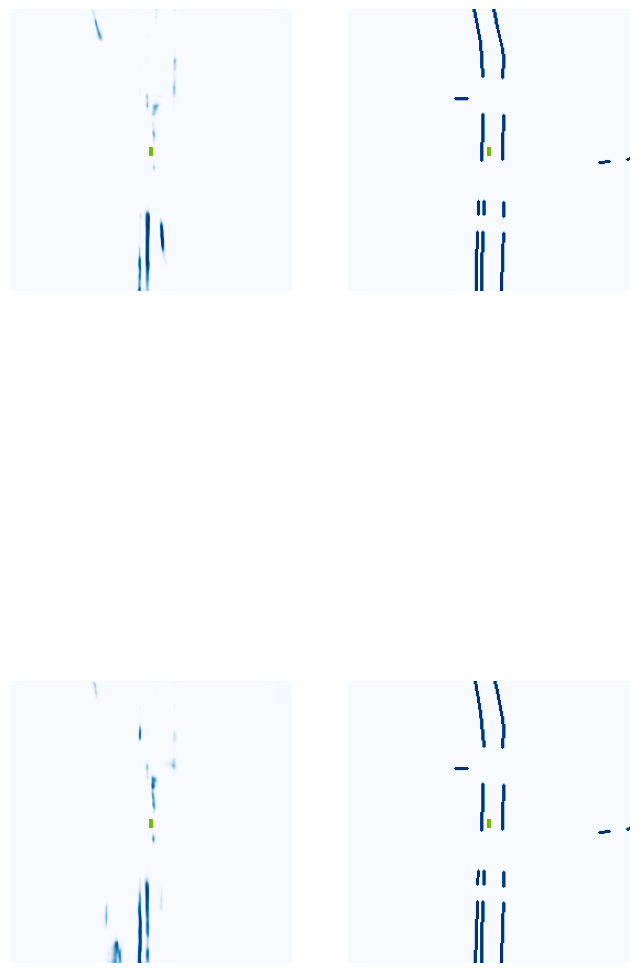

 80%|████████  | 32/40 [00:07<00:01,  4.47it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde49e520>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1727e20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b0b9c0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b0b9c0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fd711b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fd711b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b0a

 85%|████████▌ | 34/40 [00:07<00:01,  5.72it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd711b420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16daac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16dbc40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd711b420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16d90d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16daac0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1727e20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16d90d0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fd711b420> and l

 88%|████████▊ | 35/40 [00:07<00:00,  6.32it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde903f60>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd711b4c0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde49f0b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde49f0b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde49dbc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde49dbc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde623b50>
In Pillar Features - spatial_features size, whic

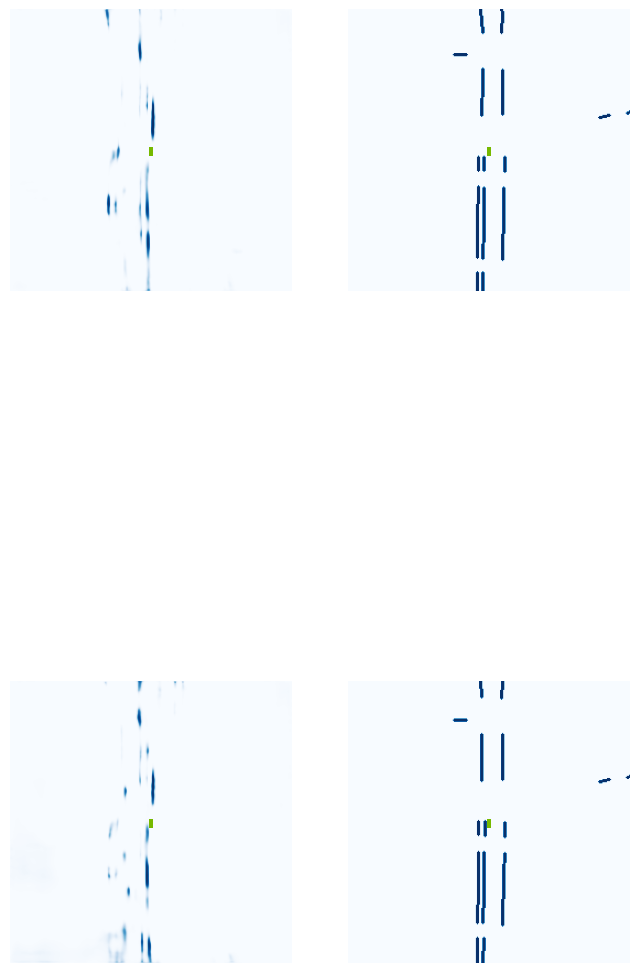

 92%|█████████▎| 37/40 [00:08<00:00,  3.37it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.05.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1604a90>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1705f30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17062a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17062a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1604cc0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1604cc0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde443

 98%|█████████▊| 39/40 [00:08<00:00,  4.91it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde442890>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1605a80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1604770>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1606f70>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1604c20>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1607c90>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1605a80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1604770>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fde442890> and l

100%|██████████| 40/40 [00:09<00:00,  4.39it/s]


Streaming output truncated to the last 5000 lines.
LPT forward(): call get voxels, and pointpillars features - passed to transfuser, then BEV encode, final size:<built-in method size of Tensor object at 0x7d7fe15a31a0>
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde78d080>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde78c220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde78c090>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde78c090>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde78c900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Te

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe18446d0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1847790>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1846750>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1846750>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1845a80>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1845a80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1846b60>
In Pillar Features - spatial_features size, whic

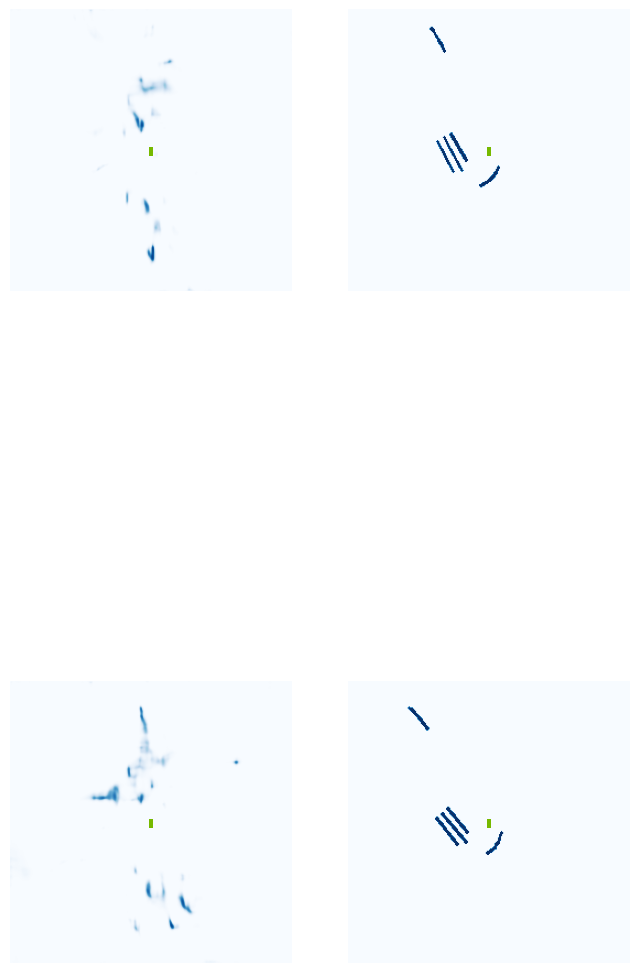

  5%|▌         | 2/40 [00:01<00:19,  1.97it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1aed670>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16e8220>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1845a80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1845a80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1608360>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1608360>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16e82

 10%|█         | 4/40 [00:01<00:09,  3.94it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1aadf80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1aadf80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1845940>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1845940>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19b4680>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19b4680>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1847330>

 12%|█▎        | 5/40 [00:01<00:07,  4.78it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1847d30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1aac900>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe0c37330>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe0c37330>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19b76f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19b76f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe0c29300>
In Pillar Features - spatial_features size, whic

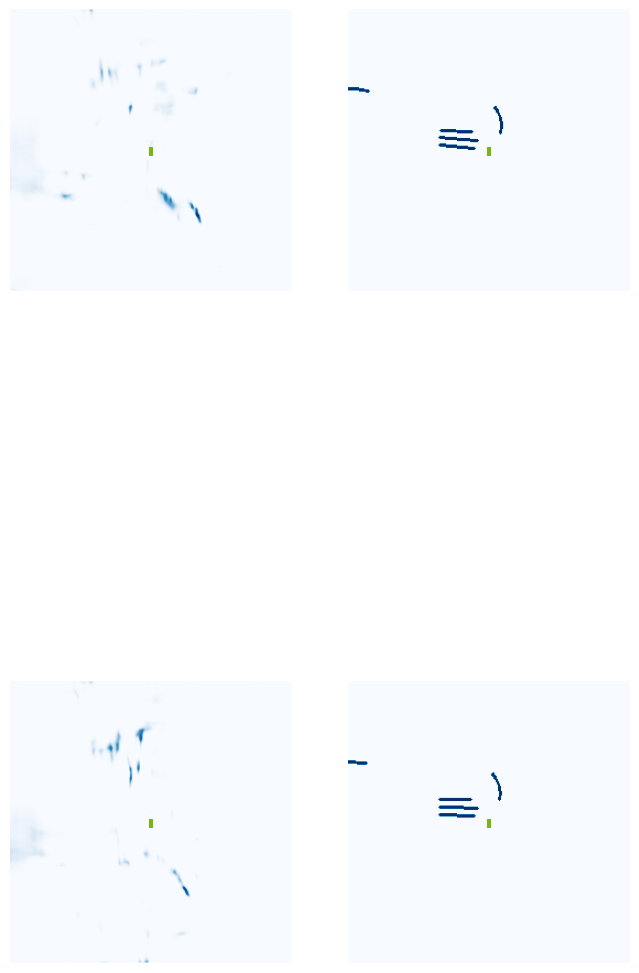

 18%|█▊        | 7/40 [00:02<00:07,  4.19it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15462f0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde458720>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe183c130>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe183c130>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1730770>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1730770>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aeea

 22%|██▎       | 9/40 [00:02<00:05,  5.65it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde441c10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7f6750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde441c10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde45bc40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7f6750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde441c10>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde7f6750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16d0ef0>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe16d0ef0> and l

 25%|██▌       | 10/40 [00:02<00:04,  6.29it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1731fd0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1731fd0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe183bce0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe183bce0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1aae9d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1aae9d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b16f70>

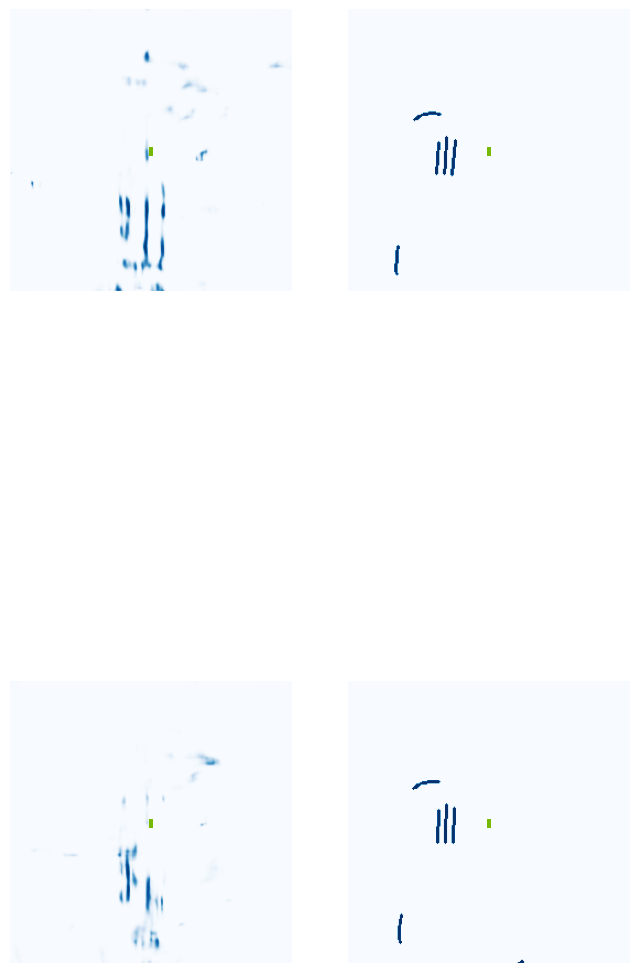

 30%|███       | 12/40 [00:03<00:05,  4.93it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde6add00>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1547920>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16d9940>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16d9940>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1b0b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1b0b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde441

 35%|███▌      | 14/40 [00:03<00:04,  6.18it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde6af0b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde6af0b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0c371f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0c371f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1547920>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1547920>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde75b380>

 38%|███▊      | 15/40 [00:03<00:03,  6.51it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1547dd0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe1547920>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe183b010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe183b010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1547dd0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1547dd0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe183bce0>
In Pillar Features - spatial_features size, whic

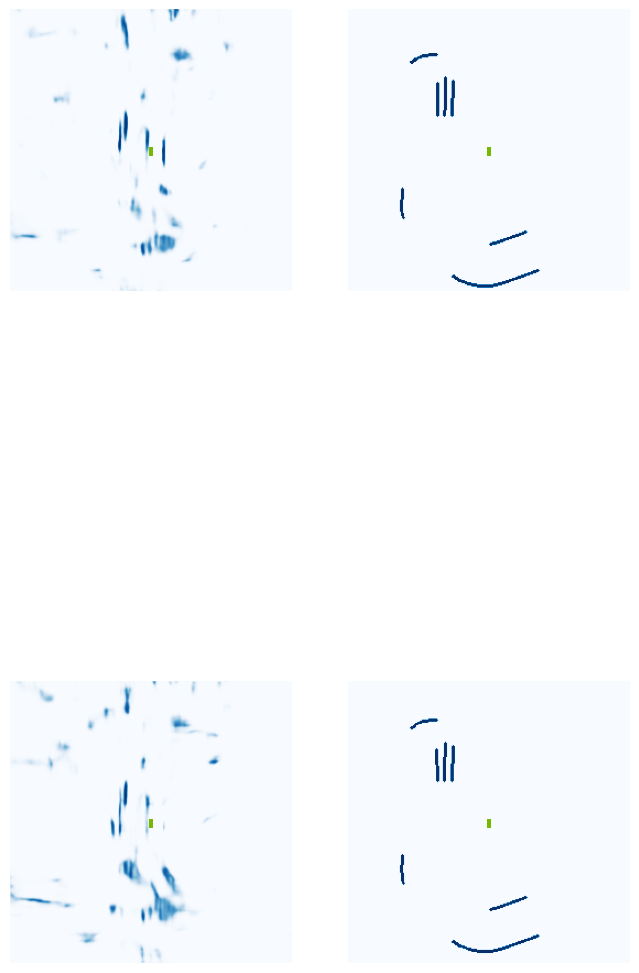

 42%|████▎     | 17/40 [00:03<00:04,  4.99it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1847150>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fd71ebb00>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16d1a30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16d1a30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5f1c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5f1c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde441

 48%|████▊     | 19/40 [00:04<00:03,  6.26it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16dbb00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c17b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16dbb00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c3510>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16dbb00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c32e0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16dbb00>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe16dbb00> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe18133d0>
Forward pass of Block class - 

 50%|█████     | 20/40 [00:04<00:02,  6.69it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1731490>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1731490>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde2a42c0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde2a42c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe171f1a0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe171f1a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15c1530>

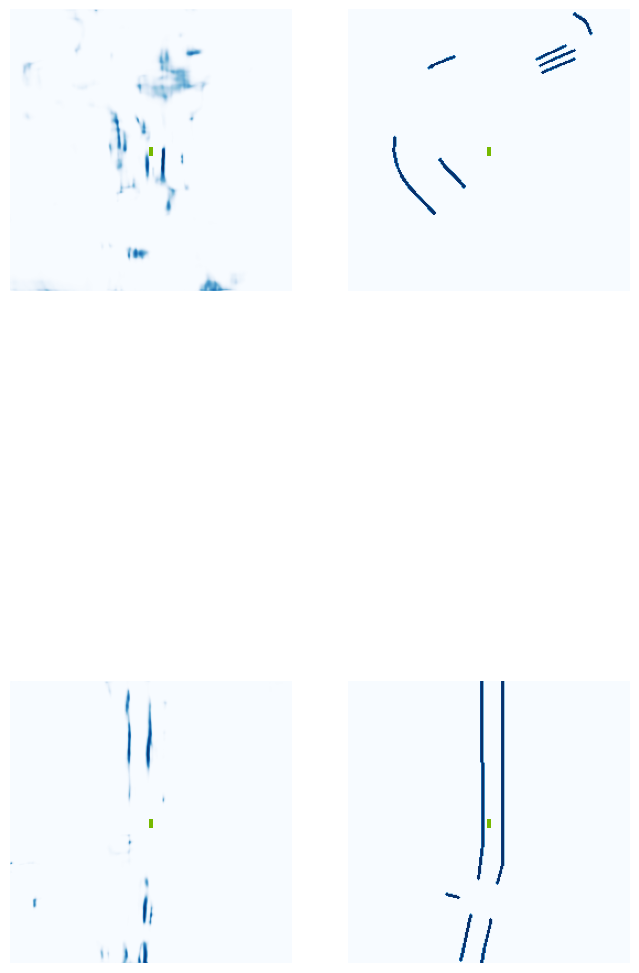

 55%|█████▌    | 22/40 [00:04<00:03,  4.95it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1547ce0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe183b010>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd71ca980>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd71ca980>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde679c60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde679c60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde70e

 60%|██████    | 24/40 [00:05<00:02,  6.09it/s]

Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159e160>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159fd30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159fd30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57a750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde57a750>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde521ee0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde522750>
Forward pass of Block class - size of t

 62%|██████▎   | 25/40 [00:05<00:02,  6.56it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe159dad0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe159d580>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16d1ee0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16d1ee0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159d580>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159d580>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde275030>
In Pillar Features - spatial_features size, whic

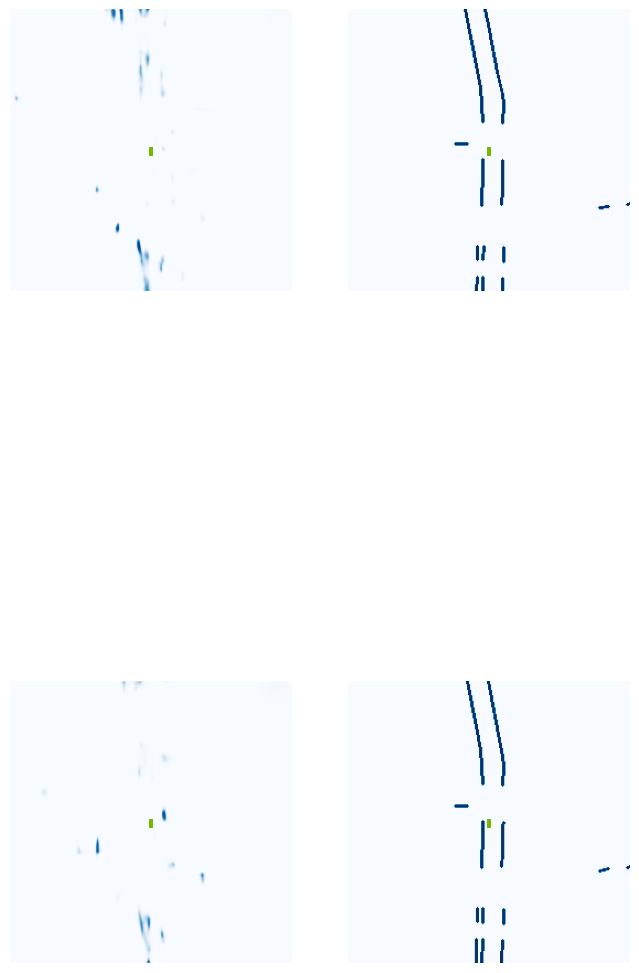

 68%|██████▊   | 27/40 [00:05<00:02,  4.87it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde939e40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde679c60>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9e4630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9e4630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe157b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe157b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde362

 72%|███████▎  | 29/40 [00:06<00:01,  6.11it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde355f80>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159bc40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159bc40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde48cb30>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde48c9f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde48ddf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde48f560>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde48e570>
Forwa

 75%|███████▌  | 30/40 [00:06<00:01,  6.64it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde3a4b80>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde598590>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde9e4630>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde9e4630>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde9e4900>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde9e4900>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159de40>
In Pillar Features - spatial_features size, whic

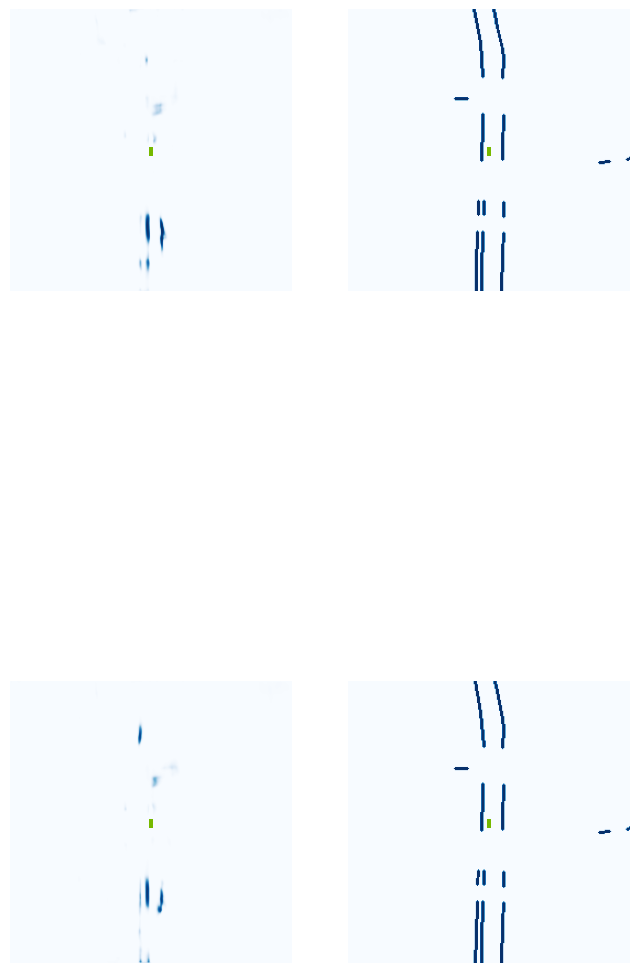

 80%|████████  | 32/40 [00:06<00:01,  4.83it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1a82840>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde9e4900>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde67a020>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde67a020>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde523

 85%|████████▌ | 34/40 [00:07<00:00,  6.08it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde523010>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde523010>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe159de40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe159de40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde4d0450>

 88%|████████▊ | 35/40 [00:07<00:00,  6.57it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde336480>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde34f1f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe15e04a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe15e04a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17bf740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe174eca0>
In Pillar Features - spatial_features size, whic

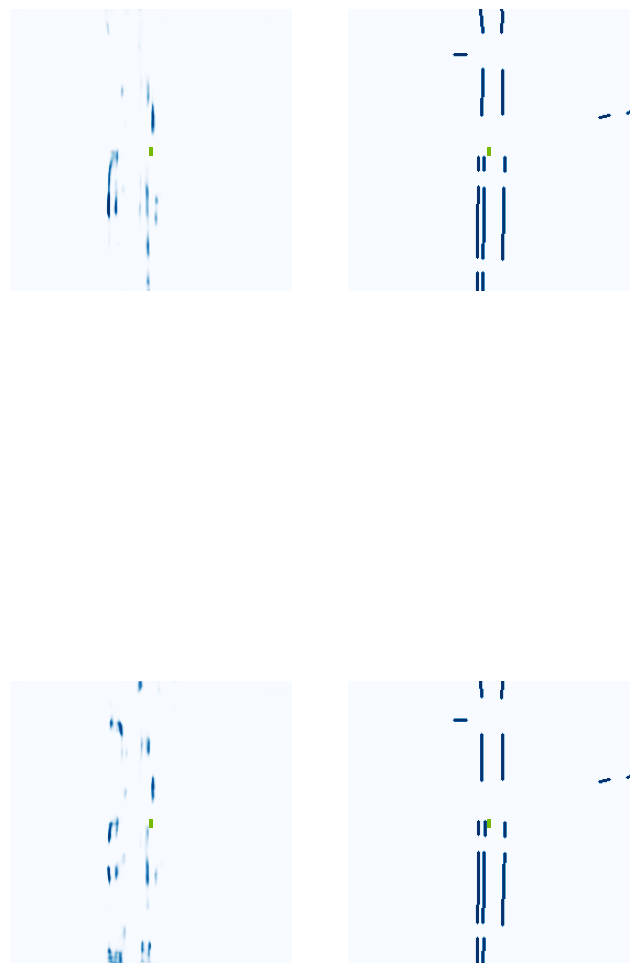

 92%|█████████▎| 37/40 [00:07<00:00,  5.02it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.02.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5b1e40>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3441d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17e8680>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17e8680>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ae76f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ae76f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde344

 98%|█████████▊| 39/40 [00:07<00:00,  6.18it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3441d0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3441d0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1727c90>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1727c90>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde9e4900>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde9e4900>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde23a200>

100%|██████████| 40/40 [00:08<00:00,  4.93it/s]


Streaming output truncated to the last 5000 lines.
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe17bf7e0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe17bf8d0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe17bd030>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe17bd030>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe17bffb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe17bffb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde460a4

  0%|          | 0/40 [00:00<?, ?it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe175c4a0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe175d350>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe175e8e0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe175e8e0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe175f740>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe175f740>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe175e020>
In Pillar Features - spatial_features size, whic

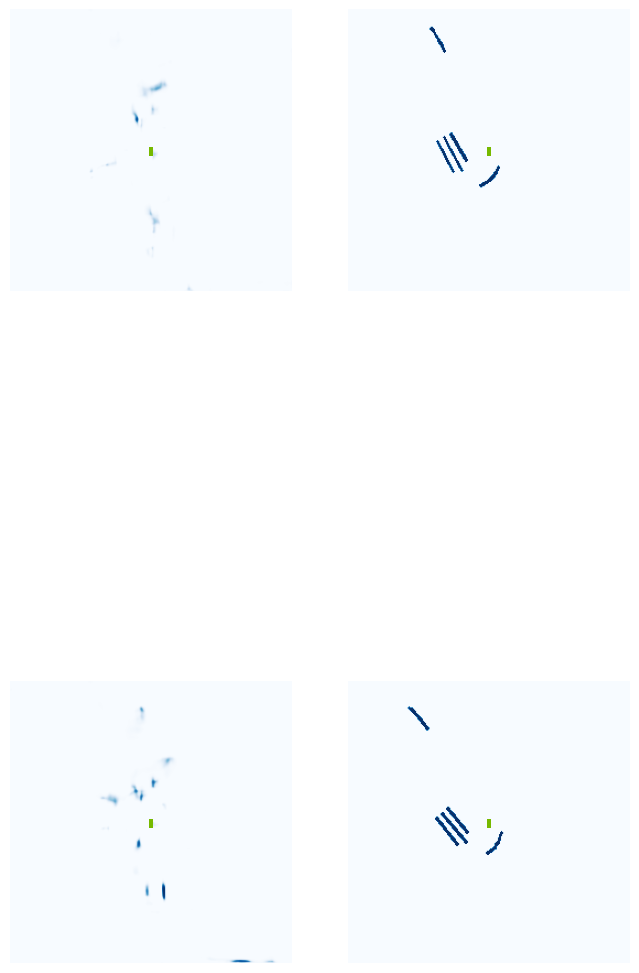

  5%|▌         | 2/40 [00:01<00:19,  1.93it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe175cbd0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe175e250>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde4d2e80>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde4d2e80>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19eb420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19eb420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15d8e

 10%|█         | 4/40 [00:01<00:09,  3.91it/s]

In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe175f6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe175f6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15b27f0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe15b27f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642700>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde6418f0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde642cf0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor objec

 12%|█▎        | 5/40 [00:01<00:07,  4.80it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde2fbce0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15d9800>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde461a30>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde461a30>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe175e250>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe175e250>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde8f62f0>
In Pillar Features - spatial_features size, whic

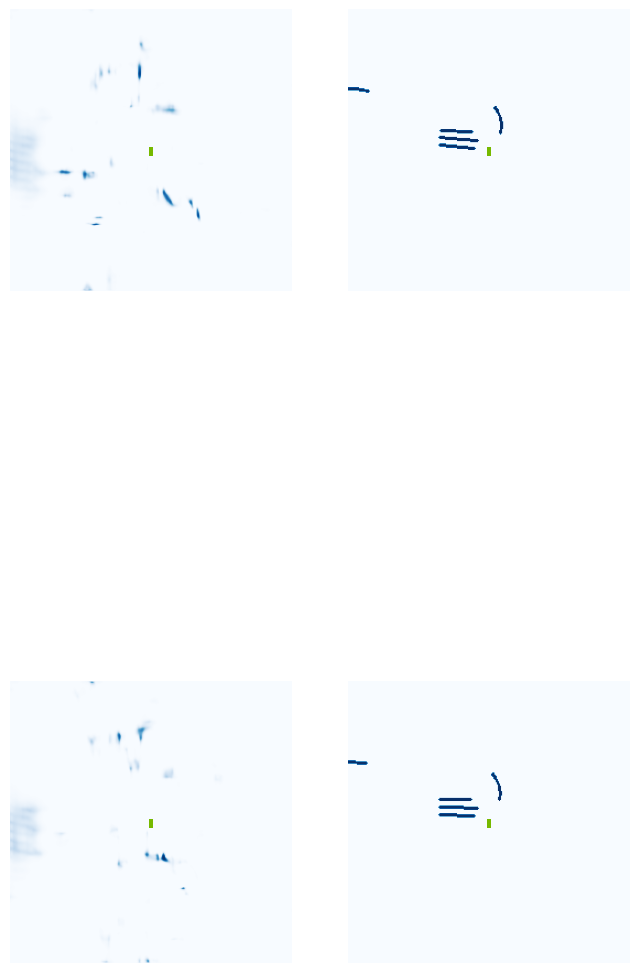

 18%|█▊        | 7/40 [00:02<00:07,  4.36it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd7068360>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe19a6a20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe19fb790>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe19fb790>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1ad3420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1ad3420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71b1c

 22%|██▎       | 9/40 [00:02<00:05,  5.74it/s]

In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde598040>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde598040>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde48de40>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde48de40>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde363dd0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde363b50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde361260>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor objec

 25%|██▌       | 10/40 [00:02<00:04,  6.16it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe0d4c900>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde7cfd80>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde2f9530>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde2f9530>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe175da30>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe175da30>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde7cdb20>
In Pillar Features - spatial_features size, whic

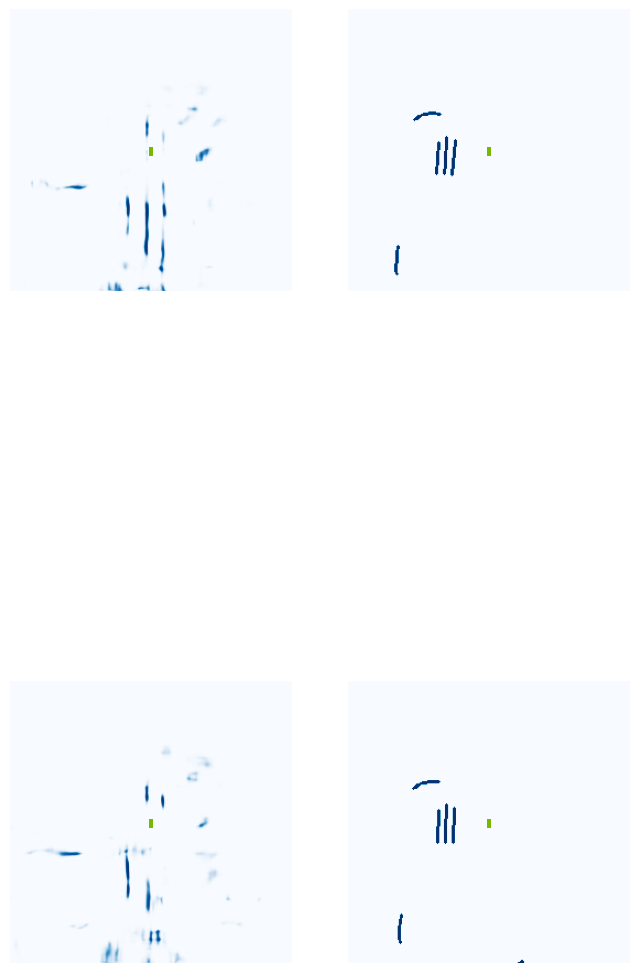

 30%|███       | 12/40 [00:03<00:05,  4.97it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe1559620>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde4d31a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde5b1e40>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde5b1e40>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe155ba60>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe155ba60>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fd71b1

 35%|███▌      | 14/40 [00:03<00:04,  6.25it/s]

In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe195e5c0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe19eb420>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe19eb420>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1559620>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ae1c60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1578630>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe155ba60>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ae0630>
Forwa

 38%|███▊      | 15/40 [00:03<00:03,  6.75it/s]

Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde6422f0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe175c900>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe175c900>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde3a5b20>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde3a5b20>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe157a750>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe157a750>
Forwar

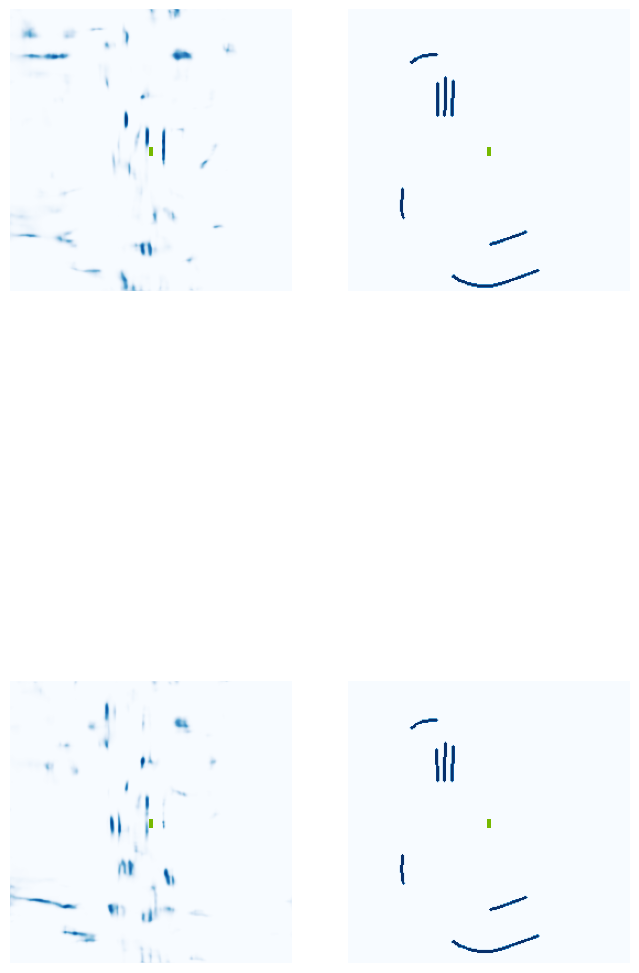

 42%|████▎     | 17/40 [00:03<00:04,  5.17it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe195ea20>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15526b0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1815120>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1815120>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe159b420>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe159b420>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde57a

 48%|████▊     | 19/40 [00:04<00:03,  6.45it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1550e50>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe19e9940>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1552160>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1b079c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15526b0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15538d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1ad3420>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1ad3420> and lidar_tensor_out of size:<built-in method size of Tensor object at 0x7d7fe1b079c0>
Forward pass of Block class - 

 50%|█████     | 20/40 [00:04<00:02,  6.97it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe159b420>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe159b420>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19a75b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19a75b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1b079c0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1b079c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fde3a53a0>

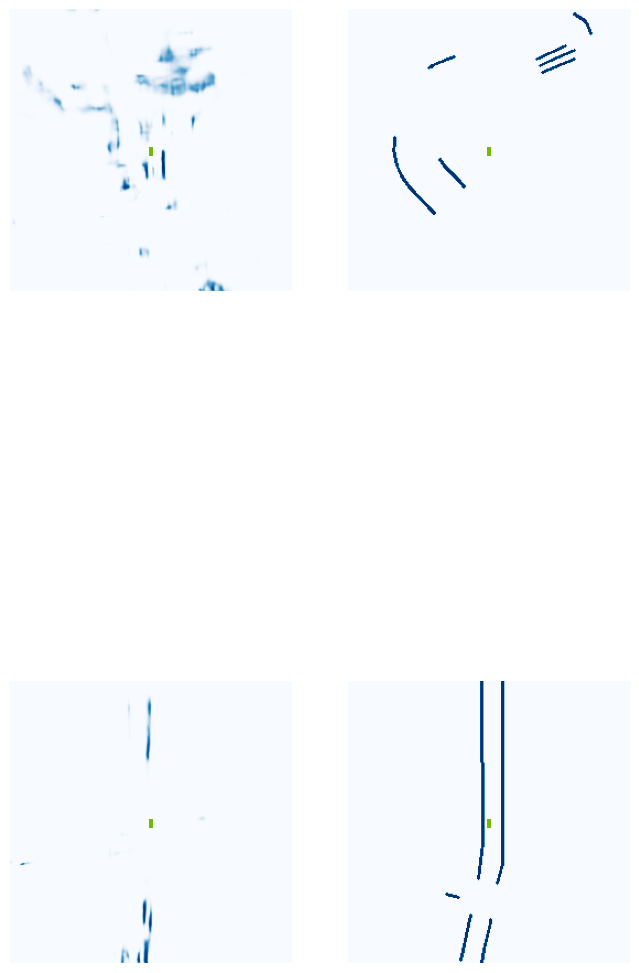

 55%|█████▌    | 22/40 [00:04<00:03,  5.17it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde758090>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde362110>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b05df0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b05df0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16da160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16da160>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde49c

 60%|██████    | 24/40 [00:05<00:02,  6.32it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde362110>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde362110>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe0d170b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe0d170b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe174c540>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe174c540>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe16da160>

 62%|██████▎   | 25/40 [00:05<00:02,  6.85it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5bcc70>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde3a5b20>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde49c270>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde49c270>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16da160>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16da160>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde5bcc70>
In Pillar Features - spatial_features size, whic

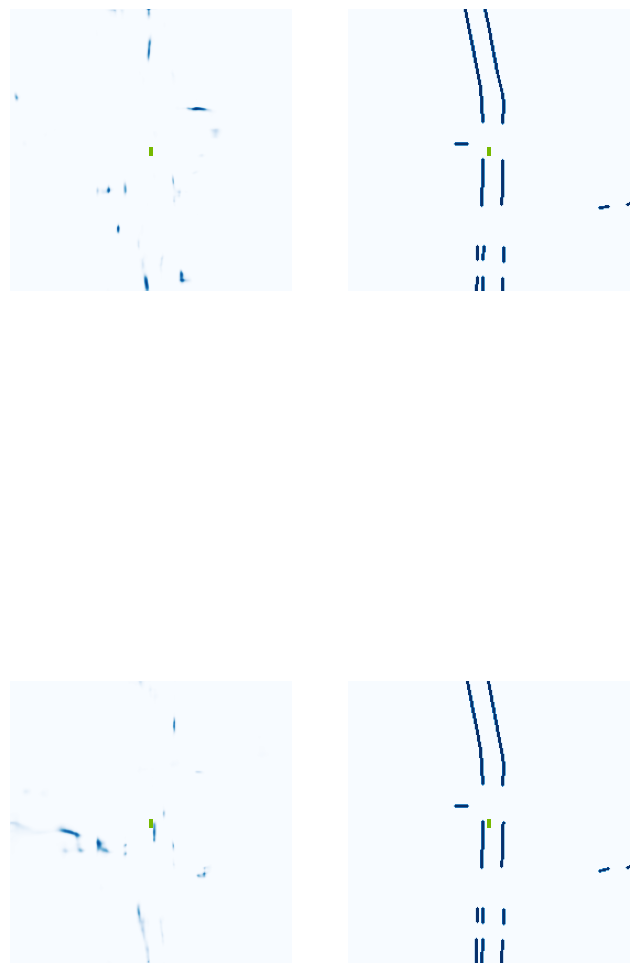

 68%|██████▊   | 27/40 [00:05<00:03,  4.15it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe15c8b30>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15caa70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde3a62f0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde3a62f0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde29a930>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde29a930>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe15c8

 72%|███████▎  | 29/40 [00:06<00:01,  5.58it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde7f7f60>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde7f7f60>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe19b5e40>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe19b5e40>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde443d80>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde443d80>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd711a700>

 75%|███████▌  | 30/40 [00:06<00:01,  6.05it/s]

Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fde5bf880>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fde5bcc70>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16dbfb0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16dbfb0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fde5bcc70>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fde5bcc70>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe16d9f80>
In Pillar Features - spatial_features size, whic

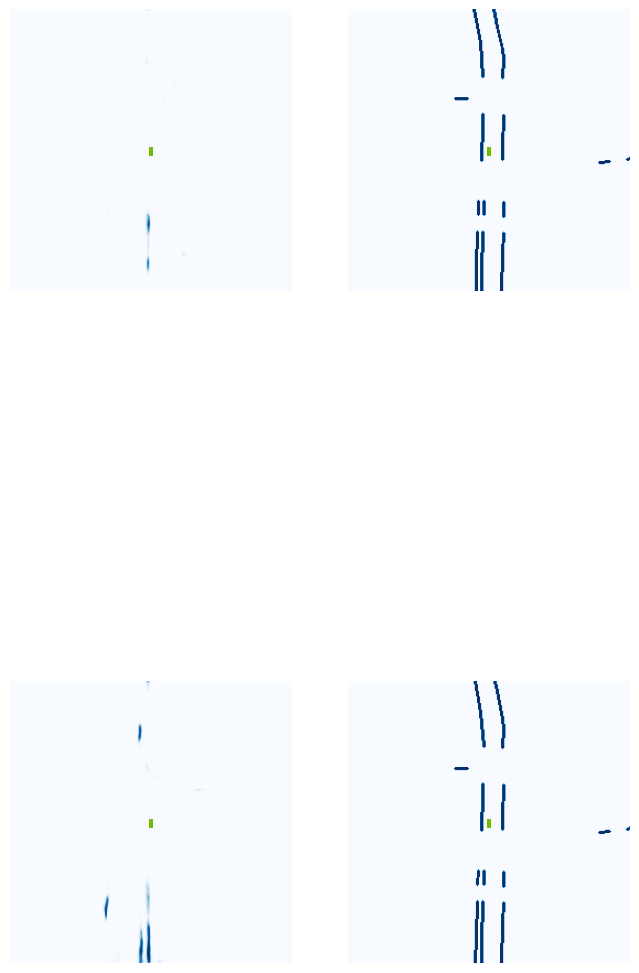

 80%|████████  | 32/40 [00:06<00:01,  4.74it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.00.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fe16dffb0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe16d8b30>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe16e8220>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe16e8220>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe16dffb0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe16dffb0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1a83

 85%|████████▌ | 34/40 [00:07<00:00,  6.08it/s]

Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15479c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1545d00>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1545670>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15471a0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15446d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15479c0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1544180>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe1545d00>
GPT.forward returns image_tensor_outsize:<built-in method size of Tensor object at 0x7d7fe1545d00> and l

 88%|████████▊ | 35/40 [00:07<00:00,  6.55it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe171d3a0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe171d3a0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1545670>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1545670>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fde238950>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fde238950>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fe15461b0>

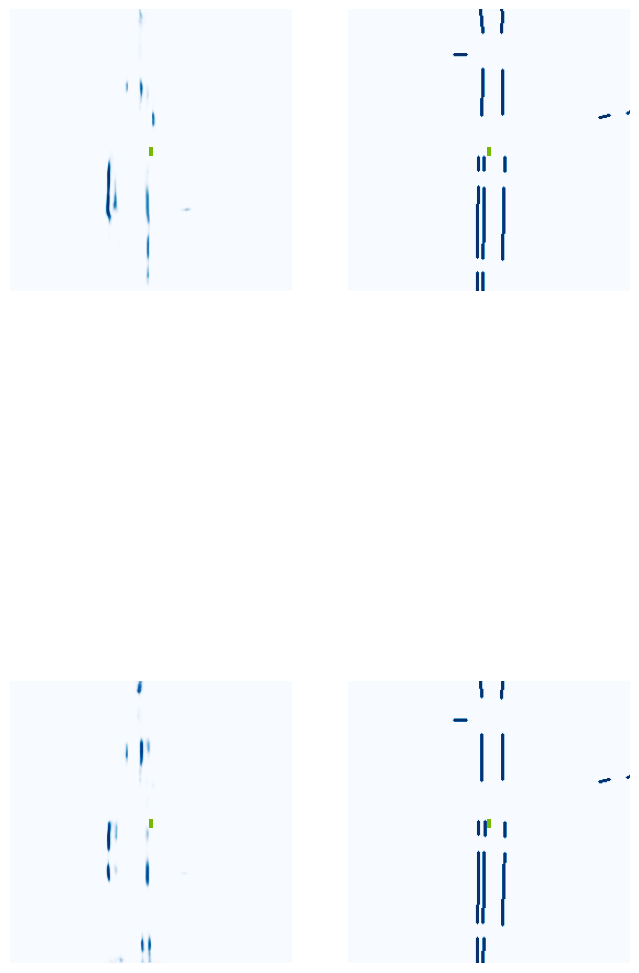

 92%|█████████▎| 37/40 [00:07<00:00,  4.50it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.03.jpg
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7fd711a6b0>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7fe15e2b10>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fde721620>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fde721620>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1546840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1546840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1727

 98%|█████████▊| 39/40 [00:08<00:00,  5.84it/s]

Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fd711a6b0>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fd711a6b0>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe1546840>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe1546840>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe17273d0>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe17273d0>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd7093dd0>

100%|██████████| 40/40 [00:08<00:00,  4.83it/s]


Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1b15030>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1b15030>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7fe183f0b0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7fe183f0b0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7fe1608360>
In Pillar Features - spatial_features size, which is the final result of all PointPillars steps:<built-in method size of Tensor object at 0x7d7fe1608360>
Forward pass of Block class - size of tensor returned:<built-in method size of Tensor object at 0x7d7fd70912b0>

In [ ]:

#Now we want to actually call this function
train(train_label=train_label,
  version = version,
  dataroot= dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid, #since only one GPU is available and we start counting from 0
  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features = input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance,

  n_head = n_head,
  block_exp = block_exp,
  n_layer = n_layer,
  vert_anchors = vert_anchors,
  horz_anchors = horz_anchors,
  seq_len = seq_len,
  embd_pdrop = embd_pdrop,
  resid_pdrop = resid_pdrop,
  attn_pdrop = attn_pdrop,
  n_views = n_views
      )

###Show loss and IOU statistics for train and val inline through Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

###Define helper functions for visualisations (as per "explore.py" in TF Grid)

In [ ]:
#All of the below is effectively taken from the explore.py file - want to run tests to make sure this works

import torch
import matplotlib as mpl
mpl.use('Agg')
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.patches as mpatches

#fixing relative imports - due to change made in __init__.py
from data import compile_data
from tools import (ego_to_cam, get_only_in_img_mask, denormalize_img,
                    SimpleLoss, get_val_info, add_ego, gen_dx_bx,
                    get_nusc_maps, plot_nusc_map, points_to_voxel_loop) #NB CHANGE FROM LSS CODE - NEED points_to_voxel_loop to be able to assign
                                                                        #voxels, coors, num_points to be able to pass this in forward pass of model
                                                                        #same as in train.py

from models_TFGrid_2T import compile_model #this is the script for the 2T version of TF Grid

#This is a visual check on input/output data - see Lift Splat Shoot GitHub home page
#We want to check that inputs/outputs are being parsed correctly
#passing viz_train = True allows us to see data augmentation
def lidar_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                show_lidar = show_lidar, #want to see lidar scans
                viz_train = viz_train, #set this to True to see data augmentation and visualise train data rather than val data
                nepochs=1, #SET THIS EXPLICITLY IN FUNCTION DEF - only want to train for a single epoch - just to visualise

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,

                bsz = bsz,
                nworkers = nworkers,
                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance,

                n_head = n_head,
                block_exp = block_exp,
                n_layer = n_layer,
                vert_anchors = vert_anchors,
                horz_anchors = horz_anchors,
                seq_len = seq_len,
                embd_pdrop = embd_pdrop,
                resid_pdrop = resid_pdrop,
                attn_pdrop = attn_pdrop,
                n_views = n_views

                ):
  #set up param dicts based on passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
    } #set grid_conf
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'] #specify names of cams
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #HERE THIS IS BASED ON LSS AND IS PASSED EXPLICITLY
                } #set up data_aug_conf - NB THE REASON FOR ONLY 5 CAMS IS THIS WAS SHOWN TO INCREASE ROBUSTNESS IN TRAINING WHEN
                  #ONE CAMERA WAS RANDONLY DROPPED

    #NB - NEED TO FIX THIS IN MY OWN EXPLORE.PY FILE - Crucial difference with LSS is we also need cfg_pp to be defined, to be passed to compile_model
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    tf_config = {
        'n_head':n_head,
        'block_exp':block_exp,
        'n_layer':n_layer,
        'vert_anchors':vert_anchors,
        'horz_anchors':horz_anchors,
        'seq_len':seq_len,
        'embd_pdrop':embd_pdrop,
        'resid_pdrop':resid_pdrop,
        'attn_pdrop':attn_pdrop,
        'n_views':n_views

      }

    #compile the data to set up data loaders
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='vizdata', cfg_pp = cfg_pp, train_label=train_label) #Note: parser can be 'vizdata' or 'segmentationdata'
                                                                 #the difference being in (see data.py) whether
                                                                 #get_lidar_data or get_point_cloud is used for the
                                                                 #lidar information - see commented data.py file for the difference
                                                                 #NB DON'T FORGET TO INCLUDE TRAIN_LABEL AND CFG_PP - THESE ARE NOT IN LSS

    loader = trainloader if viz_train else valloader #viz_train effectively selects which data loader to use

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp, tf_config = tf_config) #compile the model

    rat = H / W #set up parameters for outputting visualisations
    val = 10.1
    fig = plt.figure(figsize=(val + val/3*2*rat*3, val/3*2*rat))
    gs = mpl.gridspec.GridSpec(2, 6, width_ratios=(1, 1, 1, 2*rat, 2*rat, 2*rat))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    for epoch in range(nepochs): #want to just run the model for a small number of epochs - nepochs = 1 above
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, pts, binimgs) in enumerate(loader):

            img_pts = model.get_geometry(rots, trans, intrins, post_rots, post_trans)
            #for every batch we want to get the image points and plot them
            for si in range(imgs.shape[0]):
                plt.clf()
                final_ax = plt.subplot(gs[:, 5:6])
                for imgi, img in enumerate(imgs[si]):
                    ego_pts = ego_to_cam(pts[si], rots[si, imgi], trans[si, imgi], intrins[si, imgi])
                    mask = get_only_in_img_mask(ego_pts, H, W)
                    plot_pts = post_rots[si, imgi].matmul(ego_pts) + post_trans[si, imgi].unsqueeze(1)

                    ax = plt.subplot(gs[imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    plt.imshow(showimg)
                    if show_lidar: #also gets lidar points
                        plt.scatter(plot_pts[0, mask], plot_pts[1, mask], c=ego_pts[2, mask],
                                s=5, alpha=0.1, cmap='jet')
                    # plot_pts = post_rots[si, imgi].matmul(img_pts[si, imgi].view(-1, 3).t()) + post_trans[si, imgi].unsqueeze(1)
                    # plt.scatter(img_pts[:, :, :, 0].view(-1), img_pts[:, :, :, 1].view(-1), s=1)
                    plt.axis('off')

                    plt.sca(final_ax)
                    plt.plot(img_pts[si, imgi, :, :, :, 0].view(-1), img_pts[si, imgi, :, :, :, 1].view(-1), '.', label=cams[imgi].replace('_', ' '))

                plt.legend(loc='upper right')
                final_ax.set_aspect('equal')
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))

                ax = plt.subplot(gs[:, 3:4])
                plt.scatter(pts[si, 0], pts[si, 1], c=pts[si, 2], vmin=-5, vmax=5, s=5)
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))
                ax.set_aspect('equal')

                ax = plt.subplot(gs[:, 4:5])
                plt.imshow(binimgs[si].squeeze(0).T, origin='lower', cmap='Greys', vmin=0, vmax=1) #displays output

                imname = f'lcheck{epoch:03}_{batchi:05}_{si:02}.jpg'
                print('saving', imname)
                plt.savefig(imname) #saves output display to a file for that particular epoch and batch

#As far as I understand this is just a check to make sure that the result of autograd with and without
#the cumulative sum trick, match so that we can check that the cumsum trick is working properly
def cumsum_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance,

                n_head = n_head,
                block_exp = block_exp,
                n_layer = n_layer,
                vert_anchors = vert_anchors,
                horz_anchors = horz_anchors,
                seq_len = seq_len,
                embd_pdrop = embd_pdrop,
                resid_pdrop = resid_pdrop,
                attn_pdrop = attn_pdrop,
                n_views = n_views
                ):
    #set up dicts based on above param values
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS SET EXPLICITLY HERE BASED ON Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    tf_config = {
        'n_head':n_head,
        'block_exp':block_exp,
        'n_layer':n_layer,
        'vert_anchors':vert_anchors,
        'horz_anchors':horz_anchors,
        'seq_len':seq_len,
        'embd_pdrop':embd_pdrop,
        'resid_pdrop':resid_pdrop,
        'attn_pdrop':attn_pdrop,
        'n_views':n_views

      }
    #compile the data - with segmentation data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label=train_label) #other default arguments defined from data.py - but we need
                                                                                                                  #cfg_pp and train_label

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
    loader = trainloader #want to load training data

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp, tf_config = tf_config) #compile the model
    model.to(device)

    model.eval()
    #effectively just run for a single epoch - we only want to do a backward pass and check autograd matches
    for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader):

        model.use_quickcumsum = False #this is without using quickcumsum - see model.py for how it handles when use_quickcumsum=False
        model.zero_grad()
        #NB - NOTE - IN ORDER TO ACTUALLY RUN THE FORWARD PASS OF OUR MODEL WE NEED voxels, coors and num_points
        #and these come from points_to_voxel_loop - see train.py - there it calls this to get these assigned before then passing these to actually do a forward pass of the model
        voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)

        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('autograd:    ', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())

        model.use_quickcumsum = True #this is with using quickcumsum - see model.py for how it handles when use_quickcumsum=True
        model.zero_grad()
        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('quick cumsum:', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())
        print()
        #Ultimately from the print statements we can compare if cumsum trick is working as expected or not

#NB THIS IS WHAT WE WANT TO GET OUT THE ACTUAL IOU PERFORMANCE OF THE MODEL ON VALIDATION DATA USING A FITTED MODEL
def eval_model_iou(modelf, #NB WILL NEED TO SPECIFY A MODEL_LOCATION WHERE THE TRAINED MODEL IS SAVED - THEN USE THIS TO EVALUATE
                        #Note: See the last part of train.py - it will tell your the MODEL_LOCATION based on mname where it saves
                        #a state_dict of the model after the count%val_step == 0 - take the latest model saved and use that when passing
                        #eval_model_iou  - ultimately based on get_val_info
                        #this is the validation info only for the same class as trained on
                        #will also need to edit get_val_info for where the images resulting from plot_bev are being saved version = "mini",
                        #NB Note - non-default arguments need to precede default arguments
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points, #trainval avg 34720  , mini avg 34718

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance,

                n_head = n_head,
                block_exp = block_exp,
                n_layer = n_layer,
                vert_anchors = vert_anchors,
                horz_anchors = horz_anchors,
                seq_len = seq_len,
                embd_pdrop = embd_pdrop,
                resid_pdrop = resid_pdrop,
                attn_pdrop = attn_pdrop,
                n_views = n_views

                ):
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY HERE
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    tf_config = {
        'n_head':n_head,
        'block_exp':block_exp,
        'n_layer':n_layer,
        'vert_anchors':vert_anchors,
        'horz_anchors':horz_anchors,
        'seq_len':seq_len,
        'embd_pdrop':embd_pdrop,
        'resid_pdrop':resid_pdrop,
        'attn_pdrop':attn_pdrop,
        'n_views':n_views

      }
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label = train_label) #all other default params passed from data.py but we need cfg_pp and
                                                                                                                    #train_label - unlike LSS code

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp = cfg_pp, tf_config = tf_config) #compile model
    print('loading', modelf)
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])
    model.to(device)

    loss_fn = SimpleLoss(1.0).cuda(gpuid)

    model.eval()
    val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp = cfg_pp, grid_conf=grid_conf) #ultimate output is a dict of loss and iou across all batches
                                                               #plus images stored in a folder (to be set) with the outputs of
                                                               #plot_bev
                                                               #NB - NOTE - the way it is defined in tools.py it requires a cfg argument - really this is cfg_pp - as it gets
                                                               #passed to points_to_voxel_loop to get voxels, coors, num_points etc
    print(val_info)


def viz_model_preds(modelf, #this is to be a file path to a fitted model
                    version = version,
                    dataroot= dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found
                    img_save = img_save_dir, # Need to pass a directory I actually have access to
                    gpuid = gpuid,#start counting from 0 when using just one GPU
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes, #NEED TO PUT THIS IN HERE AS IT ISN'T COMING FROM THE CONFIG FILE
                    num_points = num_points,
                    n_points = n_points, #trainval avg 34720  , mini avg 34718

                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance,

                    n_head = n_head,
                    block_exp = block_exp,
                    n_layer = n_layer,
                    vert_anchors = vert_anchors,
                    horz_anchors = horz_anchors,
                    seq_len = seq_len,
                    embd_pdrop = embd_pdrop,
                    resid_pdrop = resid_pdrop,
                    attn_pdrop = attn_pdrop,
                    n_views = n_views

                    ):
    #set dicts for passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
    }
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
            'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT']
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY - based on Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    tf_config = {
        'n_head':n_head,
        'block_exp':block_exp,
        'n_layer':n_layer,
        'vert_anchors':vert_anchors,
        'horz_anchors':horz_anchors,
        'seq_len':seq_len,
        'embd_pdrop':embd_pdrop,
        'resid_pdrop':resid_pdrop,
        'attn_pdrop':attn_pdrop,
        'n_views':n_views

      }
    #compile data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp = cfg_pp, train_label=train_label) #need cfg_pp and train_label all rest default from data.py
    loader = trainloader if viz_train else valloader #decide whether visualising train or val data
    nusc_maps = get_nusc_maps(map_folder) #NEED TO DOUBLE CHECK WHAT THIS FUNCTION DOES AND WHAT IT RETURNS - Should generally get the maps

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1,cfg_pp = cfg_pp, tf_config = tf_config) #compile the model
    print('loading', modelf)
    print('device: ',device) ###
    #Want to generally load a fitted model
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])####,map_location=device
    model.to(device)

    dx, bx, _ = gen_dx_bx(grid_conf['xbound'], grid_conf['ybound'], grid_conf['zbound'])
    dx, bx = dx[:2].numpy(), bx[:2].numpy()

    scene2map = {}
    for rec in loader.dataset.nusc.scene:
        log = loader.dataset.nusc.get('log', rec['log_token'])
        scene2map[rec['name']] = log['location']

    #this is for setting up plotting
    val = 0.01
    fH, fW = final_dim
    fig = plt.figure(figsize=(3*fW*val, (1.5*fW + 2*fH)*val))
    gs = mpl.gridspec.GridSpec(3, 3, height_ratios=(1.5*fW, fH, fH))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    model.eval() #switch model to eval mode
    counter = 0
    with torch.no_grad():
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader): #need points also
            voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp) #need voxels, coors and num_points to run forward pass on model

            out = model(imgs.to(device),
                    rots.to(device),
                    trans.to(device),
                    intrins.to(device),
                    post_rots.to(device),
                    post_trans.to(device),
                    voxels.to(device), #need voxels, coors and num_points - different to LSS code
                    coors.to(device),
                    num_points.to(device)
                    )
            out = out.sigmoid().cpu() #### why applies sigmoid to output???


            for si in range(imgs.shape[0]):
                plt.clf()
                for imgi, img in enumerate(imgs[si]):
                    ax = plt.subplot(gs[1 + imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    # flip the bottom images
                    if imgi > 2:
                        showimg = showimg.transpose(Image.FLIP_LEFT_RIGHT)
                    plt.imshow(showimg)
                    plt.axis('off')
                    plt.annotate(cams[imgi].replace('_', ' '), (0.01, 0.92), xycoords='axes fraction')

                ax = plt.subplot(gs[0, :])
                ax.get_xaxis().set_ticks([])
                ax.get_yaxis().set_ticks([])
                plt.setp(ax.spines.values(), color='b', linewidth=2)
                plt.legend(handles=[
                    mpatches.Patch(color=(0.0, 0.0, 1.0, 1.0), label='Output Vehicle Segmentation'),
                    mpatches.Patch(color='#76b900', label='Ego Vehicle'),
                    mpatches.Patch(color=(1.00, 0.50, 0.31, 0.8), label='Map (for visualization purposes only)')
                ], loc=(0.01, 0.86))
                plt.imshow(out[si].squeeze(0), vmin=0, vmax=1, cmap='Blues')

                # plot static map (improves visualization)
                rec = loader.dataset.ixes[counter]
                plot_nusc_map(rec, nusc_maps, loader.dataset.nusc, scene2map, dx, bx)
                plt.xlim((out.shape[3], 0))
                plt.ylim((0, out.shape[3]))
                add_ego(bx, dx)

                imname = f'eval{batchi:06}_{si:03}.jpg'
                print('saving', imname)
                plt.savefig(img_save + imname) #saves all these figures named based on batch number and enumerated image number
                counter += 1


###Call eval_model_iou() to get IOU and loss

In [ ]:
eval_model_iou(modelf = os.path.join(logdir, "model9500.pt"),
                version = version,
                dataroot = dataroot,
                gpuid = gpuid, #only 1 gpu on Colab

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,

                n_points = n_points, #trainval avg 34720  , mini avg 34718
                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance,

                n_head = n_head,
                block_exp = block_exp,
                n_layer = n_layer,
                vert_anchors = vert_anchors,
                horz_anchors = horz_anchors,
                seq_len = seq_len,
                embd_pdrop = embd_pdrop,
                resid_pdrop = resid_pdrop,
                attn_pdrop = attn_pdrop,
                n_views = n_views

                )


Getting all samples
Getting all samples
Within LPT class, create_frustum function- size of frustum (one per cam - expect D.H.W.3) is:<built-in method size of Tensor object at 0x7d7fe1b14950>
Within CamEncode - as part of Lift Splat - size of D is:41
Within CamEncode - as part of Lift Splat - size of C is:64
Loaded pretrained weights for efficientnet-b0
In PointPillars Scatter - output size - which should be batch_size,C,H,W is:[1, 1, 256, 256, 64]
In init of BevEncode - number of in channels expetced for BevEncode384
loading ./runs/model9500.pt


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


running eval...
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7eb0e1d620>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7eb0e1e610>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7fe1731530>
Within get_voxels we get geom feats and get_cam_feats to pass to voxel_pooling - resulting tensor size is:<built-in method size of Tensor object at 0x7d7fe1731530>
In forward pass of PFNLayer - before max step - tensor of size C,P,N is of size:<built-in method size of Tensor object at 0x7d7eb0e1f6f0>
In forward pass of PFNLayer - after doing max over - tensor of size C,P is of size:<built-in method size of Tensor object at 0x7d7eb0e1f6f0>
In PointPillars Scatter - batch_canvas size - which should be batch_size,C,H,W is:<built-in method size of Tensor object at 0x7d7eb0e5a750>
In Pillar Features - spatial_fea

###Call viz_model_preds() to visualise output predictions

In [ ]:
#call viz_model_preds - to actually try to visualise outputs of model as a BEV map
viz_model_preds(modelf = os.path.join(logdir, "model9500.pt"), #file path to a fitted model - to get the actual model state_dict will need to access ['model_state_dict'] of this
                    version = version,
                    dataroot = dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found - NB get_nusc_maps will append maps/expansions/... to get relevant file
                    img_save = img_save_dir, #Chnaged this to a directory I have access to - save output in same place as all other run related output
                    gpuid = gpuid,
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes,
                    num_points = num_points,

                    n_points = n_points, #trainval avg 34720  , mini avg 34718
                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance,

                    n_head = n_head,
                    block_exp = block_exp,
                    n_layer = n_layer,
                    vert_anchors = vert_anchors,
                    horz_anchors = horz_anchors,
                    seq_len = seq_len,
                    embd_pdrop = embd_pdrop,
                    resid_pdrop = resid_pdrop,
                    attn_pdrop = attn_pdrop,
                    n_views = n_views
)

Getting all samples
Getting all samples
Within LPT class, create_frustum function- size of frustum (one per cam - expect D.H.W.3) is:<built-in method size of Tensor object at 0x7d7dd8312b10>
Within CamEncode - as part of Lift Splat - size of D is:41
Within CamEncode - as part of Lift Splat - size of C is:64
Loaded pretrained weights for efficientnet-b0
In PointPillars Scatter - output size - which should be batch_size,C,H,W is:[1, 1, 256, 256, 64]
In init of BevEncode - number of in channels expetced for BevEncode384
loading ./runs/model9500.pt
device:  cuda:0
Size of tensor returned by forward pass of cam_encode:<built-in method size of Tensor object at 0x7d7d15284090>
Resulting tensor from get_cam_feats if of size:<built-in method size of Tensor object at 0x7d7d152867a0>
Result of voxel_pooling should be a tensor of size batch_sizexCxHxW (or XxY?) - final.size is:<built-in method size of Tensor object at 0x7d7d15287920>
Within get_voxels we get geom feats and get_cam_feats to pass to

###Make a gif out of images produced by viz_model_preds()

In [ ]:
import glob
from PIL import Image
def make_gif(frame_folder, train_label):
    frames = [Image.open(image) for image in glob.glob(f"{frame_folder}/*.jpg")]
    frame_one = frames[0]
    frame_one.save(f"model_preds_visualisation_{train_label}_TF_Grid_2T.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)

#Call function
make_gif(frame_folder = img_save_dir, train_label = train_label)